# Image features exercise
*Complete and hand in this completed worksheet (including its outputs and any supporting code outside of the worksheet) with your assignment submission. For more details see the [assignments page](http://vision.stanford.edu/teaching/cs231n/assignments.html) on the course website.*

We have seen that we can achieve reasonable performance on an image classification task by training a linear classifier on the pixels of the input image. In this exercise we will show that we can improve our classification performance by training linear classifiers not on raw pixels but on features that are computed from the raw pixels.

All of your work for this exercise will be done in this notebook.

In [22]:
from __future__ import print_function

import random
import numpy as np
from cs231n.data_utils import load_CIFAR10
import matplotlib.pyplot as plt

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

# for auto-reloading extenrnal modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Load data
Similar to previous exercises, we will load CIFAR-10 data from disk.

In [2]:
from cs231n.features import color_histogram_hsv, hog_feature

def get_CIFAR10_data(num_training=49000, num_validation=1000, num_test=1000):
    # Load the raw CIFAR-10 data
    cifar10_dir = 'cs231n/datasets/cifar-10-batches-py'

    X_train, y_train, X_test, y_test = load_CIFAR10(cifar10_dir)
    
    # Subsample the data
    mask = list(range(num_training, num_training + num_validation))
    X_val = X_train[mask]
    y_val = y_train[mask]
    mask = list(range(num_training))
    X_train = X_train[mask]
    y_train = y_train[mask]
    mask = list(range(num_test))
    X_test = X_test[mask]
    y_test = y_test[mask]
    
    return X_train, y_train, X_val, y_val, X_test, y_test

# Cleaning up variables to prevent loading data multiple times (which may cause memory issue)
try:
   del X_train, y_train
   del X_test, y_test
   print('Clear previously loaded data.')
except:
   pass

X_train, y_train, X_val, y_val, X_test, y_test = get_CIFAR10_data()

## Extract Features
For each image we will compute a **Histogram of Oriented
Gradients (HOG)** as well as a color histogram using the hue channel in HSV
color space. We form our final feature vector for each image by concatenating
the HOG and color histogram feature vectors.

Roughly speaking, HOG should capture the texture of the image while ignoring
color information, and the color histogram represents the color of the input
image while ignoring texture. As a result, we expect that using both together
ought to work better than using either alone. Verifying this assumption would
be a good thing to try for your interests.

The `hog_feature` and `color_histogram_hsv` functions both operate on a single
image and return a feature vector for that image. The extract_features
function takes a set of images and a list of feature functions and evaluates
each feature function on each image, storing the results in a matrix where
each column is the concatenation of all feature vectors for a single image.

In [3]:
from cs231n.features import *

num_color_bins = 10 # Number of bins in the color histogram
feature_fns = [hog_feature, lambda img: color_histogram_hsv(img, nbin=num_color_bins)]
X_train_feats = extract_features(X_train, feature_fns, verbose=True)
X_val_feats = extract_features(X_val, feature_fns)
X_test_feats = extract_features(X_test, feature_fns)

# Preprocessing: Subtract the mean feature
mean_feat = np.mean(X_train_feats, axis=0, keepdims=True)
X_train_feats -= mean_feat
X_val_feats -= mean_feat
X_test_feats -= mean_feat

# Preprocessing: Divide by standard deviation. This ensures that each feature
# has roughly the same scale.
std_feat = np.std(X_train_feats, axis=0, keepdims=True)
X_train_feats /= std_feat
X_val_feats /= std_feat
X_test_feats /= std_feat

# Preprocessing: Add a bias dimension
X_train_feats = np.hstack([X_train_feats, np.ones((X_train_feats.shape[0], 1))])
X_val_feats = np.hstack([X_val_feats, np.ones((X_val_feats.shape[0], 1))])
X_test_feats = np.hstack([X_test_feats, np.ones((X_test_feats.shape[0], 1))])

Done extracting features for 1000 / 49000 images
Done extracting features for 2000 / 49000 images
Done extracting features for 3000 / 49000 images
Done extracting features for 4000 / 49000 images
Done extracting features for 5000 / 49000 images
Done extracting features for 6000 / 49000 images
Done extracting features for 7000 / 49000 images
Done extracting features for 8000 / 49000 images
Done extracting features for 9000 / 49000 images
Done extracting features for 10000 / 49000 images
Done extracting features for 11000 / 49000 images
Done extracting features for 12000 / 49000 images
Done extracting features for 13000 / 49000 images
Done extracting features for 14000 / 49000 images
Done extracting features for 15000 / 49000 images
Done extracting features for 16000 / 49000 images
Done extracting features for 17000 / 49000 images
Done extracting features for 18000 / 49000 images
Done extracting features for 19000 / 49000 images
Done extracting features for 20000 / 49000 images
Done extr

In [4]:
print('Size of X_train_feats: ', X_train_feats.shape)
print('Size of X_val_feats: ', X_val_feats.shape)
print('Size of X_test_feats: ', X_test_feats.shape)

Size of X_train_feats:  (49000, 155)
Size of X_val_feats:  (1000, 155)
Size of X_test_feats:  (1000, 155)


## Train SVM on features
Using the multiclass SVM code developed earlier in the assignment, train SVMs on top of the features extracted above; this should achieve better results than training SVMs directly on top of raw pixels.

In [11]:
# Use the validation set to tune the learning rate and regularization strength

from cs231n.classifiers.linear_classifier import LinearSVM
import time

learning_rates = [1e-8, 5e-8, 1e-7, 5e-7, 1e-6, 5e-6, 1e-5, 5e-5, 1e-4, 5e-4]
regularization_strengths = [1e3, 5e3, 1e4, 5e4, 6e4, 7e4, 8e4]

results = {}
best_val = -1
best_svm = None

################################################################################
# TODO:                                                                        #
# Use the validation set to set the learning rate and regularization strength. #
# This should be identical to the validation that you did for the SVM; save    #
# the best trained classifer in best_svm. You might also want to play          #
# with different numbers of bins in the color histogram. If you are careful    #
# you should be able to get accuracy of near 0.44 on the validation set.       #
################################################################################
for i in range(len(learning_rates)):
    for j in range(len(regularization_strengths)):
        svm = LinearSVM()
        
        tic = time.time()
        loss_hist = svm.train(X_train_feats, y_train, learning_rate=learning_rates[i], 
                              reg=regularization_strengths[j], num_iters=2000)
        toc = time.time()
        train_accu = np.mean(svm.predict(X_train_feats) == y_train)
        
        val_accu = np.mean(svm.predict(X_val_feats) == y_val)
        results[(learning_rates[i], regularization_strengths[j])] = (train_accu, 
                                                                     val_accu)
        
        if best_val < val_accu:
            best_val = val_accu
            best_svm = svm
        
        """
        print('Training process took %fs.' % (toc - tic))
        print('lr %e reg %e' % (learning_rates[i], regularization_strengths[j]))
        print()
        
        plt.plot(loss_hist)
        plt.title('Loss History')
        plt.xlabel('Iteration')
        plt.ylabel('Loss')
        plt.show()
        
        print()
        print()
        """
################################################################################
#                              END OF YOUR CODE                                #
################################################################################

# Print out results.
for lr, reg in sorted(results):
    train_accuracy, val_accuracy = results[(lr, reg)]
    print('lr %e reg %e train accuracy: %f val accuracy: %f' % (
                lr, reg, train_accuracy, val_accuracy))
    
print('best validation accuracy achieved during cross-validation: %f' % best_val)

lr 1.000000e-08 reg 1.000000e+03 train accuracy: 0.093367 val accuracy: 0.101000
lr 1.000000e-08 reg 5.000000e+03 train accuracy: 0.085184 val accuracy: 0.094000
lr 1.000000e-08 reg 1.000000e+04 train accuracy: 0.113388 val accuracy: 0.101000
lr 1.000000e-08 reg 5.000000e+04 train accuracy: 0.076592 val accuracy: 0.065000
lr 1.000000e-08 reg 6.000000e+04 train accuracy: 0.135551 val accuracy: 0.133000
lr 1.000000e-08 reg 7.000000e+04 train accuracy: 0.087041 val accuracy: 0.089000
lr 1.000000e-08 reg 8.000000e+04 train accuracy: 0.089102 val accuracy: 0.081000
lr 5.000000e-08 reg 1.000000e+03 train accuracy: 0.109918 val accuracy: 0.119000
lr 5.000000e-08 reg 5.000000e+03 train accuracy: 0.116510 val accuracy: 0.122000
lr 5.000000e-08 reg 1.000000e+04 train accuracy: 0.144102 val accuracy: 0.137000
lr 5.000000e-08 reg 5.000000e+04 train accuracy: 0.416224 val accuracy: 0.416000
lr 5.000000e-08 reg 6.000000e+04 train accuracy: 0.417429 val accuracy: 0.416000
lr 5.000000e-08 reg 7.000000

In [12]:
# Evaluate your trained SVM on the test set
y_test_pred = best_svm.predict(X_test_feats)
test_accuracy = np.mean(y_test == y_test_pred)
print(test_accuracy)

0.429


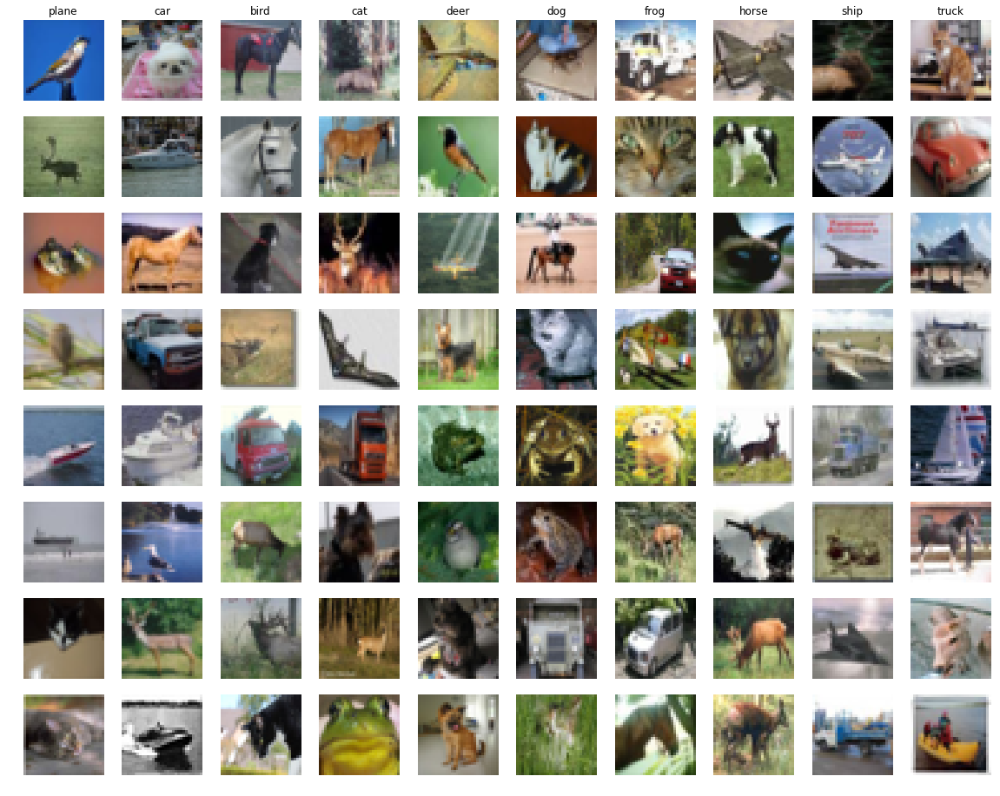

In [13]:
# An important way to gain intuition about how an algorithm works is to
# visualize the mistakes that it makes. In this visualization, we show examples
# of images that are misclassified by our current system. The first column
# shows images that our system labeled as "plane" but whose true label is
# something other than "plane".

examples_per_class = 8
classes = ['plane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
for cls, cls_name in enumerate(classes):
    idxs = np.where((y_test != cls) & (y_test_pred == cls))[0]
    idxs = np.random.choice(idxs, examples_per_class, replace=False)
    for i, idx in enumerate(idxs):
        plt.subplot(examples_per_class, len(classes), i * len(classes) + cls + 1)
        plt.imshow(X_test[idx].astype('uint8'))
        plt.axis('off')
        if i == 0:
            plt.title(cls_name)
plt.show()

### Inline question 1:
Describe the misclassification results that you see. Do they make sense?

Most of the misclassification make sense. For example, for the *plane* class, a misclassification of an image of *bird* into it is obviously because the background color of general *plane* images is blue, which is the background color in the *bird* image. Similar conditions happen in other misclassifications. 

Another common situation is the similarity between two classes. For instance, the correct classification of the third image in class *dog* in above picture is ambiguous - in fact, it is hard to correctly classify this image even for human eyes. It is totally understandable for the classifier to misclassify this kind of images.

## Neural Network on image features
Earlier in this assigment we saw that training a two-layer neural network on raw pixels achieved better classification performance than linear classifiers on raw pixels. In this notebook we have seen that linear classifiers on image features outperform linear classifiers on raw pixels. 

For completeness, we should also try training a neural network on image features. This approach should outperform all previous approaches: you should easily be able to achieve over 55% classification accuracy on the test set; our best model achieves about 60% classification accuracy.

In [14]:
# Preprocessing: Remove the bias dimension
# Make sure to run this cell only ONCE
print(X_train_feats.shape)
X_train_feats = X_train_feats[:, :-1]
X_val_feats = X_val_feats[:, :-1]
X_test_feats = X_test_feats[:, :-1]

print(X_train_feats.shape)

(49000, 155)
(49000, 154)


Training process took 4.859994s.
hs 500 lr 1.000000e-01 reg 1.000000e-05


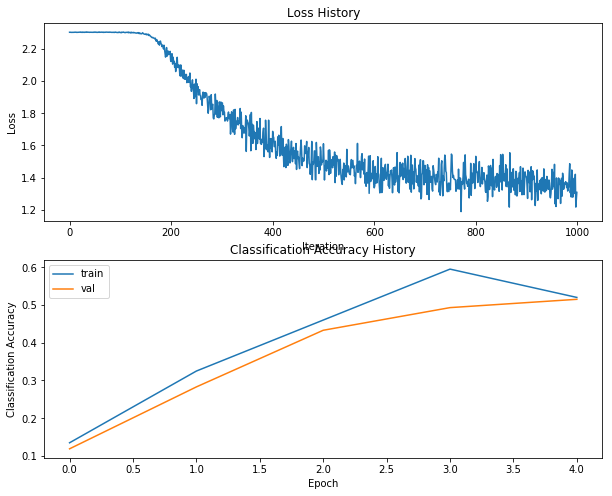



Training process took 4.460257s.
hs 500 lr 1.000000e-01 reg 1.000000e-04


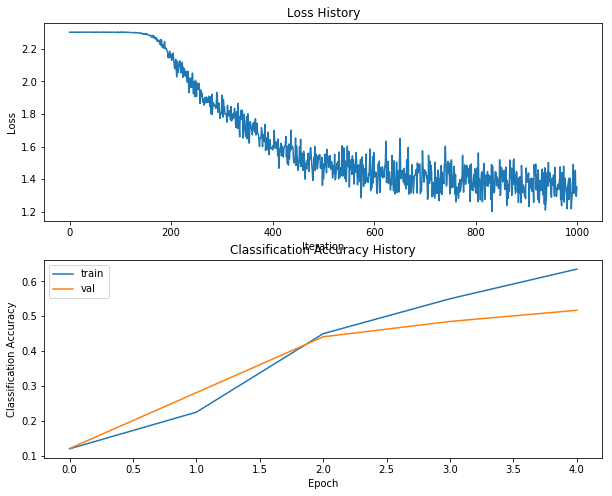



Training process took 4.537333s.
hs 500 lr 1.000000e-01 reg 5.000000e-04


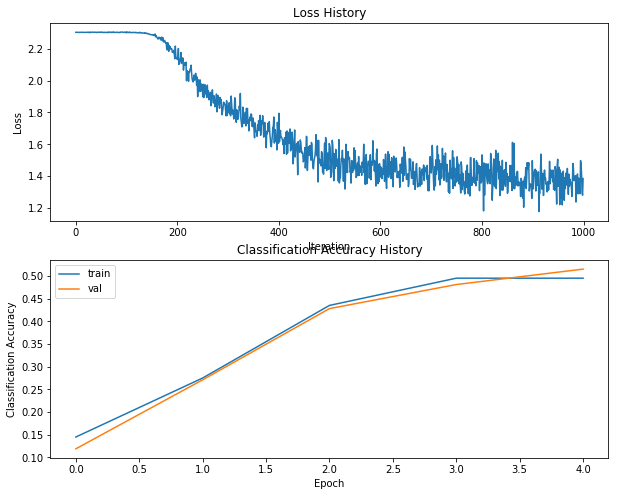



Training process took 5.216531s.
hs 500 lr 1.000000e-01 reg 1.000000e-03


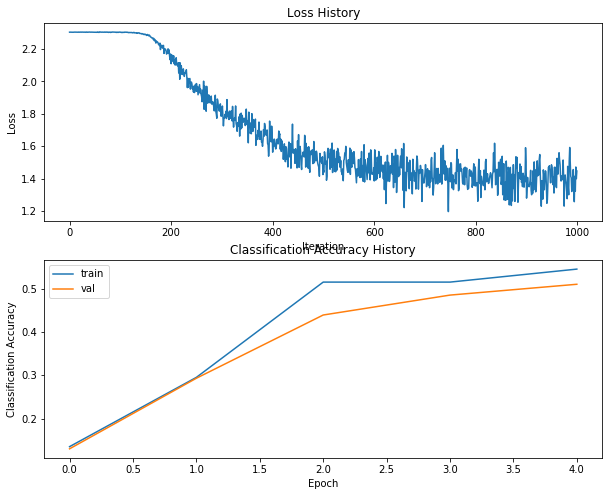



Training process took 5.380853s.
hs 500 lr 1.000000e-01 reg 5.000000e-03


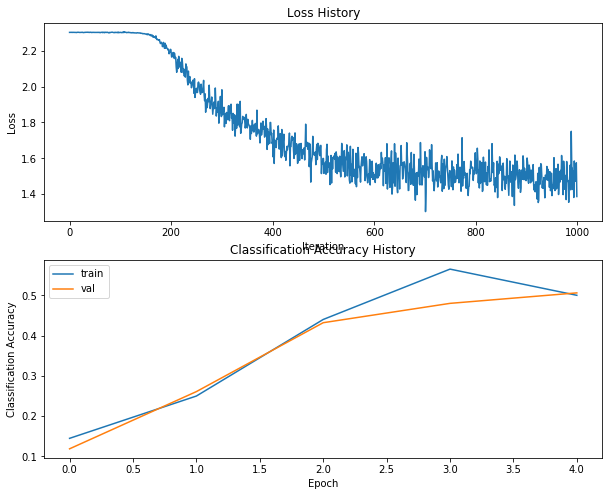



Training process took 4.333604s.
hs 500 lr 1.000000e-01 reg 1.000000e-02


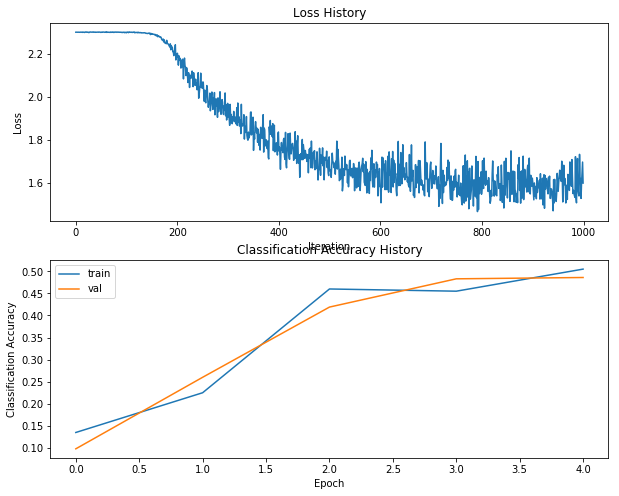



Training process took 4.030321s.
hs 500 lr 1.000000e-01 reg 1.000000e-01


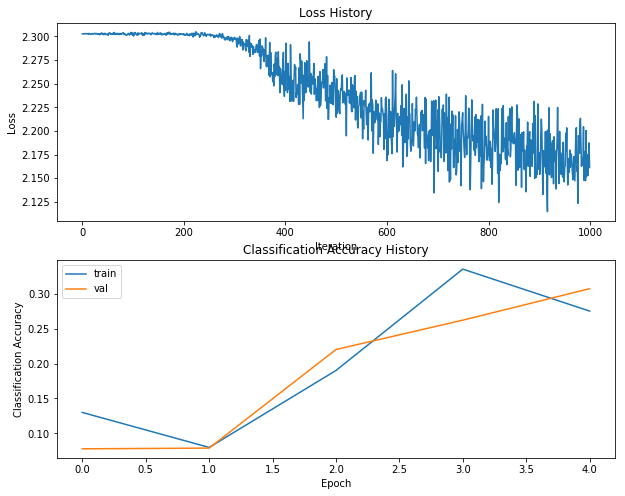



Training process took 3.885914s.
hs 500 lr 1.000000e-01 reg 1.000000e+00


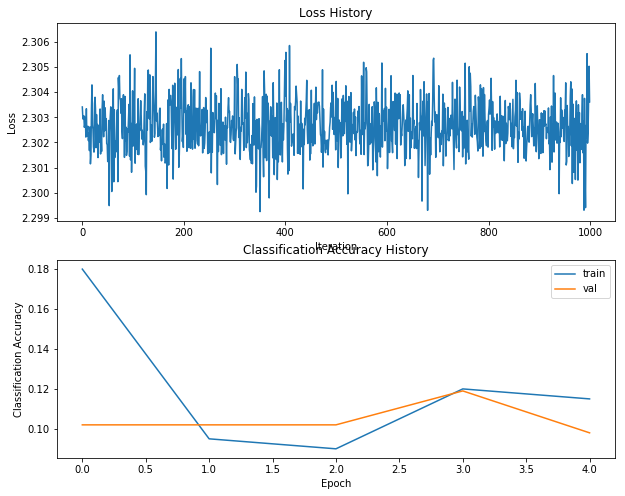



Training process took 4.110816s.
hs 500 lr 1.000000e+00 reg 1.000000e-05


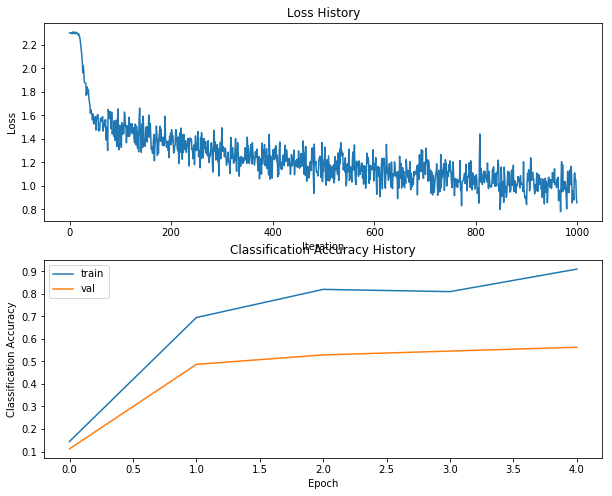



Training process took 4.141130s.
hs 500 lr 1.000000e+00 reg 1.000000e-04


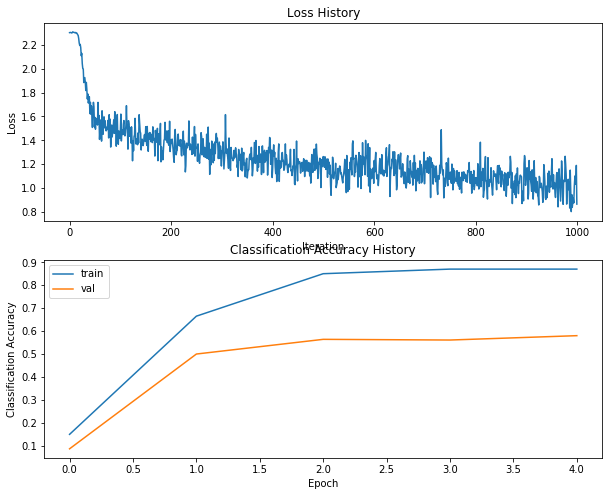



Training process took 4.125378s.
hs 500 lr 1.000000e+00 reg 5.000000e-04


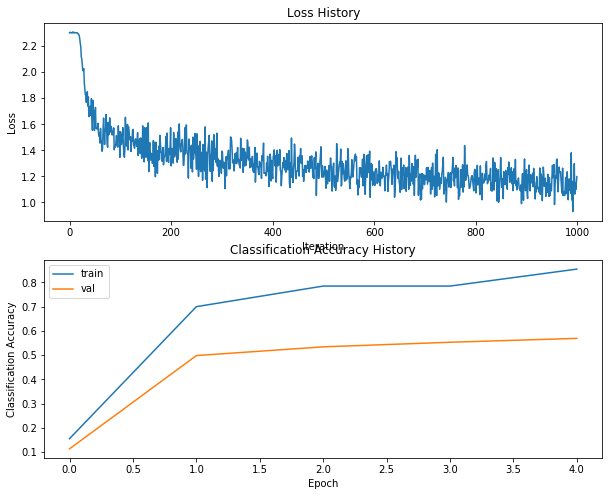



Training process took 4.196198s.
hs 500 lr 1.000000e+00 reg 1.000000e-03


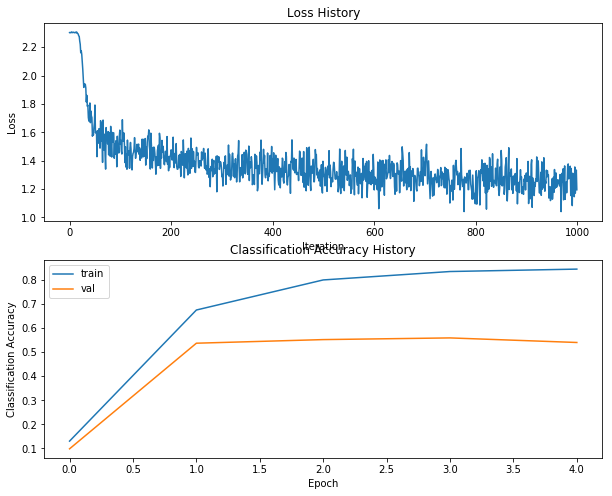



Training process took 4.217599s.
hs 500 lr 1.000000e+00 reg 5.000000e-03


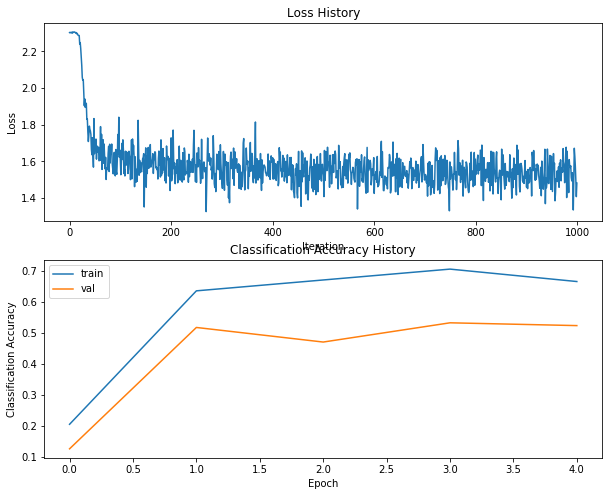



Training process took 4.199155s.
hs 500 lr 1.000000e+00 reg 1.000000e-02


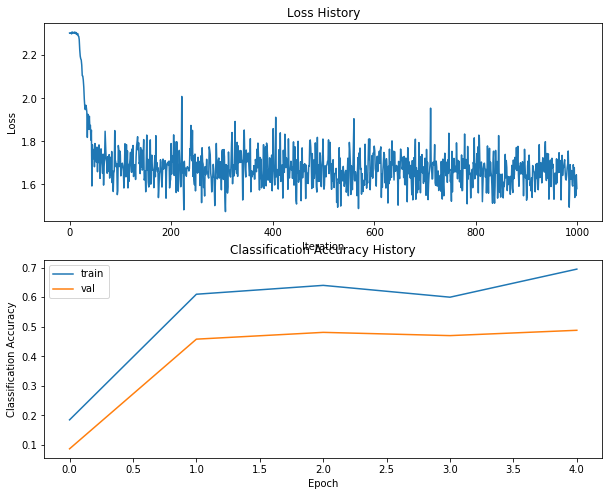



Training process took 3.932336s.
hs 500 lr 1.000000e+00 reg 1.000000e-01


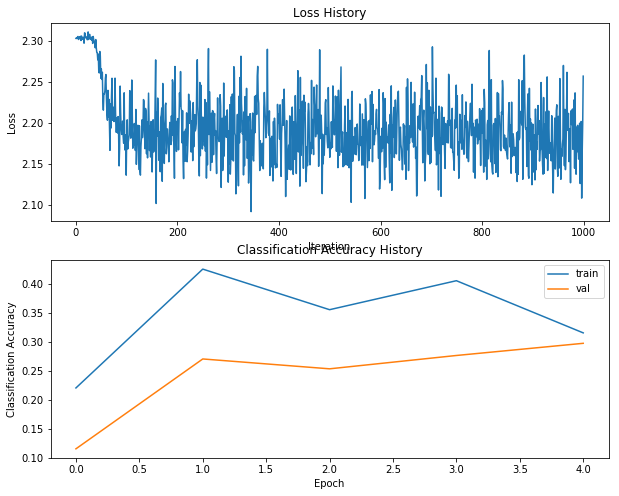



Training process took 4.347660s.
hs 500 lr 1.000000e+00 reg 1.000000e+00


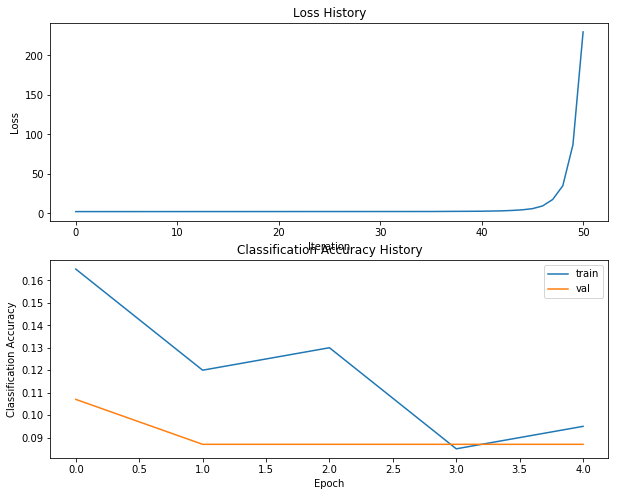



Training process took 4.221781s.
hs 500 lr 1.250000e+00 reg 1.000000e-05


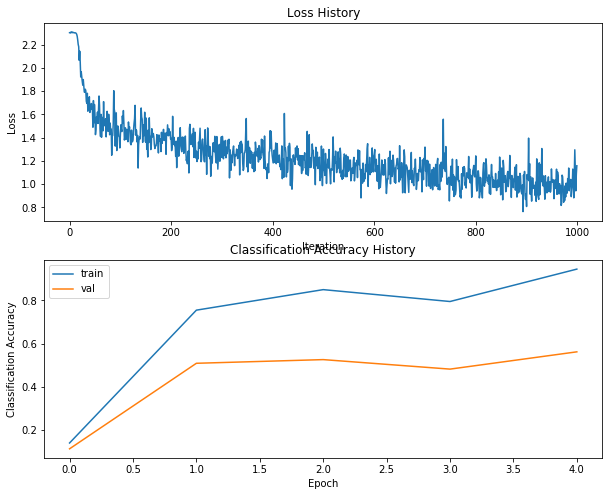



Training process took 4.166593s.
hs 500 lr 1.250000e+00 reg 1.000000e-04


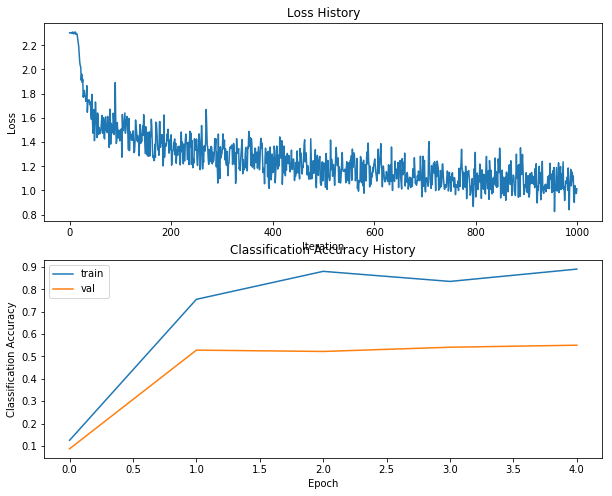



Training process took 4.271565s.
hs 500 lr 1.250000e+00 reg 5.000000e-04


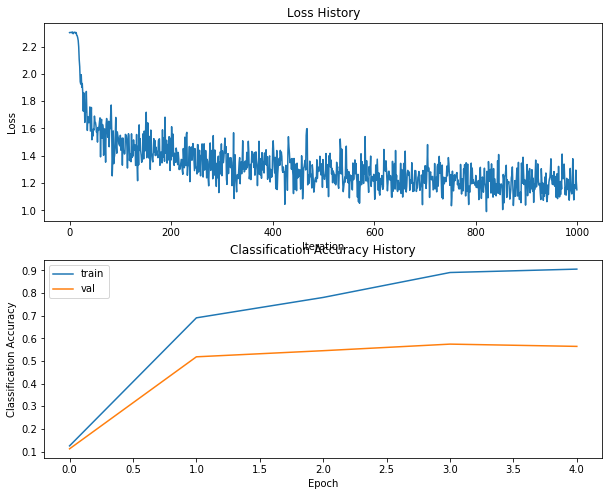



Training process took 4.285387s.
hs 500 lr 1.250000e+00 reg 1.000000e-03


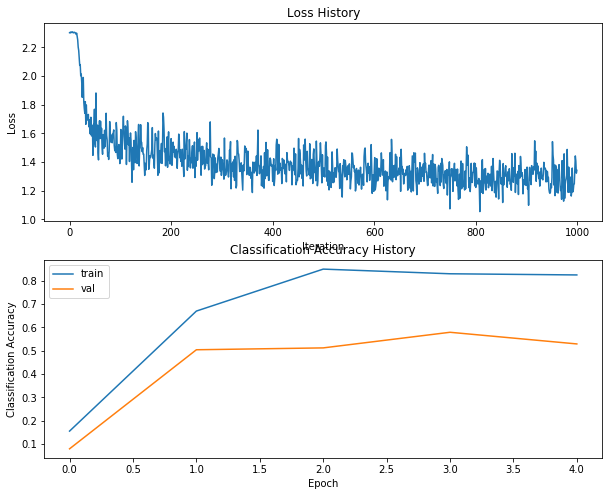



Training process took 4.536449s.
hs 500 lr 1.250000e+00 reg 5.000000e-03


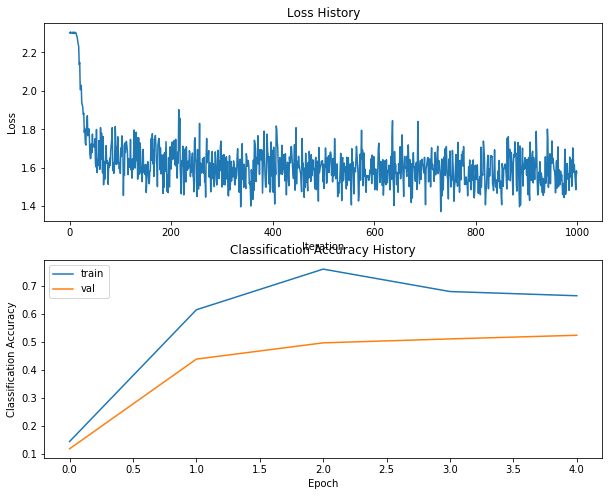



Training process took 4.411715s.
hs 500 lr 1.250000e+00 reg 1.000000e-02


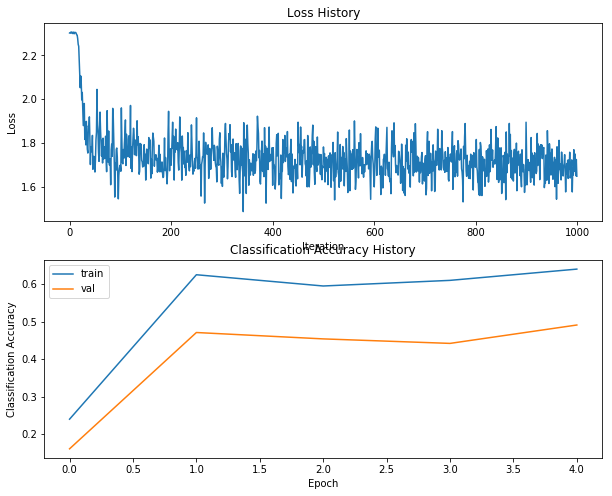



Training process took 5.212210s.
hs 500 lr 1.250000e+00 reg 1.000000e-01


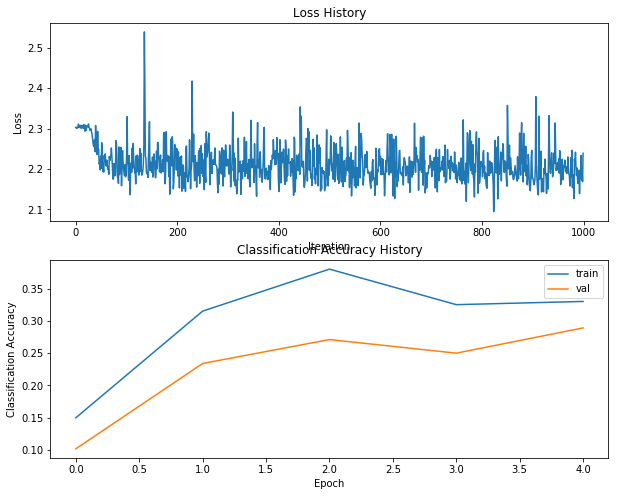



Training process took 5.678925s.
hs 500 lr 1.250000e+00 reg 1.000000e+00


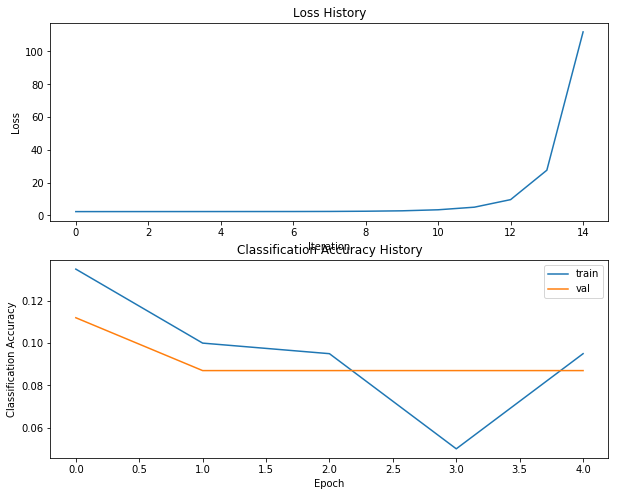



Training process took 5.099225s.
hs 500 lr 1.500000e+00 reg 1.000000e-05


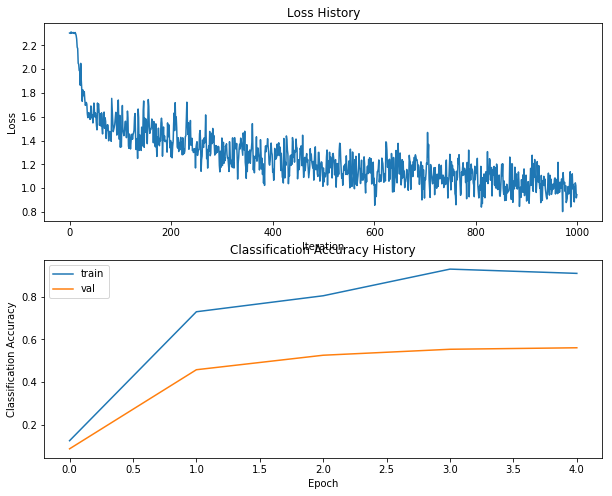



Training process took 4.393472s.
hs 500 lr 1.500000e+00 reg 1.000000e-04


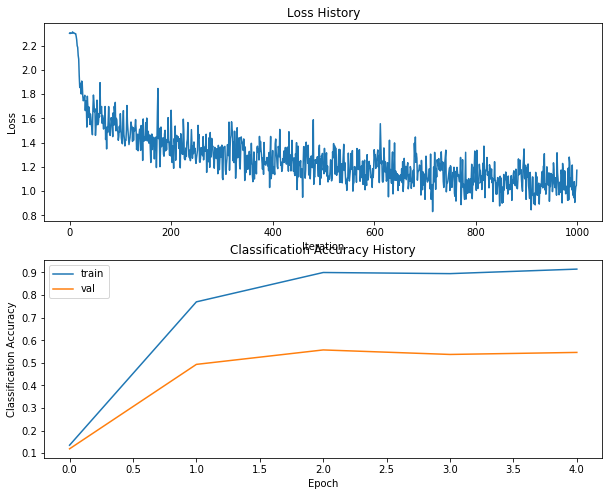



Training process took 6.578931s.
hs 500 lr 1.500000e+00 reg 5.000000e-04


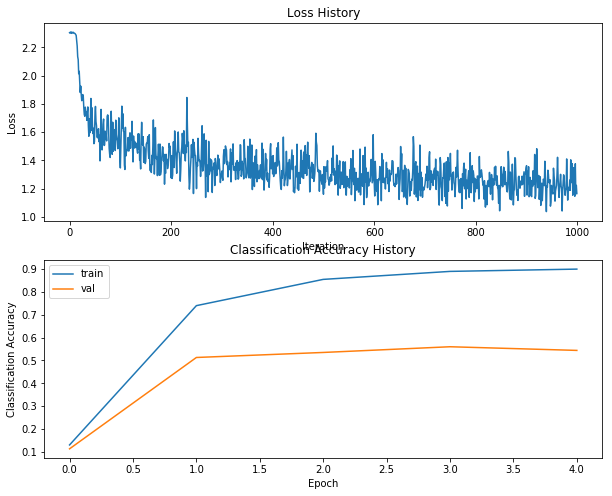



Training process took 6.378360s.
hs 500 lr 1.500000e+00 reg 1.000000e-03


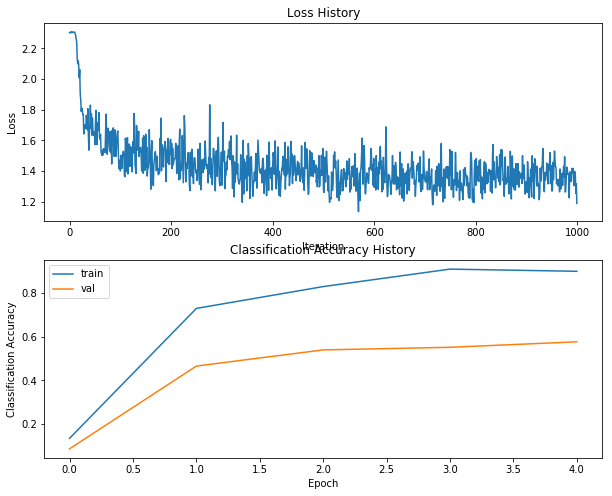



Training process took 4.537598s.
hs 500 lr 1.500000e+00 reg 5.000000e-03


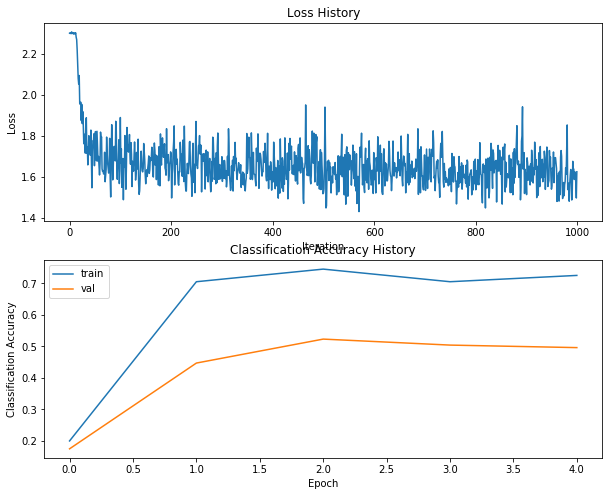



Training process took 4.485348s.
hs 500 lr 1.500000e+00 reg 1.000000e-02


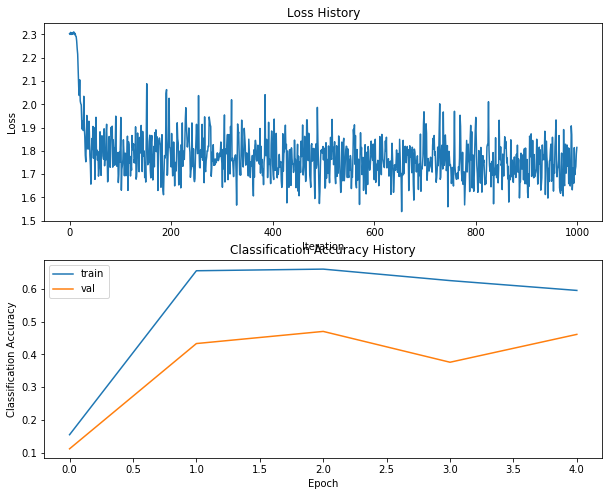



Training process took 4.199742s.
hs 500 lr 1.500000e+00 reg 1.000000e-01


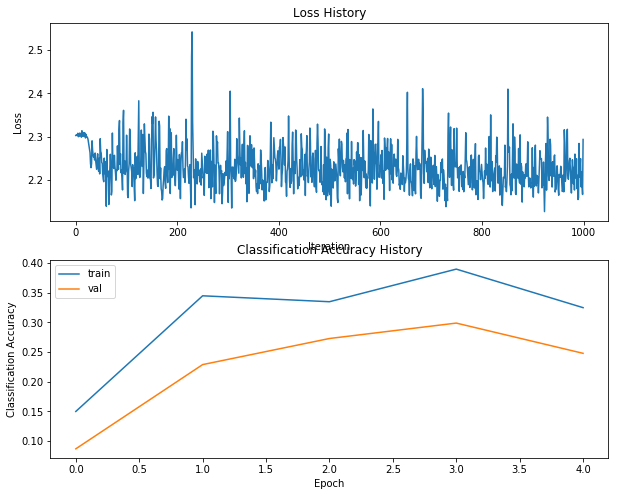



Training process took 4.568469s.
hs 500 lr 1.500000e+00 reg 1.000000e+00


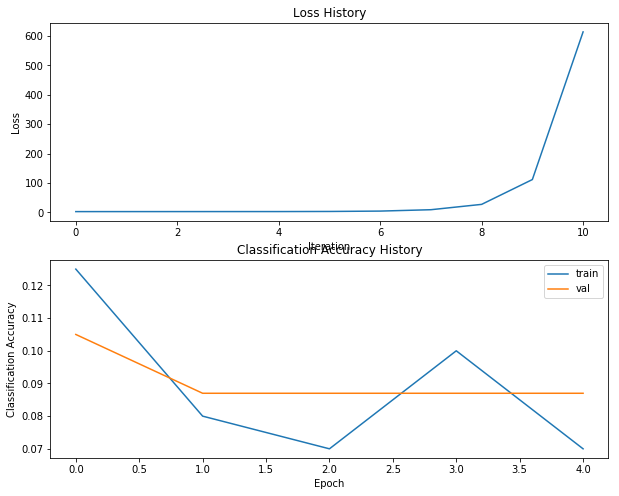



Training process took 4.349070s.
hs 500 lr 1.750000e+00 reg 1.000000e-05


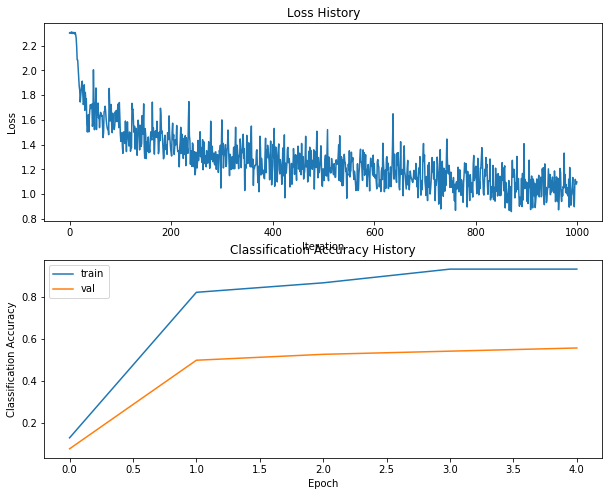



Training process took 4.373077s.
hs 500 lr 1.750000e+00 reg 1.000000e-04


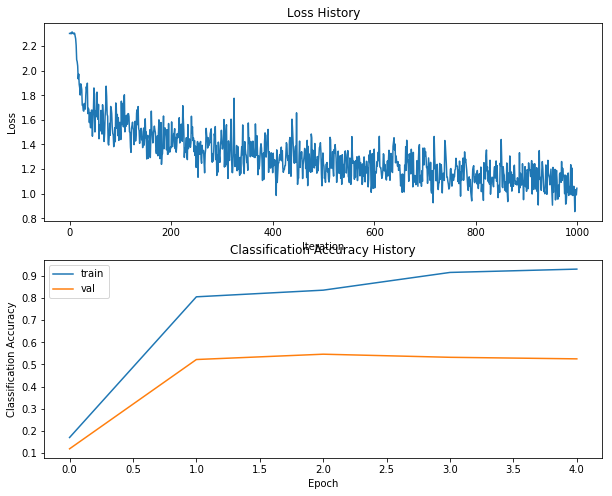



Training process took 4.428560s.
hs 500 lr 1.750000e+00 reg 5.000000e-04


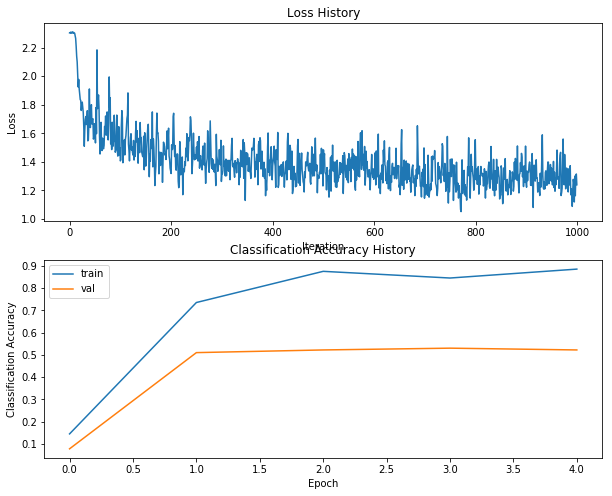



Training process took 4.378643s.
hs 500 lr 1.750000e+00 reg 1.000000e-03


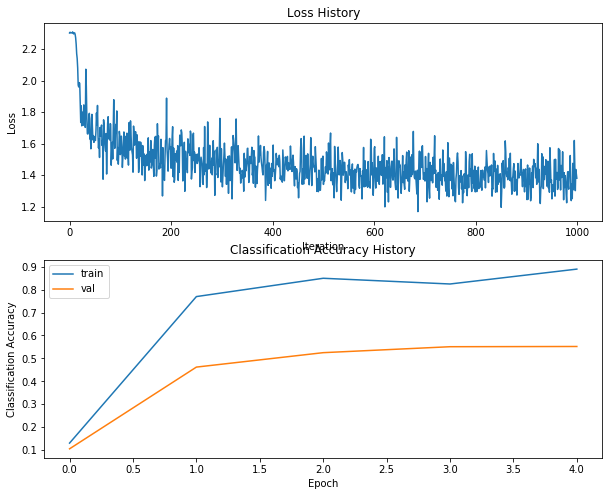



Training process took 4.498673s.
hs 500 lr 1.750000e+00 reg 5.000000e-03


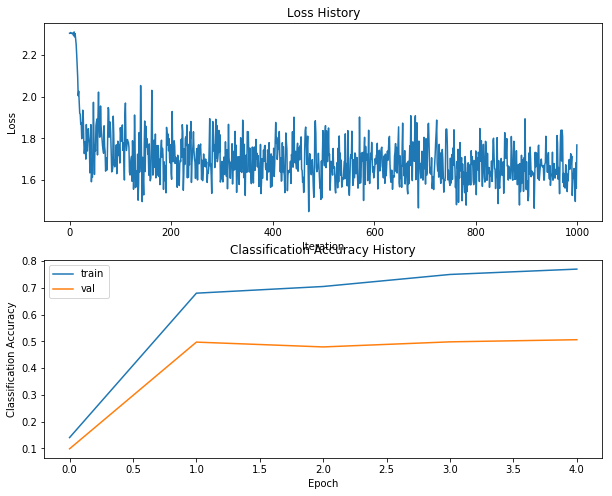



Training process took 4.305638s.
hs 500 lr 1.750000e+00 reg 1.000000e-02


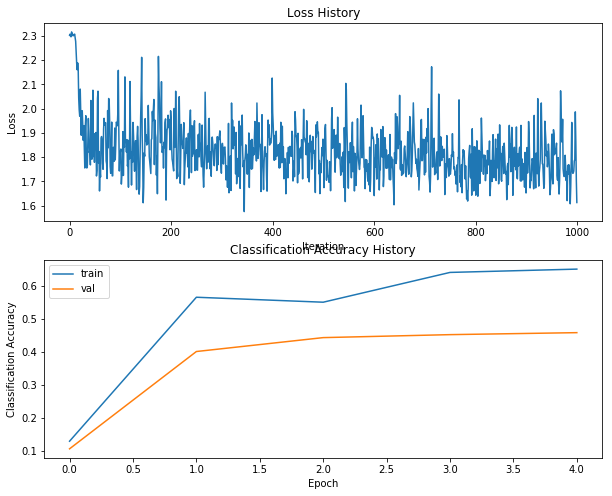



Training process took 4.208439s.
hs 500 lr 1.750000e+00 reg 1.000000e-01


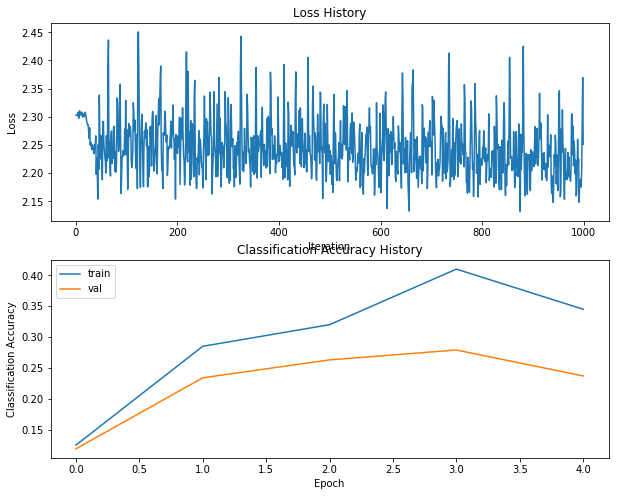



Training process took 4.549778s.
hs 500 lr 1.750000e+00 reg 1.000000e+00


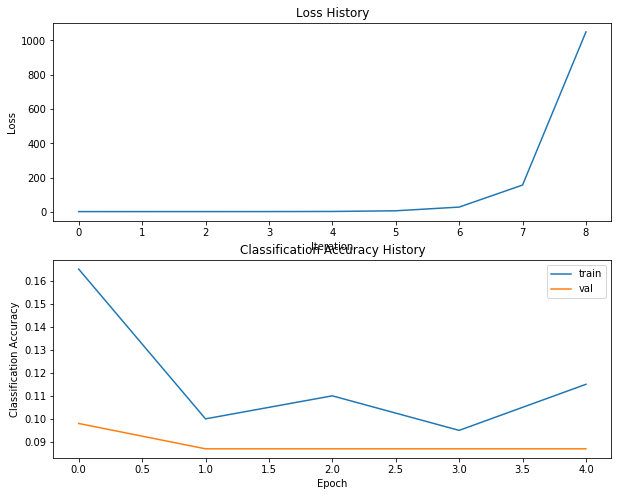



Training process took 4.200962s.
hs 500 lr 2.000000e+00 reg 1.000000e-05


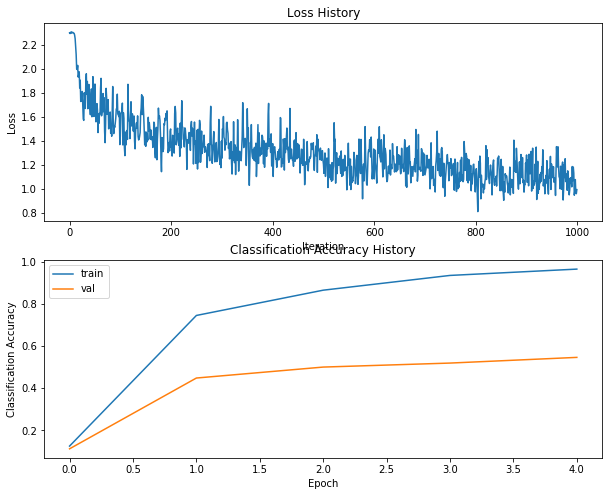



Training process took 4.189879s.
hs 500 lr 2.000000e+00 reg 1.000000e-04


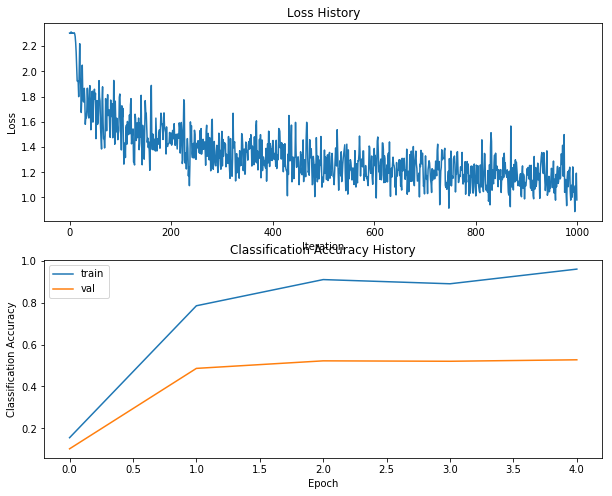



Training process took 4.349157s.
hs 500 lr 2.000000e+00 reg 5.000000e-04


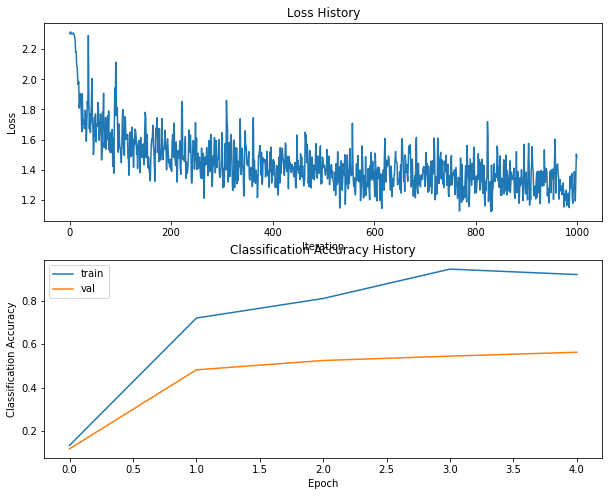



Training process took 4.374166s.
hs 500 lr 2.000000e+00 reg 1.000000e-03


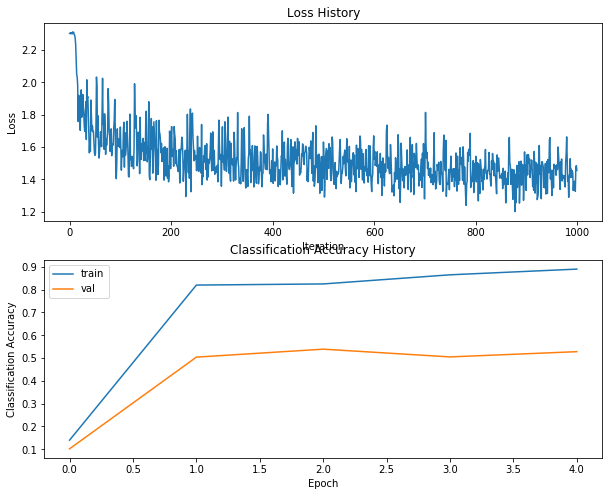



Training process took 4.438315s.
hs 500 lr 2.000000e+00 reg 5.000000e-03


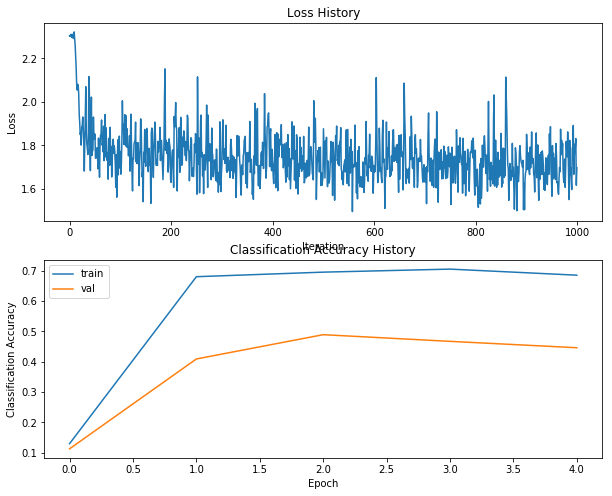



Training process took 5.122099s.
hs 500 lr 2.000000e+00 reg 1.000000e-02


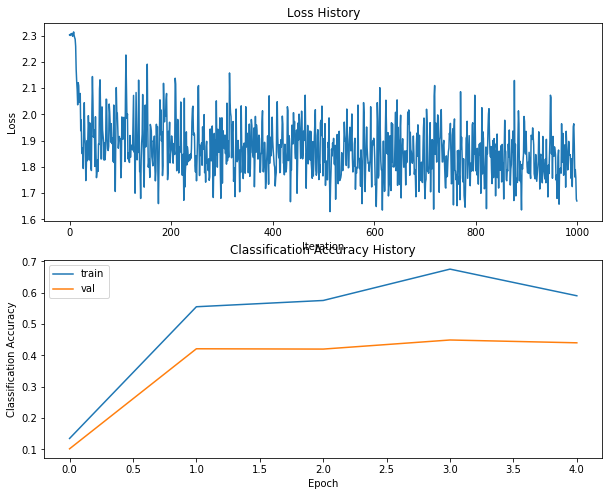



Training process took 4.650814s.
hs 500 lr 2.000000e+00 reg 1.000000e-01


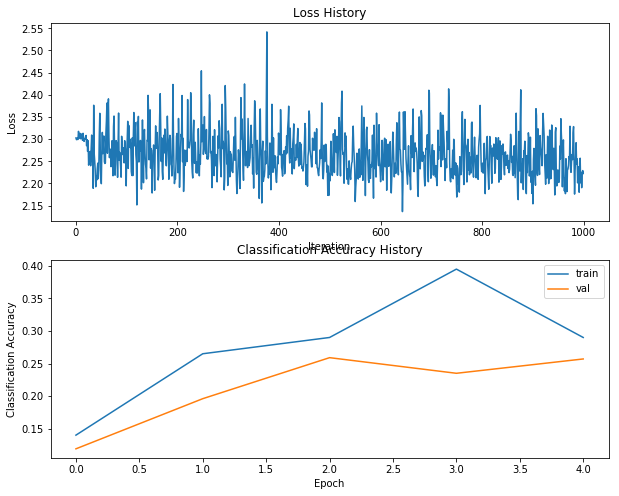



Training process took 5.524821s.
hs 500 lr 2.000000e+00 reg 1.000000e+00


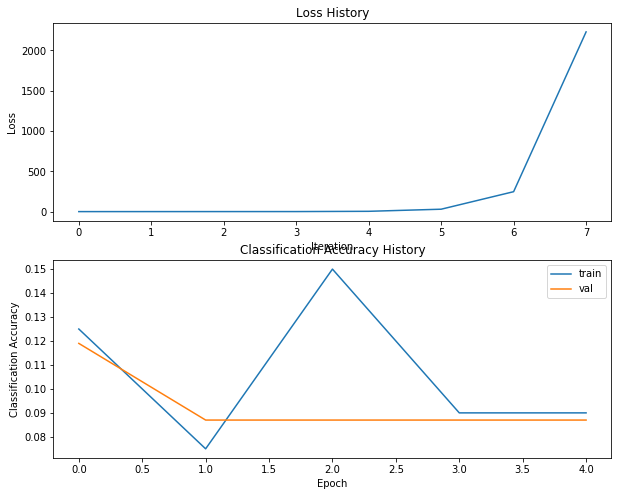



Training process took 4.356270s.
hs 500 lr 2.500000e+00 reg 1.000000e-05


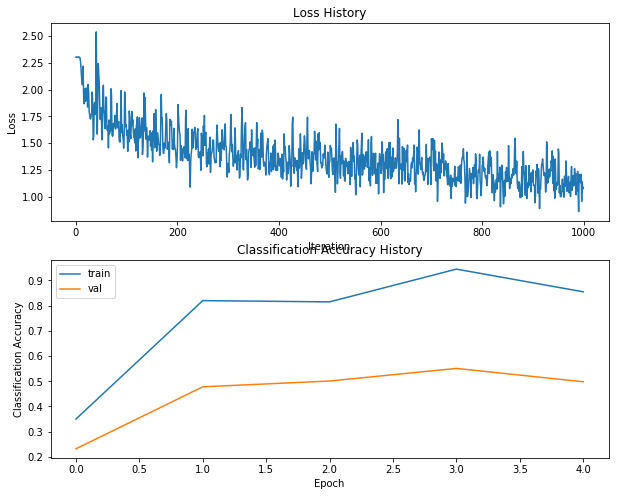



Training process took 4.247609s.
hs 500 lr 2.500000e+00 reg 1.000000e-04


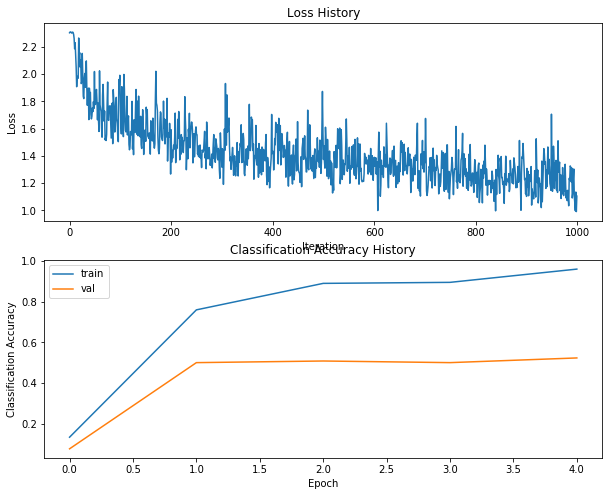



Training process took 4.124479s.
hs 500 lr 2.500000e+00 reg 5.000000e-04


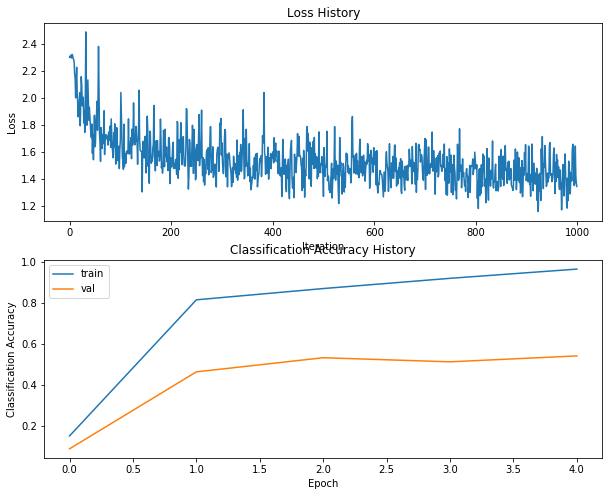



Training process took 4.047371s.
hs 500 lr 2.500000e+00 reg 1.000000e-03


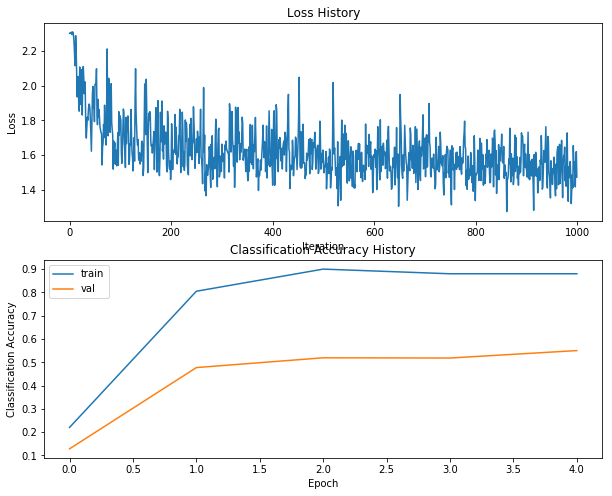



Training process took 4.282076s.
hs 500 lr 2.500000e+00 reg 5.000000e-03


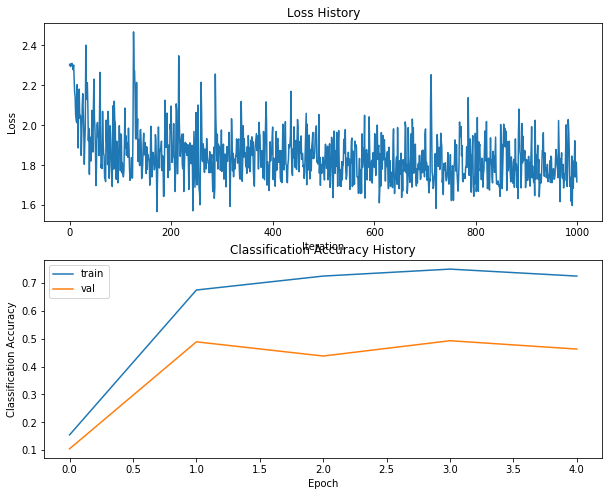



Training process took 4.119657s.
hs 500 lr 2.500000e+00 reg 1.000000e-02


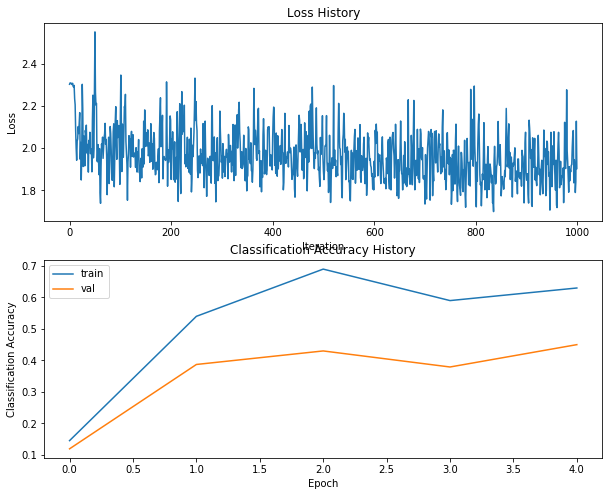



Training process took 3.969121s.
hs 500 lr 2.500000e+00 reg 1.000000e-01


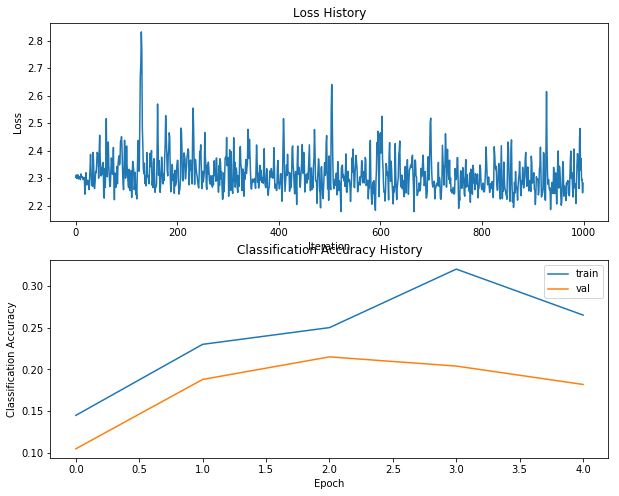



Training process took 4.281634s.
hs 500 lr 2.500000e+00 reg 1.000000e+00


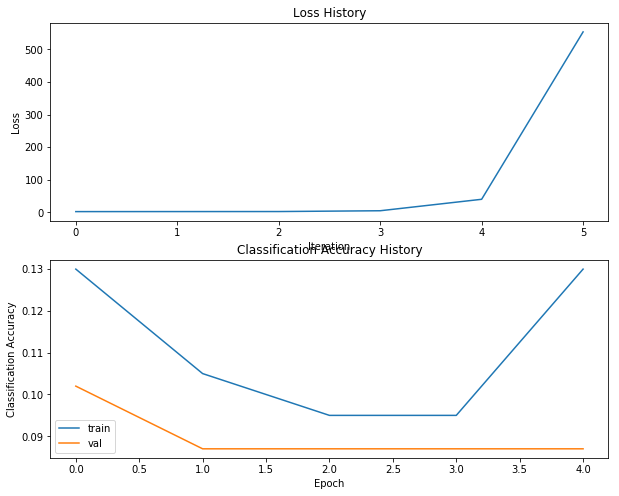



Training process took 4.861279s.
hs 600 lr 1.000000e-01 reg 1.000000e-05


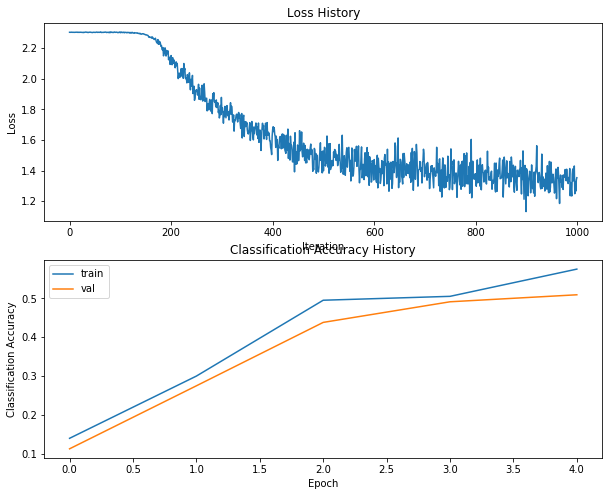



Training process took 4.753166s.
hs 600 lr 1.000000e-01 reg 1.000000e-04


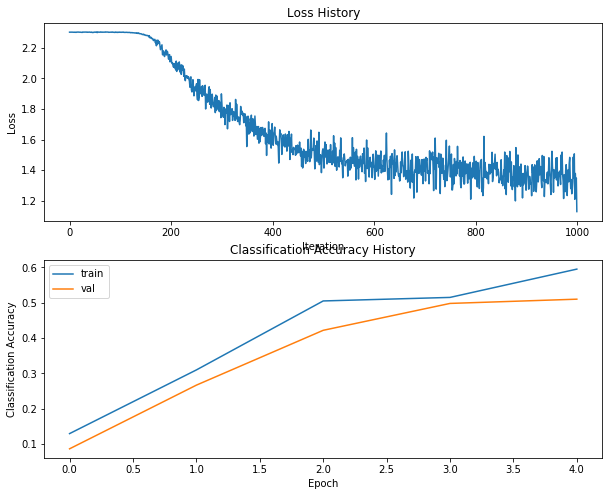



Training process took 4.775355s.
hs 600 lr 1.000000e-01 reg 5.000000e-04


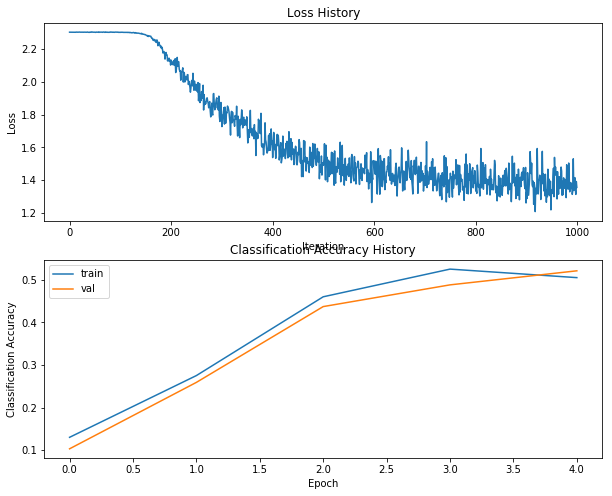



Training process took 4.932193s.
hs 600 lr 1.000000e-01 reg 1.000000e-03


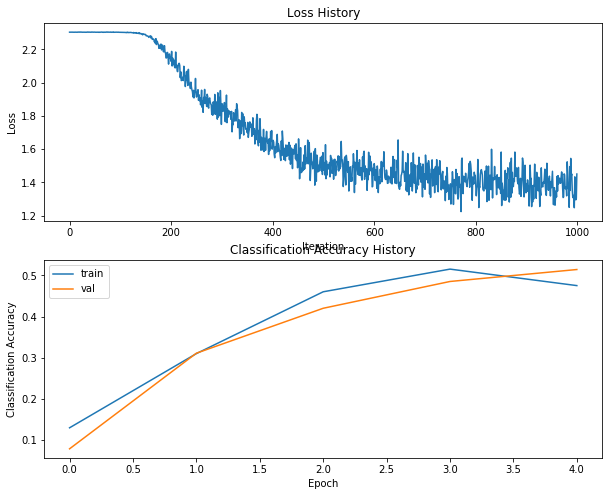



Training process took 4.687161s.
hs 600 lr 1.000000e-01 reg 5.000000e-03


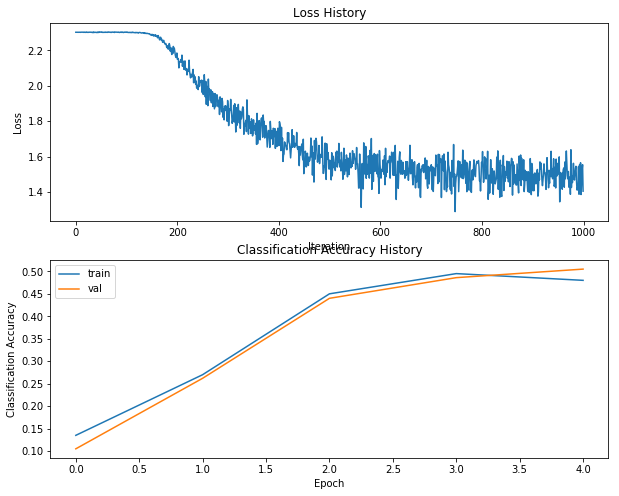



Training process took 4.960794s.
hs 600 lr 1.000000e-01 reg 1.000000e-02


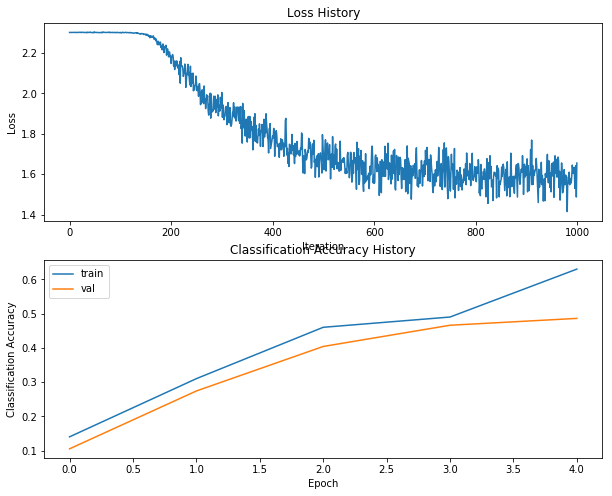



Training process took 4.629986s.
hs 600 lr 1.000000e-01 reg 1.000000e-01


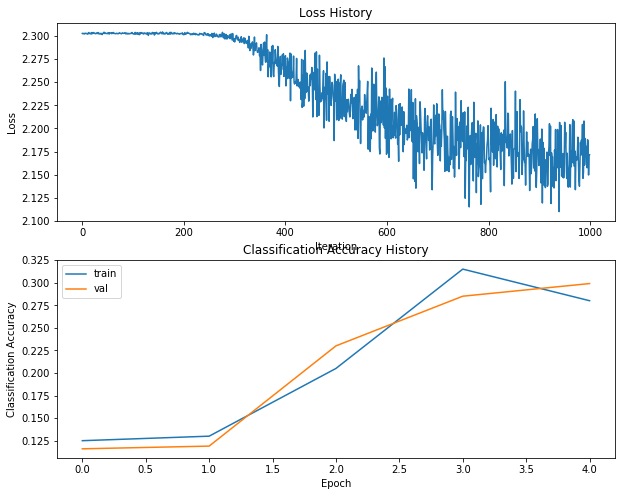



Training process took 4.472264s.
hs 600 lr 1.000000e-01 reg 1.000000e+00


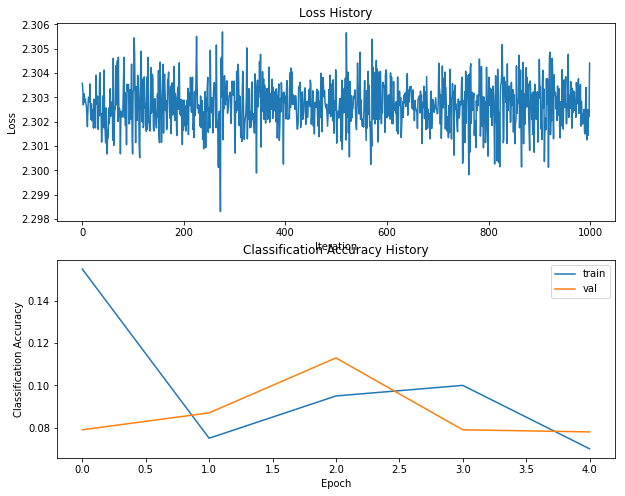



Training process took 4.760644s.
hs 600 lr 1.000000e+00 reg 1.000000e-05


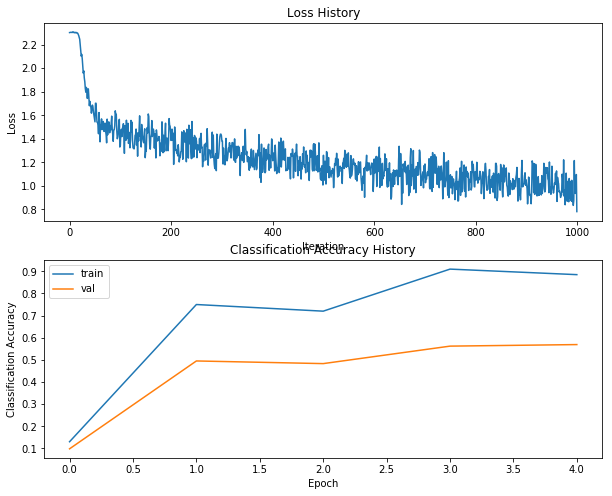



Training process took 4.817699s.
hs 600 lr 1.000000e+00 reg 1.000000e-04


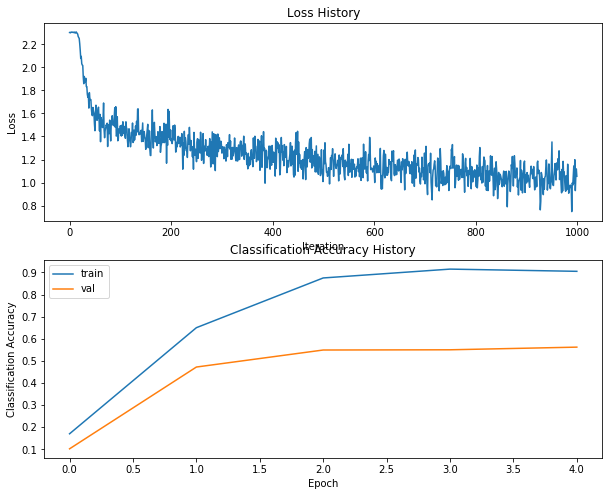



Training process took 4.944346s.
hs 600 lr 1.000000e+00 reg 5.000000e-04


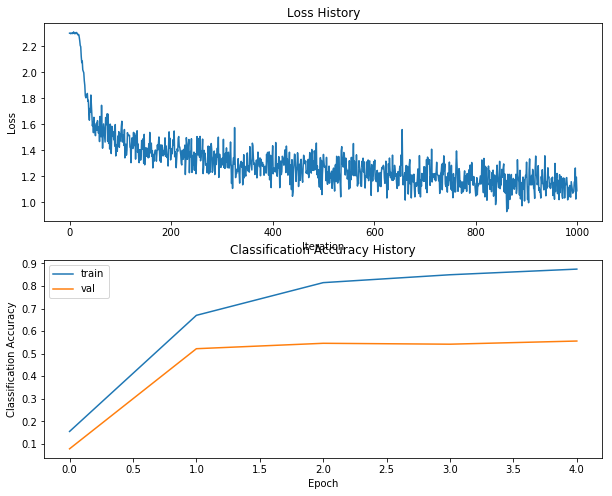



Training process took 5.127196s.
hs 600 lr 1.000000e+00 reg 1.000000e-03


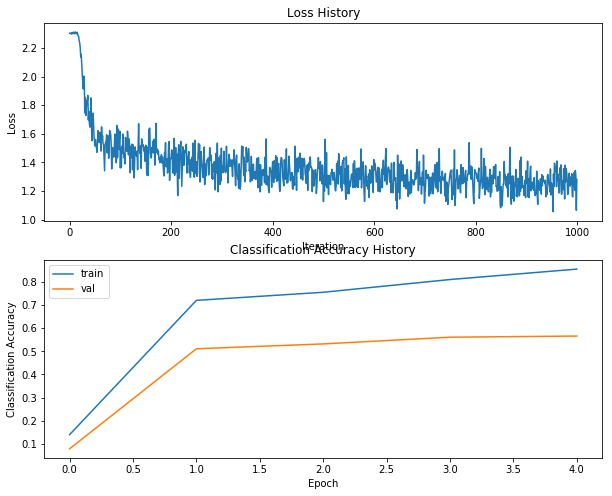



Training process took 5.468007s.
hs 600 lr 1.000000e+00 reg 5.000000e-03


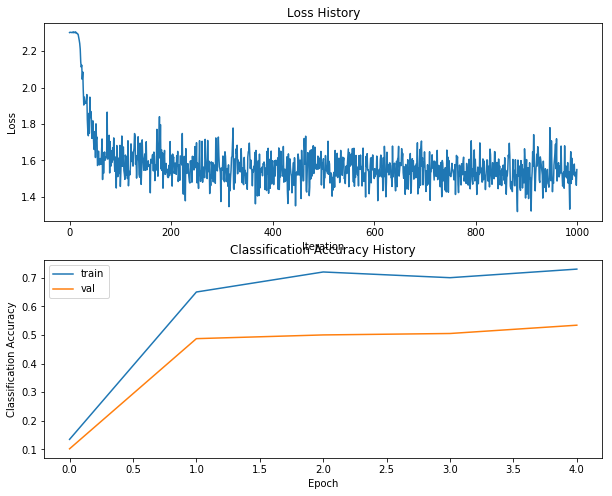



Training process took 5.098008s.
hs 600 lr 1.000000e+00 reg 1.000000e-02


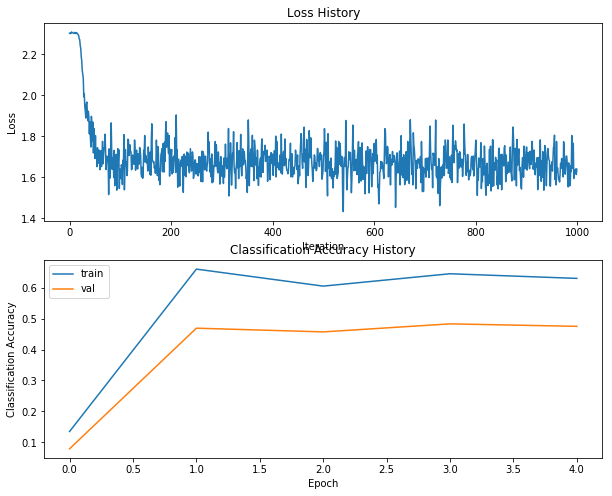



Training process took 4.799736s.
hs 600 lr 1.000000e+00 reg 1.000000e-01


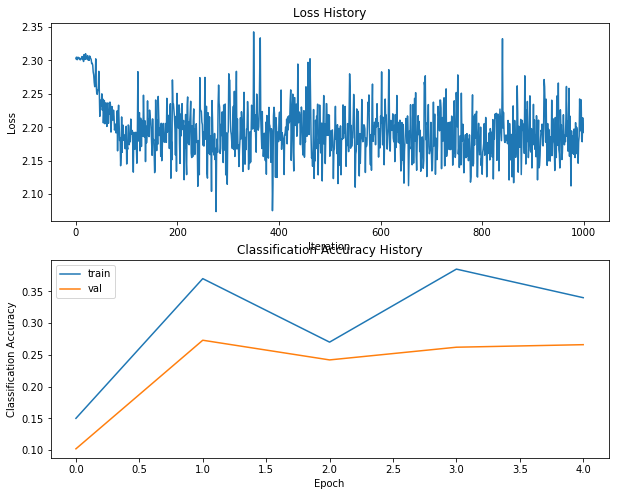



Training process took 4.950925s.
hs 600 lr 1.000000e+00 reg 1.000000e+00


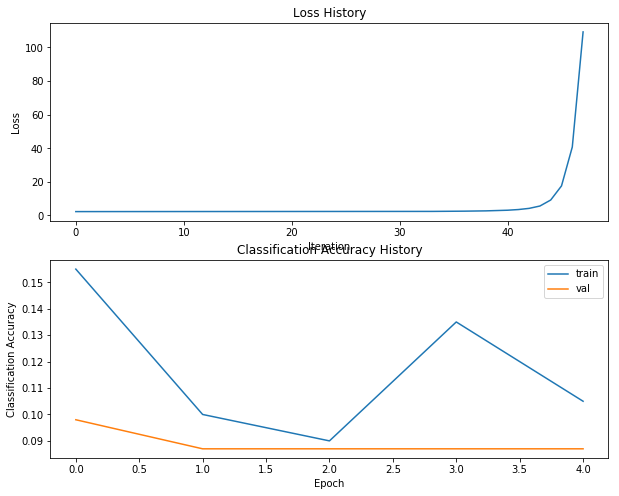



Training process took 4.857984s.
hs 600 lr 1.250000e+00 reg 1.000000e-05


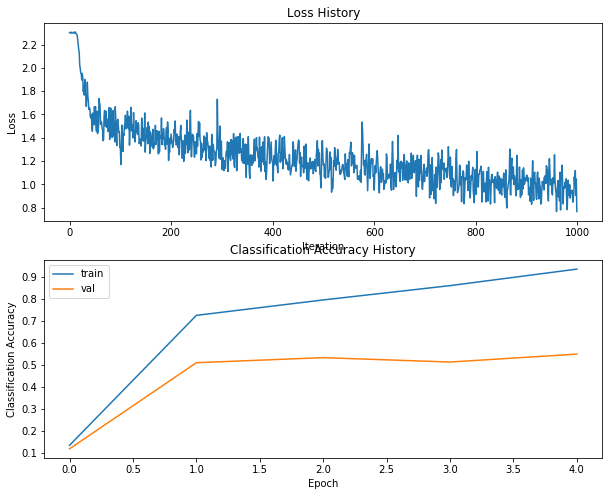



Training process took 4.886708s.
hs 600 lr 1.250000e+00 reg 1.000000e-04


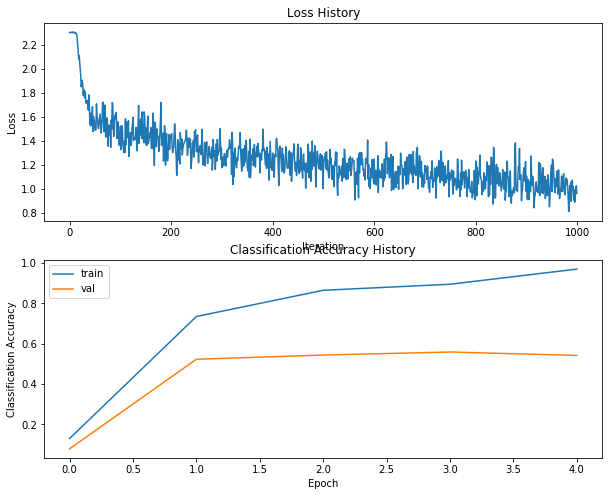



Training process took 4.729259s.
hs 600 lr 1.250000e+00 reg 5.000000e-04


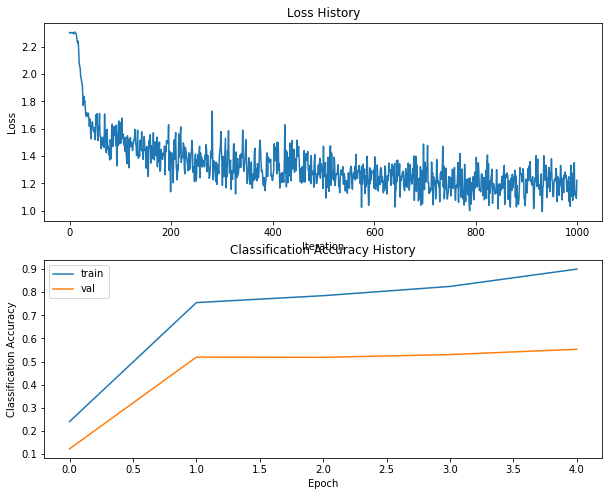



Training process took 5.245592s.
hs 600 lr 1.250000e+00 reg 1.000000e-03


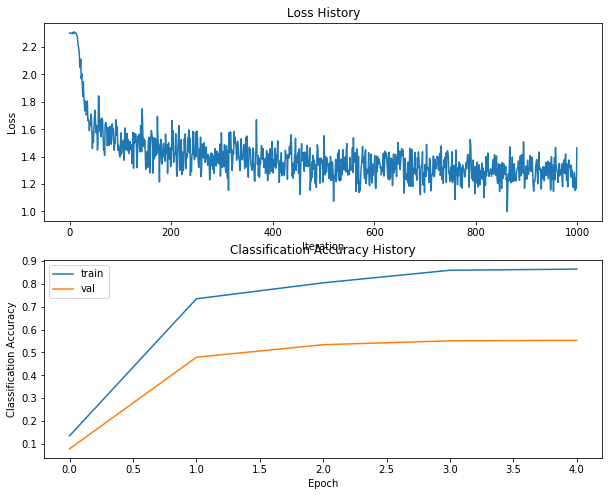



Training process took 5.222434s.
hs 600 lr 1.250000e+00 reg 5.000000e-03


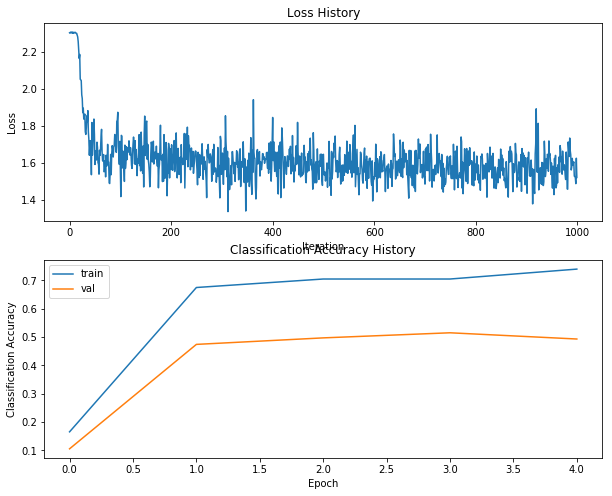



Training process took 5.257987s.
hs 600 lr 1.250000e+00 reg 1.000000e-02


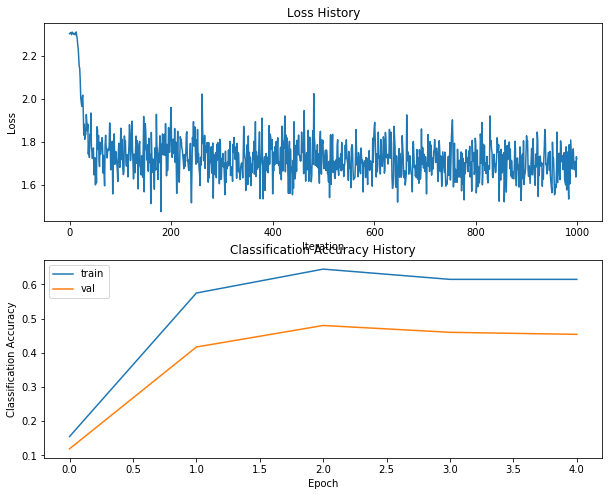



Training process took 4.928354s.
hs 600 lr 1.250000e+00 reg 1.000000e-01


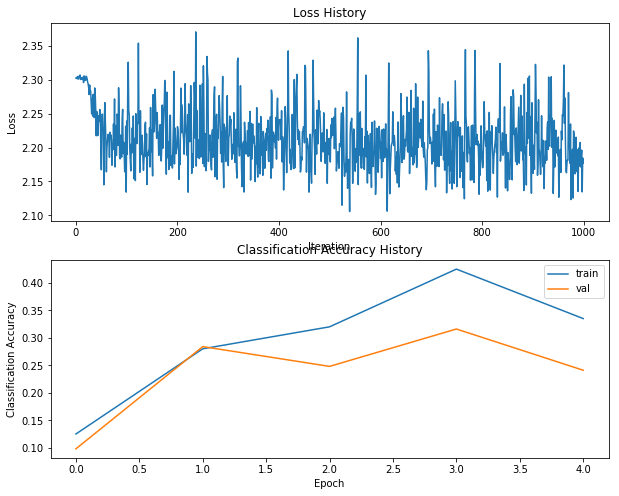



Training process took 5.351018s.
hs 600 lr 1.250000e+00 reg 1.000000e+00


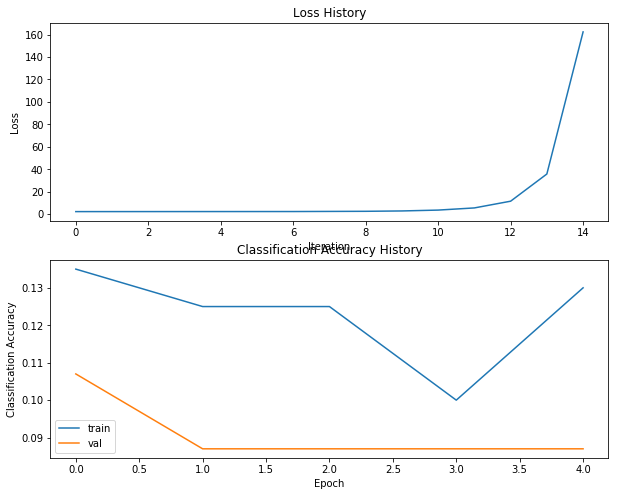



Training process took 5.014023s.
hs 600 lr 1.500000e+00 reg 1.000000e-05


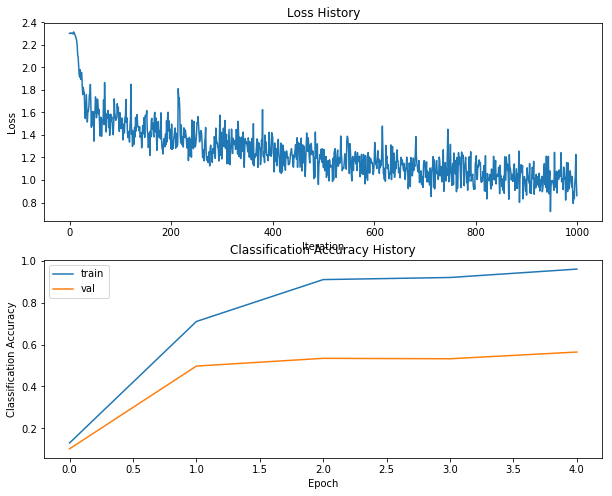



Training process took 4.739890s.
hs 600 lr 1.500000e+00 reg 1.000000e-04


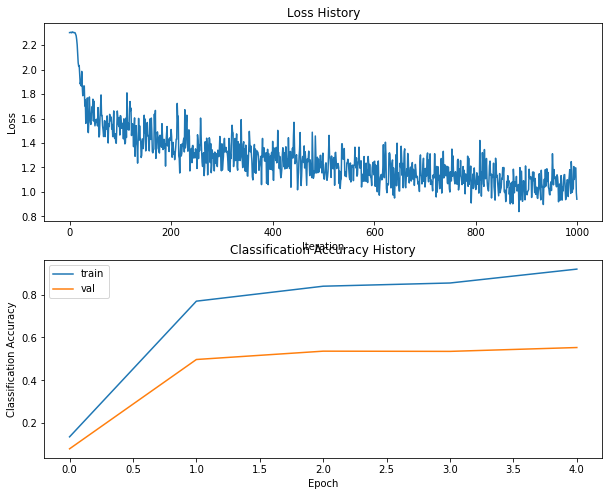



Training process took 5.030493s.
hs 600 lr 1.500000e+00 reg 5.000000e-04


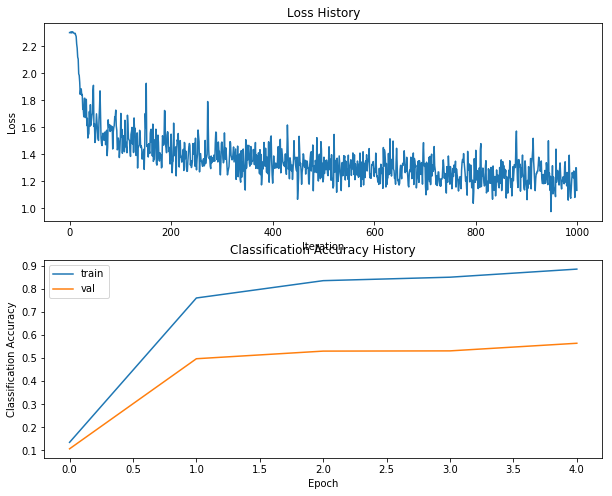



Training process took 4.979352s.
hs 600 lr 1.500000e+00 reg 1.000000e-03


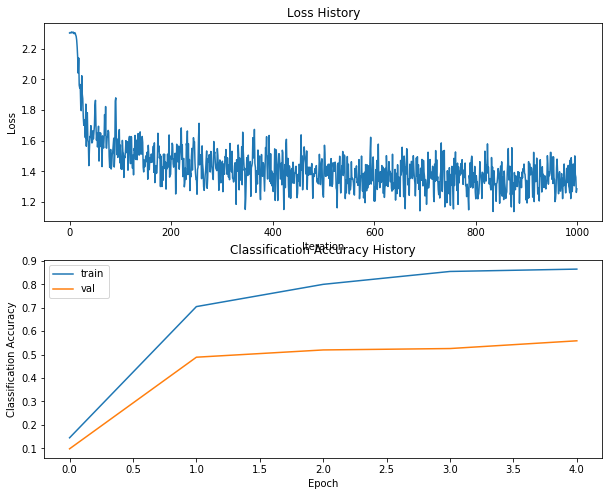



Training process took 4.805716s.
hs 600 lr 1.500000e+00 reg 5.000000e-03


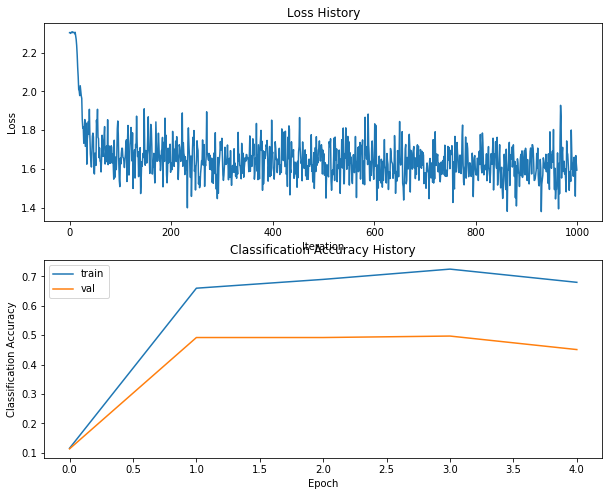



Training process took 4.817298s.
hs 600 lr 1.500000e+00 reg 1.000000e-02


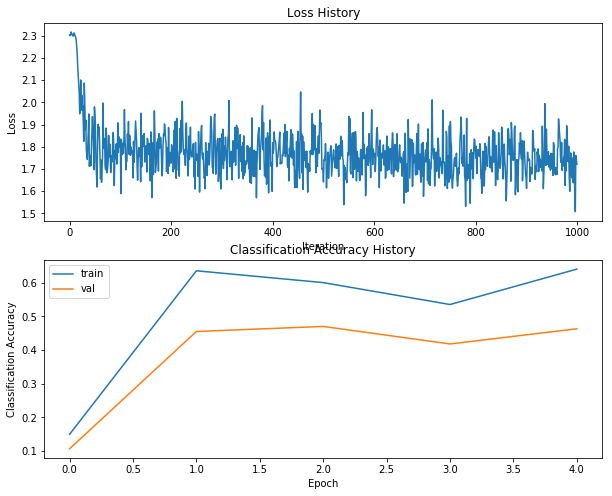



Training process took 4.903218s.
hs 600 lr 1.500000e+00 reg 1.000000e-01


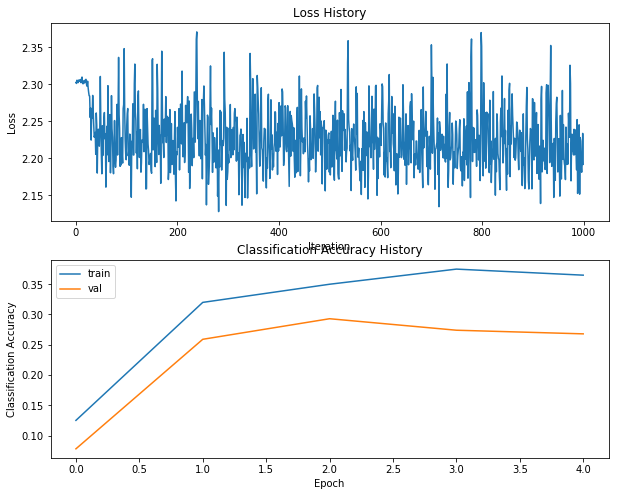



Training process took 4.898436s.
hs 600 lr 1.500000e+00 reg 1.000000e+00


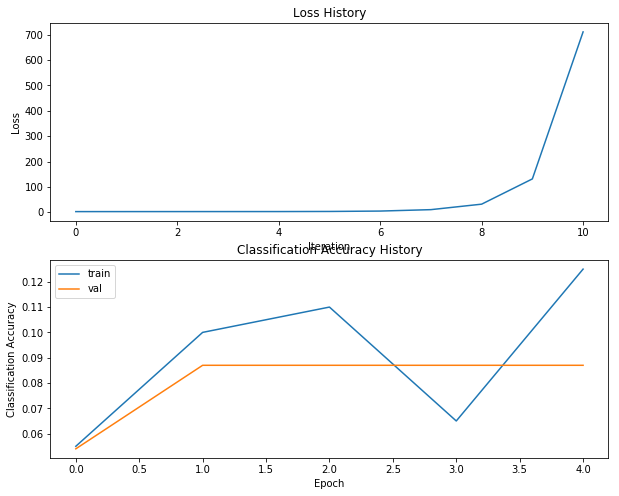



Training process took 4.673379s.
hs 600 lr 1.750000e+00 reg 1.000000e-05


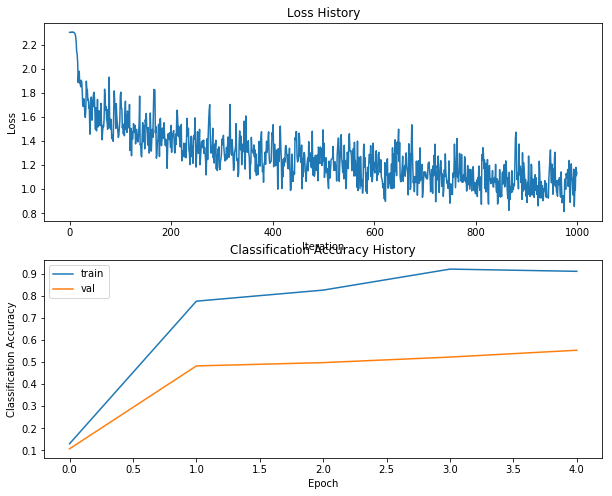



Training process took 4.952625s.
hs 600 lr 1.750000e+00 reg 1.000000e-04


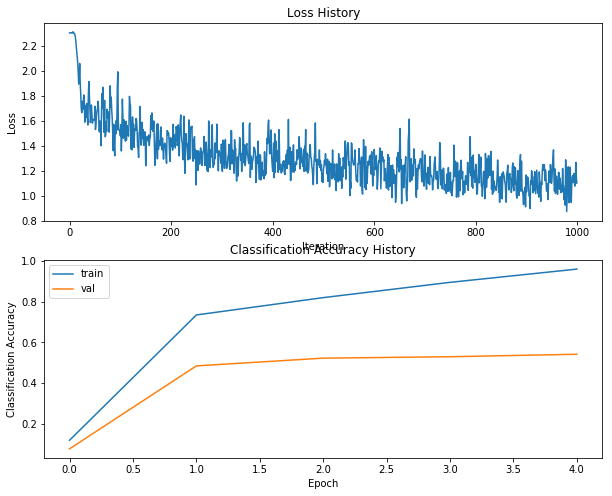



Training process took 4.821292s.
hs 600 lr 1.750000e+00 reg 5.000000e-04


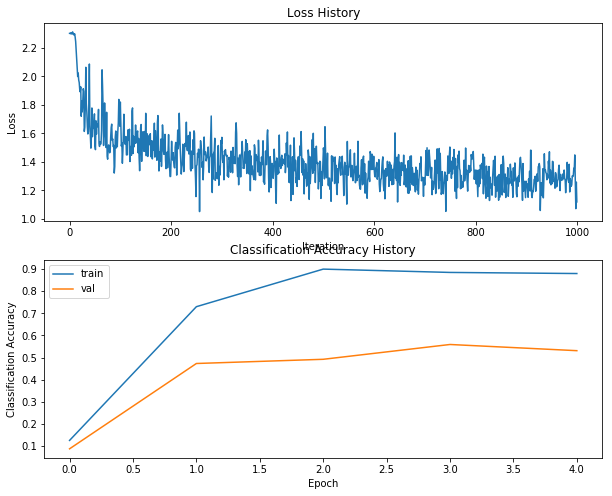



Training process took 4.775294s.
hs 600 lr 1.750000e+00 reg 1.000000e-03


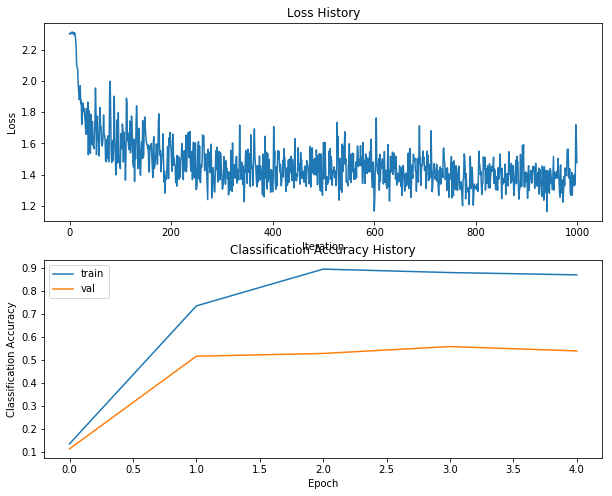



Training process took 5.451808s.
hs 600 lr 1.750000e+00 reg 5.000000e-03


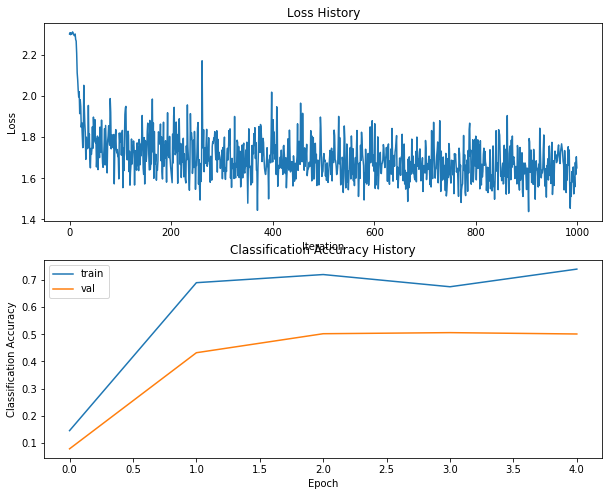



Training process took 5.103637s.
hs 600 lr 1.750000e+00 reg 1.000000e-02


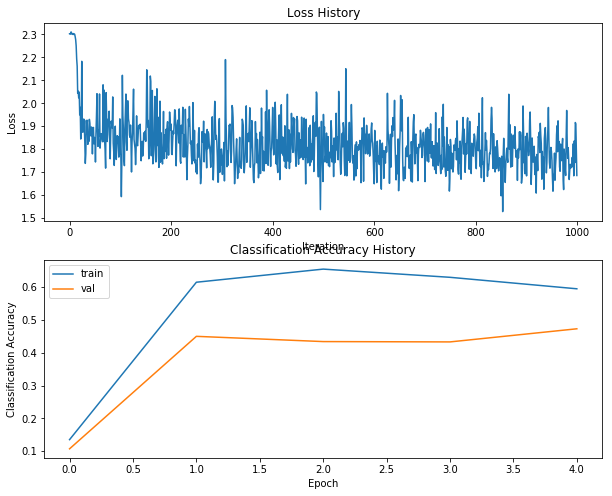



Training process took 4.633192s.
hs 600 lr 1.750000e+00 reg 1.000000e-01


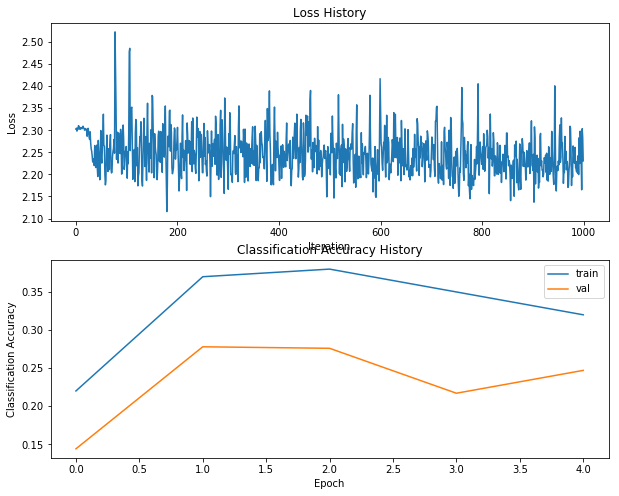



Training process took 5.265247s.
hs 600 lr 1.750000e+00 reg 1.000000e+00


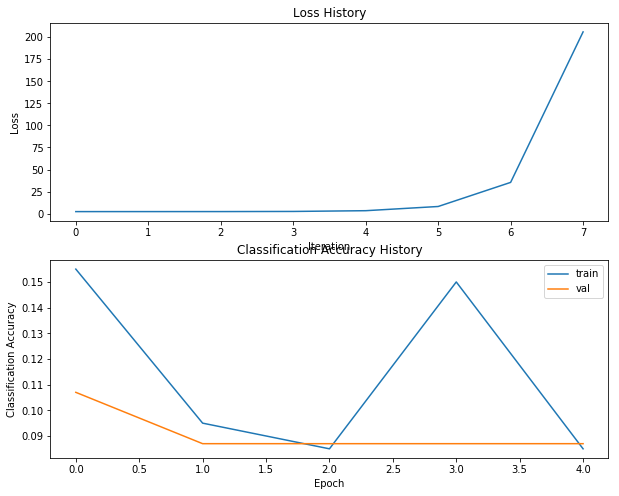



Training process took 4.866787s.
hs 600 lr 2.000000e+00 reg 1.000000e-05


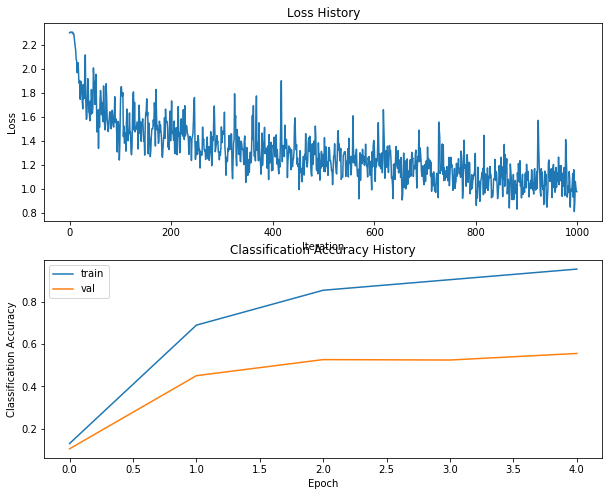



Training process took 4.994359s.
hs 600 lr 2.000000e+00 reg 1.000000e-04


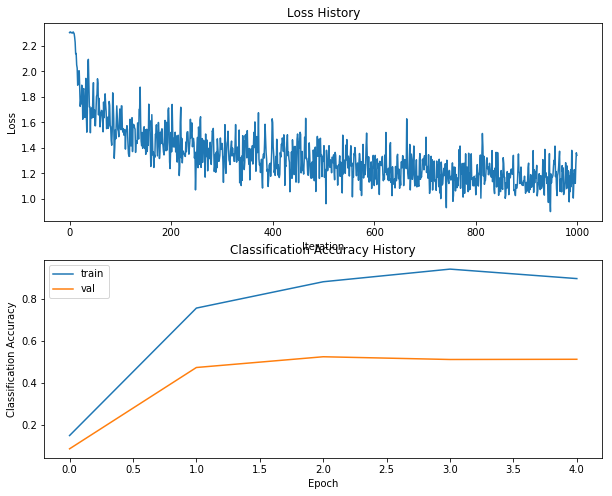



Training process took 5.119578s.
hs 600 lr 2.000000e+00 reg 5.000000e-04


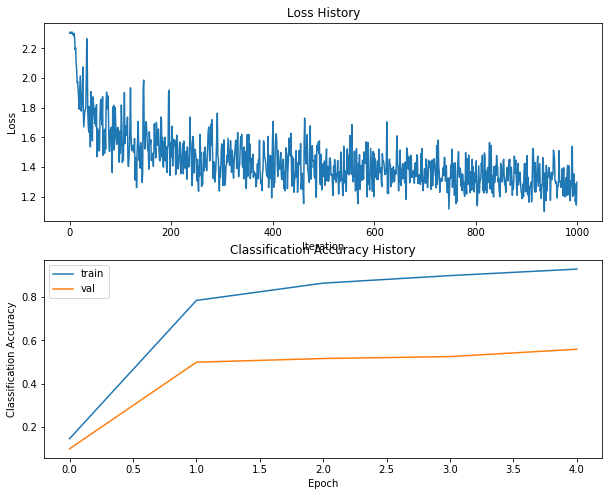



Training process took 5.021469s.
hs 600 lr 2.000000e+00 reg 1.000000e-03


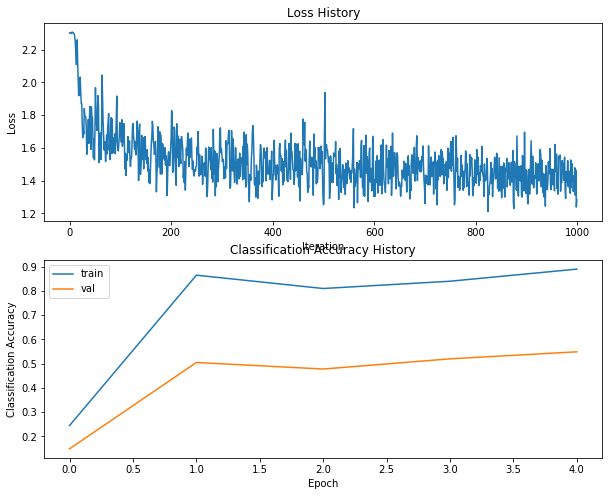



Training process took 5.095933s.
hs 600 lr 2.000000e+00 reg 5.000000e-03


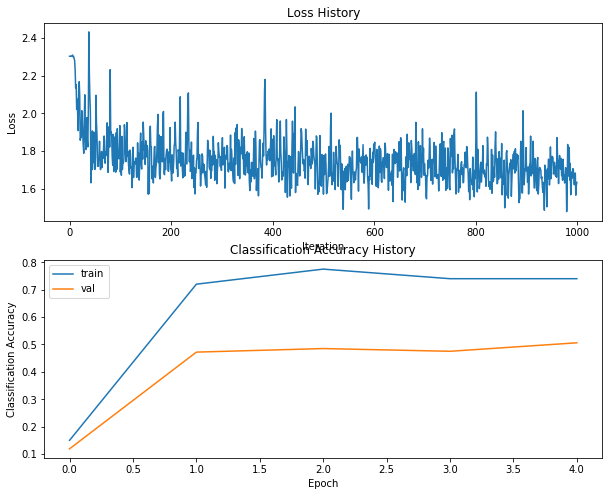



Training process took 5.109596s.
hs 600 lr 2.000000e+00 reg 1.000000e-02


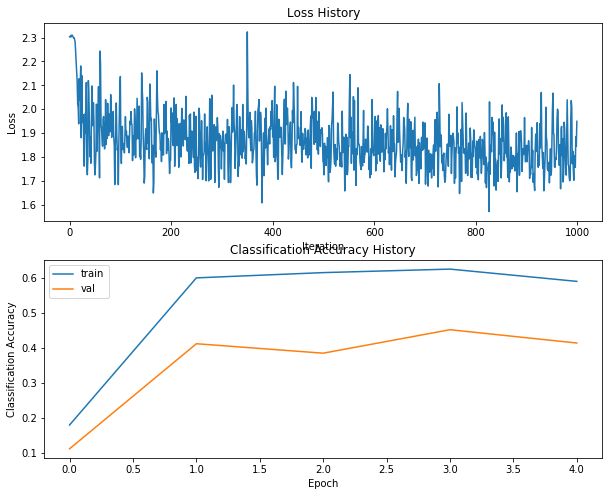



Training process took 4.881029s.
hs 600 lr 2.000000e+00 reg 1.000000e-01


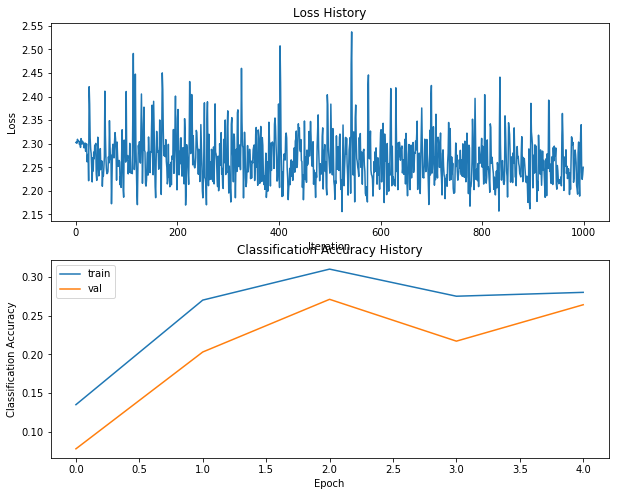



Training process took 5.336195s.
hs 600 lr 2.000000e+00 reg 1.000000e+00


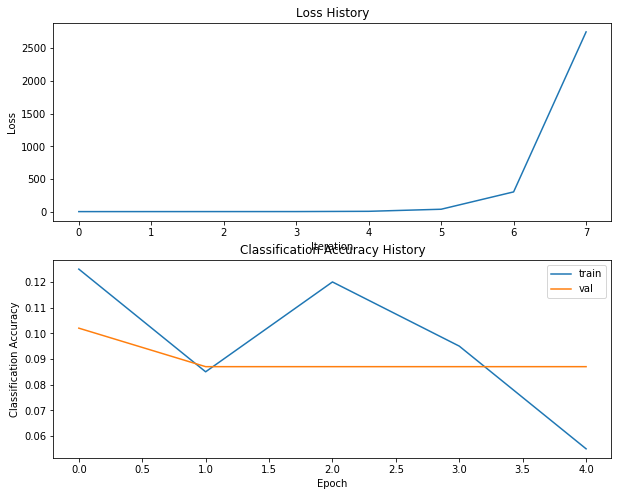



Training process took 4.758238s.
hs 600 lr 2.500000e+00 reg 1.000000e-05


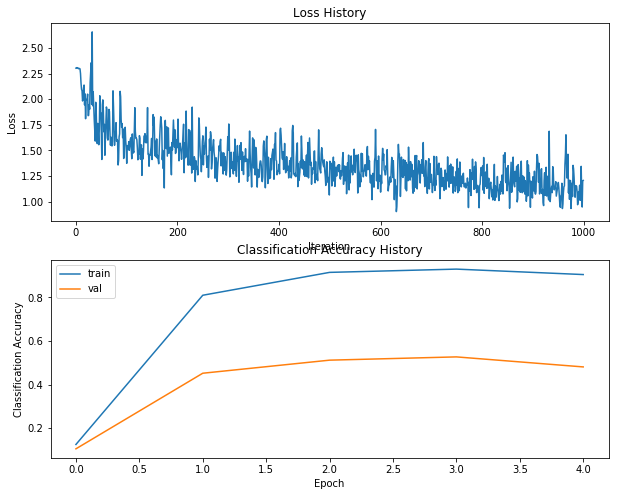



Training process took 4.881888s.
hs 600 lr 2.500000e+00 reg 1.000000e-04


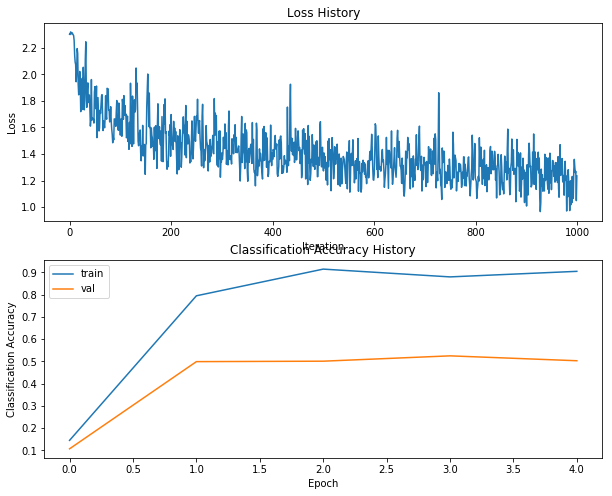



Training process took 4.913043s.
hs 600 lr 2.500000e+00 reg 5.000000e-04


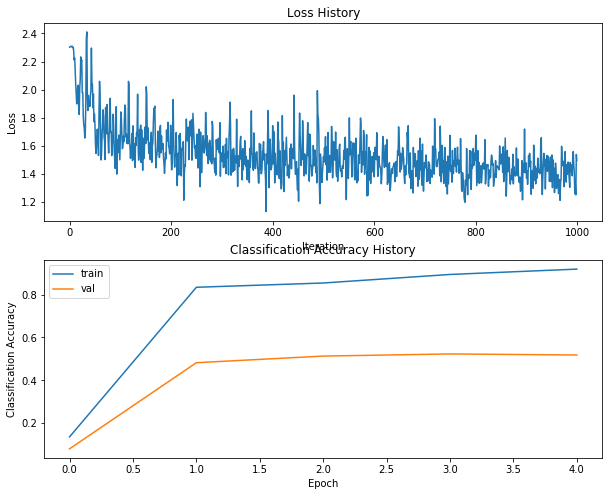



Training process took 5.015591s.
hs 600 lr 2.500000e+00 reg 1.000000e-03


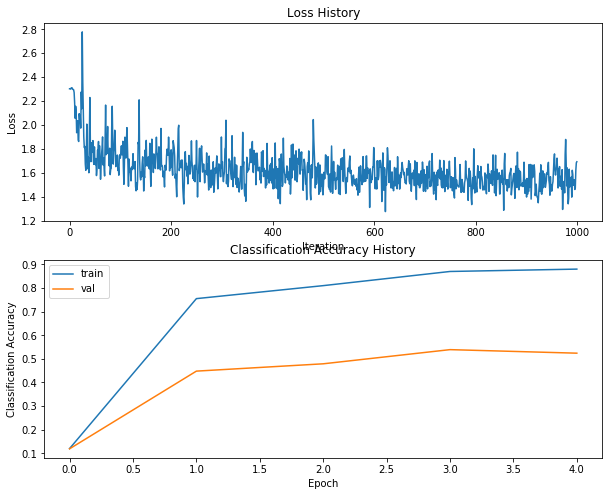



Training process took 6.126718s.
hs 600 lr 2.500000e+00 reg 5.000000e-03


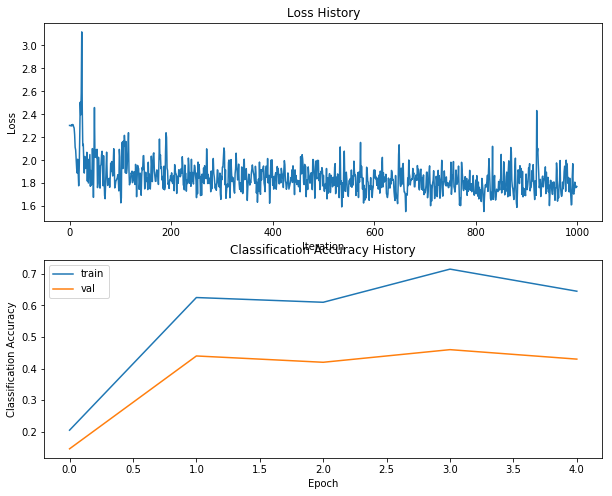



Training process took 5.358832s.
hs 600 lr 2.500000e+00 reg 1.000000e-02


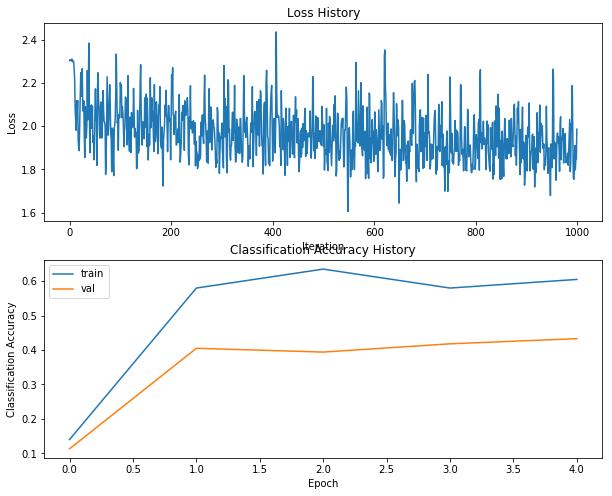



Training process took 4.821339s.
hs 600 lr 2.500000e+00 reg 1.000000e-01


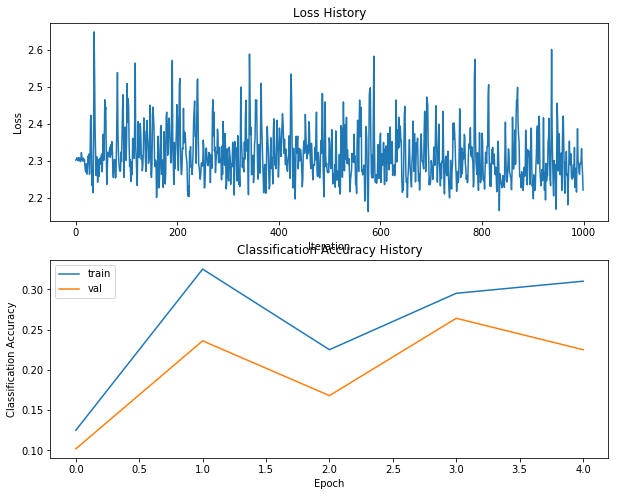



Training process took 5.106332s.
hs 600 lr 2.500000e+00 reg 1.000000e+00


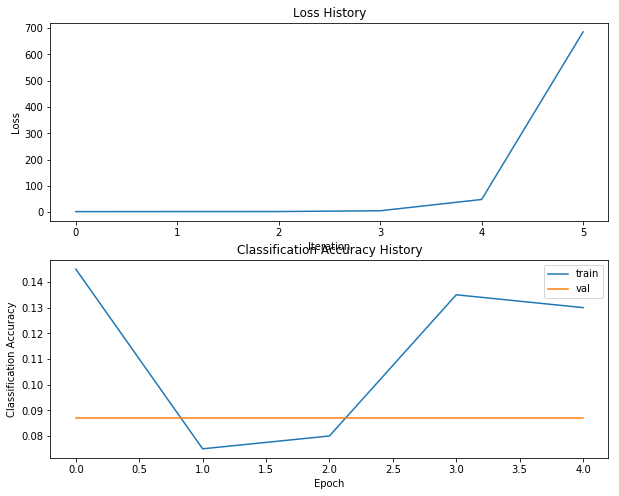



Training process took 5.878387s.
hs 700 lr 1.000000e-01 reg 1.000000e-05


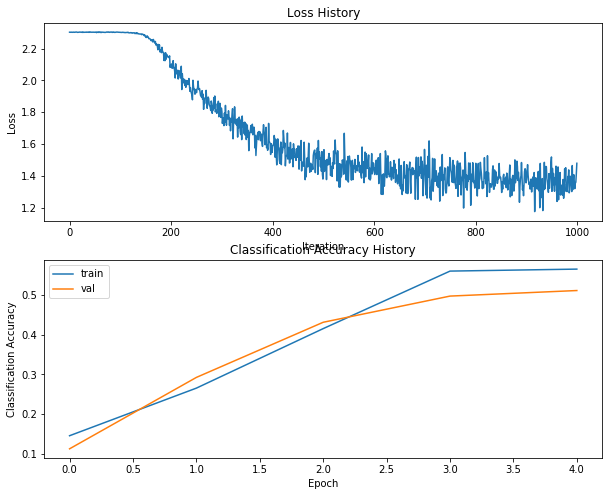



Training process took 5.689616s.
hs 700 lr 1.000000e-01 reg 1.000000e-04


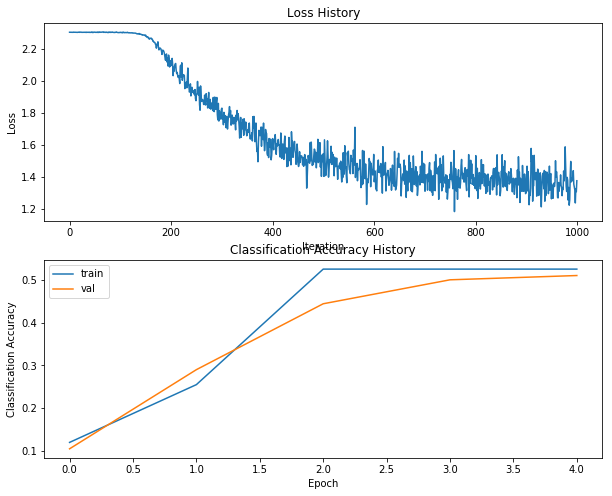



Training process took 6.011082s.
hs 700 lr 1.000000e-01 reg 5.000000e-04


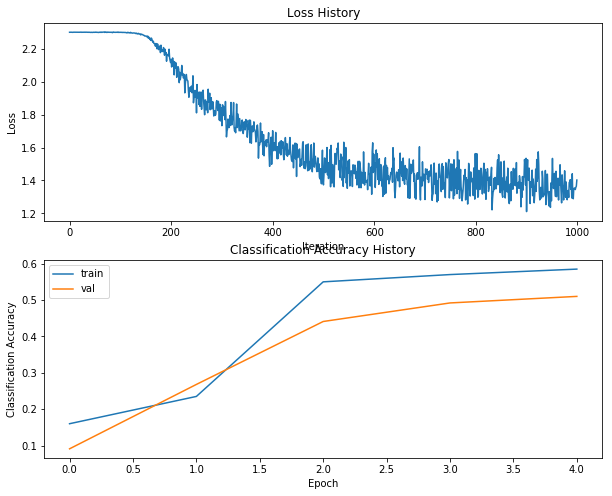



Training process took 6.013782s.
hs 700 lr 1.000000e-01 reg 1.000000e-03


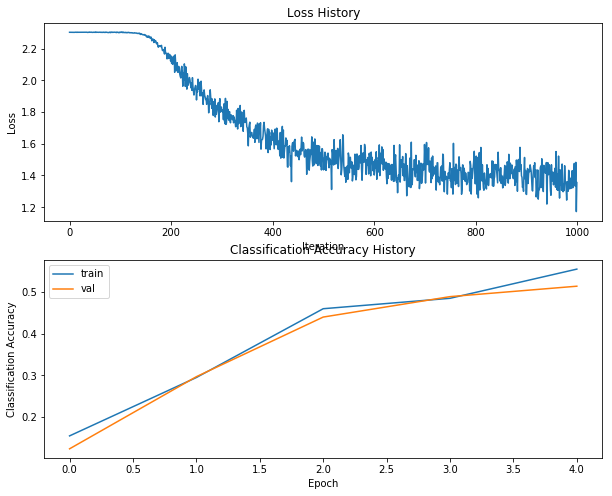



Training process took 5.719488s.
hs 700 lr 1.000000e-01 reg 5.000000e-03


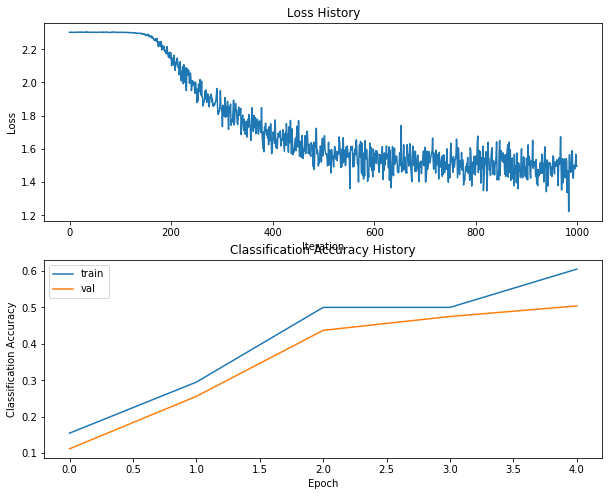



Training process took 5.537827s.
hs 700 lr 1.000000e-01 reg 1.000000e-02


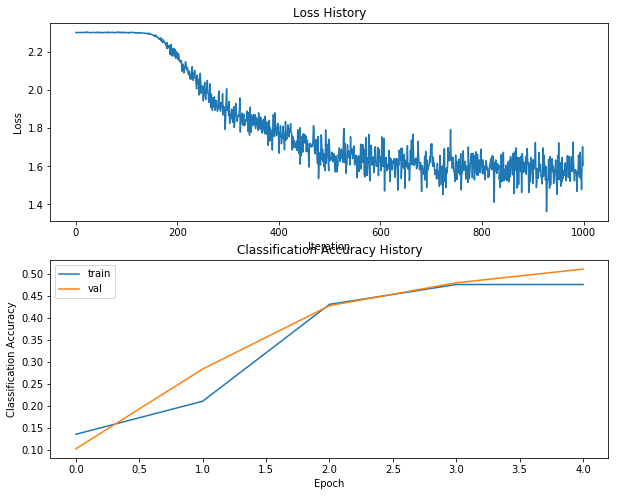



Training process took 5.351240s.
hs 700 lr 1.000000e-01 reg 1.000000e-01


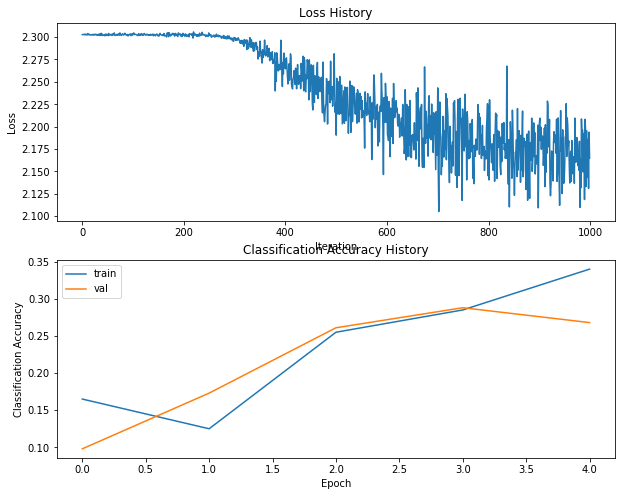



Training process took 5.057263s.
hs 700 lr 1.000000e-01 reg 1.000000e+00


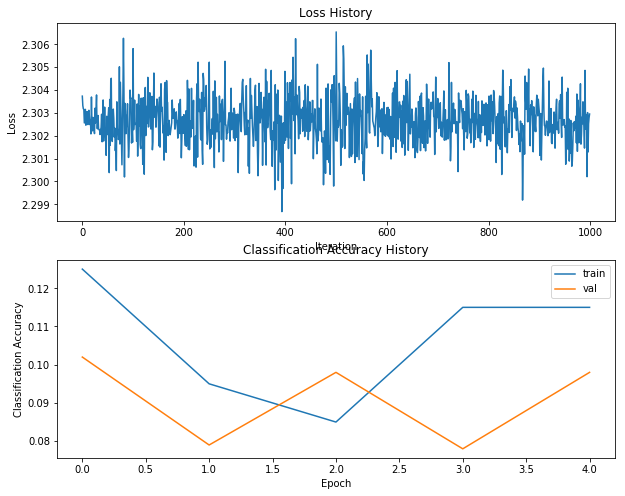



Training process took 5.562161s.
hs 700 lr 1.000000e+00 reg 1.000000e-05


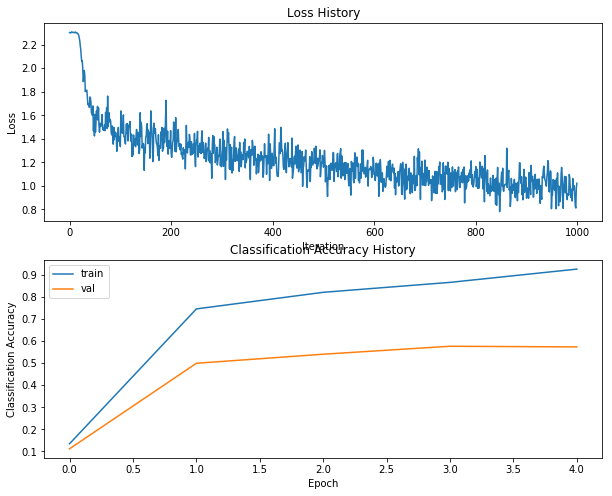



Training process took 5.530825s.
hs 700 lr 1.000000e+00 reg 1.000000e-04


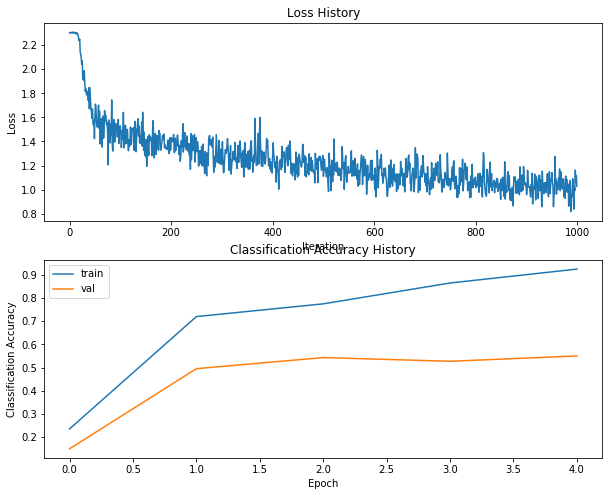



Training process took 5.660835s.
hs 700 lr 1.000000e+00 reg 5.000000e-04


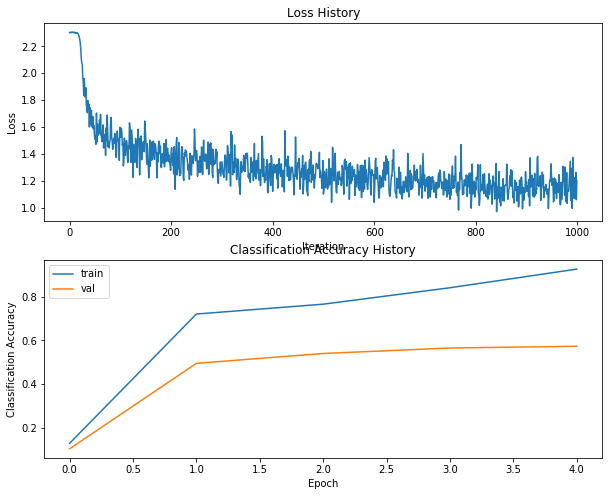



Training process took 5.749627s.
hs 700 lr 1.000000e+00 reg 1.000000e-03


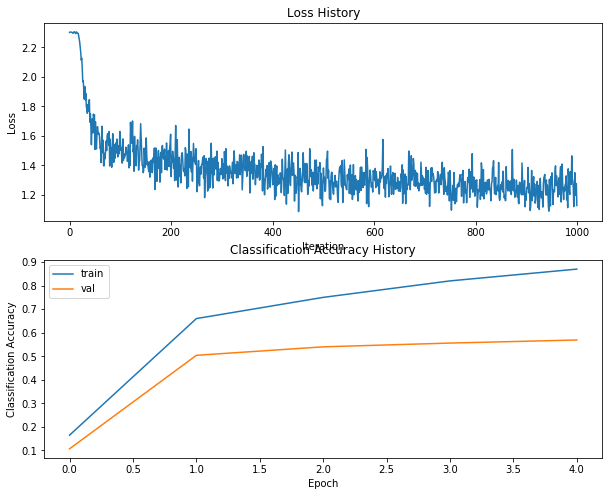



Training process took 5.725477s.
hs 700 lr 1.000000e+00 reg 5.000000e-03


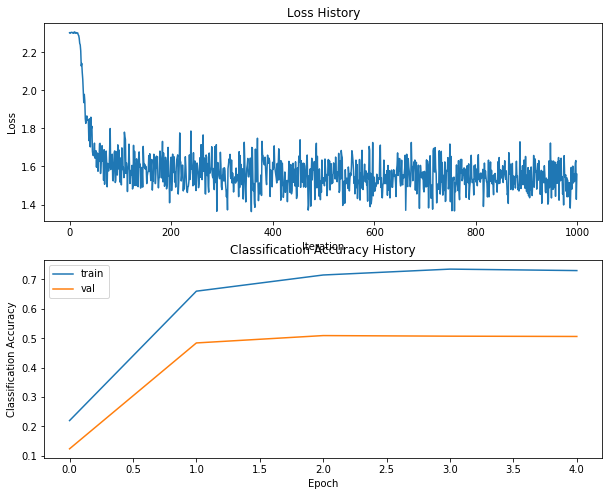



Training process took 5.883522s.
hs 700 lr 1.000000e+00 reg 1.000000e-02


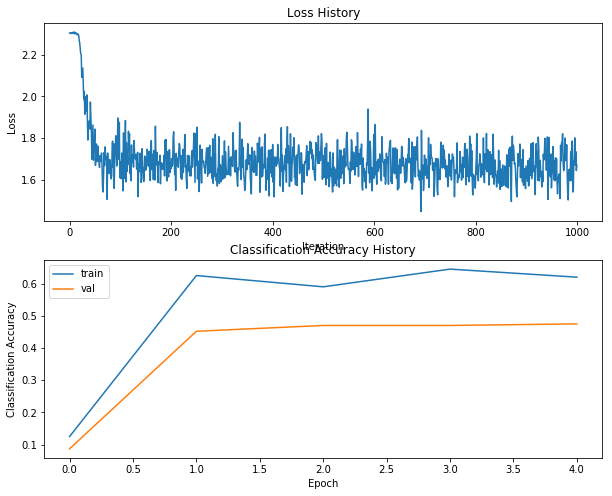



Training process took 6.046359s.
hs 700 lr 1.000000e+00 reg 1.000000e-01


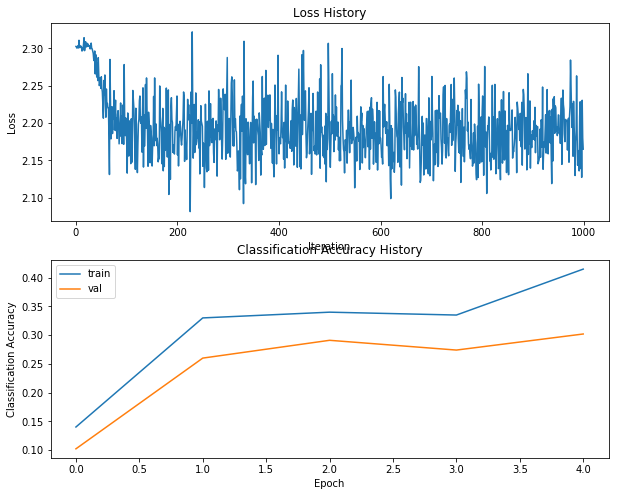



Training process took 5.990717s.
hs 700 lr 1.000000e+00 reg 1.000000e+00


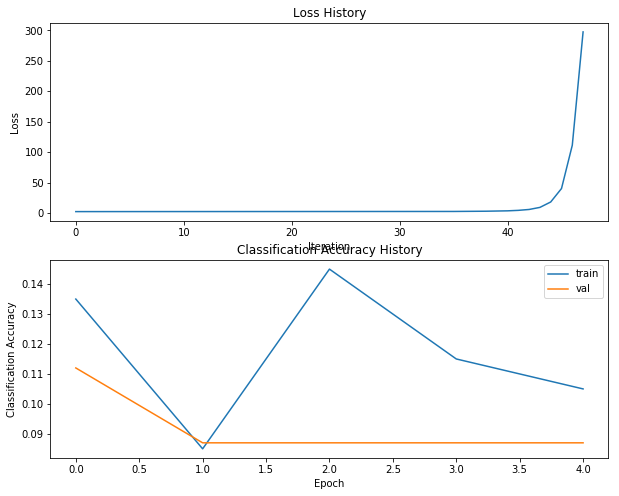



Training process took 5.620017s.
hs 700 lr 1.250000e+00 reg 1.000000e-05


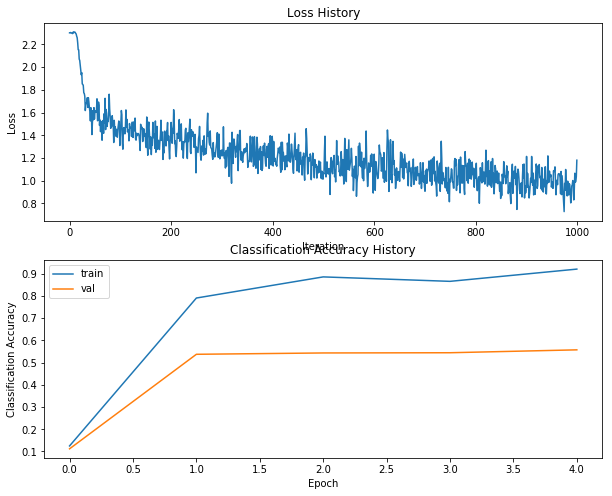



Training process took 5.732506s.
hs 700 lr 1.250000e+00 reg 1.000000e-04


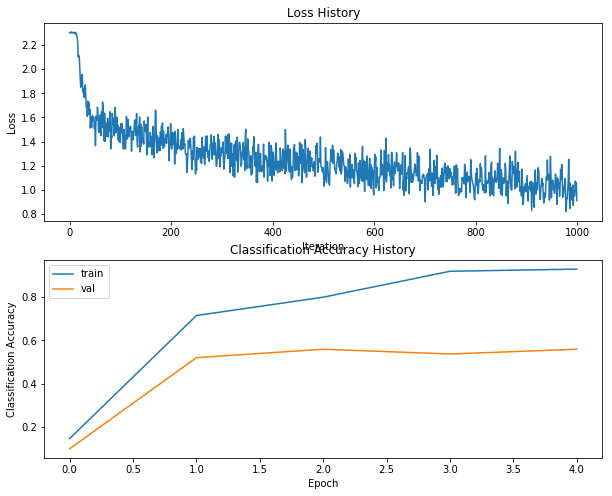



Training process took 6.061971s.
hs 700 lr 1.250000e+00 reg 5.000000e-04


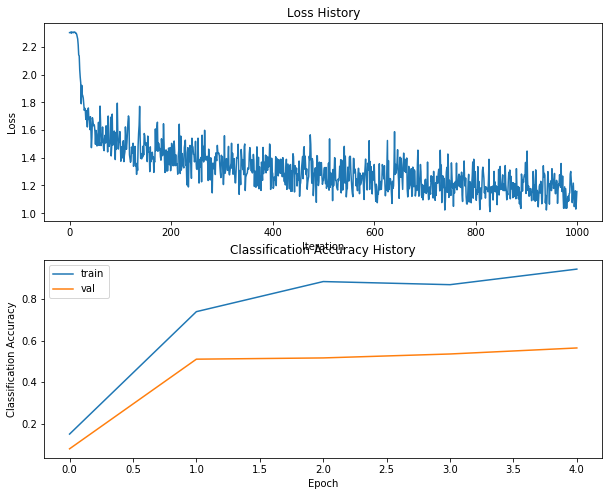



Training process took 5.215688s.
hs 700 lr 1.250000e+00 reg 1.000000e-03


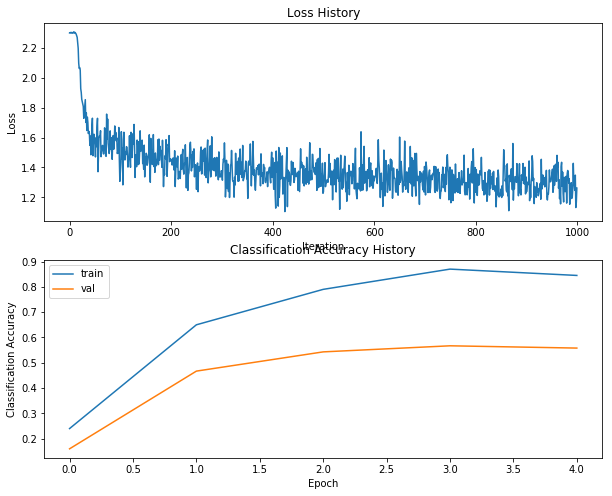



Training process took 5.341738s.
hs 700 lr 1.250000e+00 reg 5.000000e-03


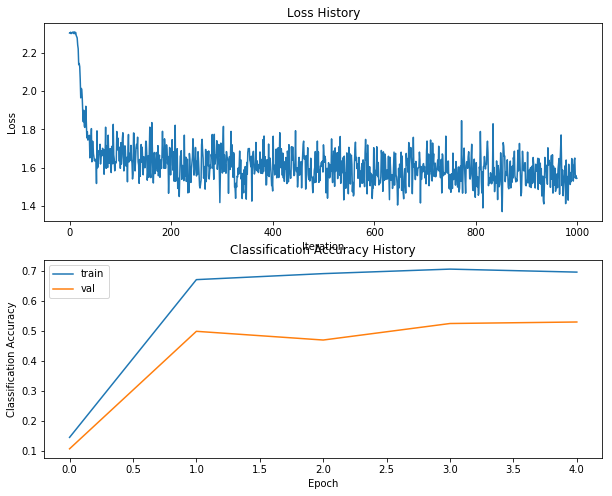



Training process took 1467.243985s.
hs 700 lr 1.250000e+00 reg 1.000000e-02


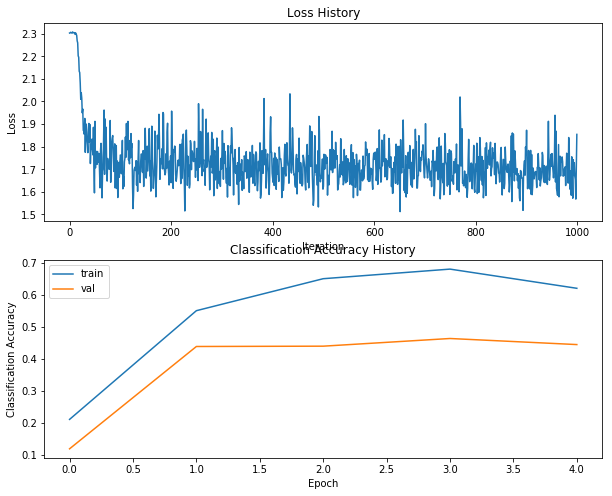



Training process took 5.513582s.
hs 700 lr 1.250000e+00 reg 1.000000e-01


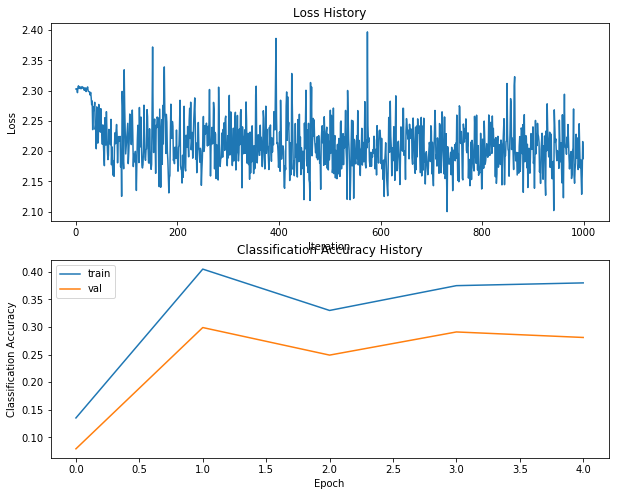



Training process took 6.685677s.
hs 700 lr 1.250000e+00 reg 1.000000e+00


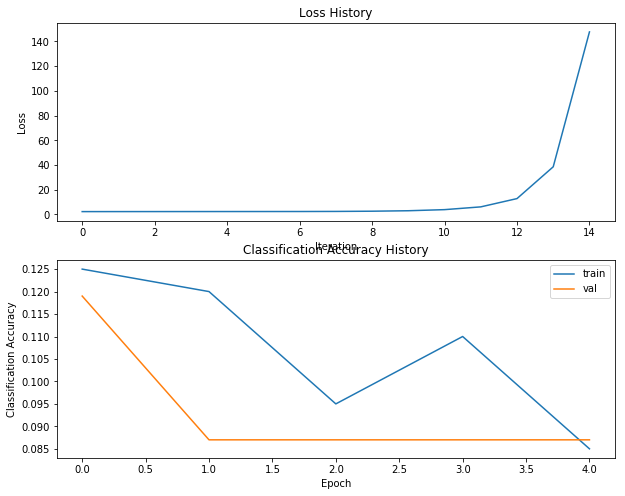



Training process took 7.263601s.
hs 700 lr 1.500000e+00 reg 1.000000e-05


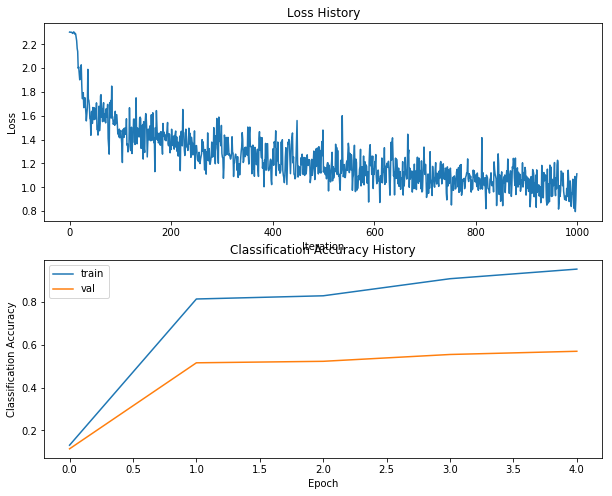



Training process took 7.190791s.
hs 700 lr 1.500000e+00 reg 1.000000e-04


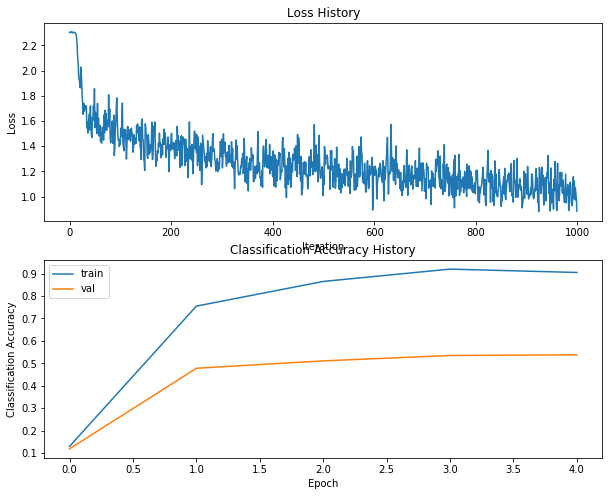



Training process took 7.100379s.
hs 700 lr 1.500000e+00 reg 5.000000e-04


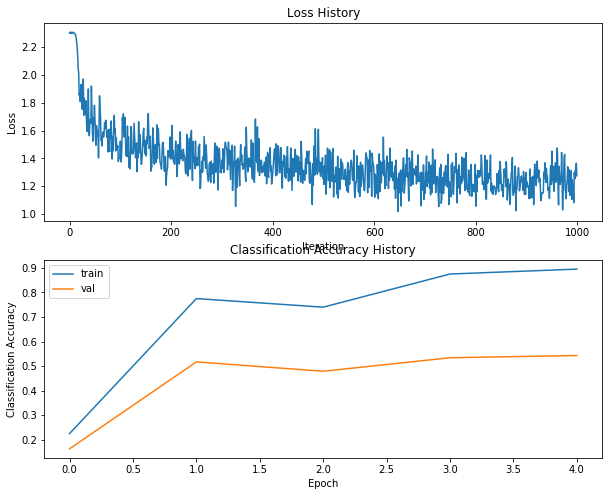



Training process took 294.689268s.
hs 700 lr 1.500000e+00 reg 1.000000e-03


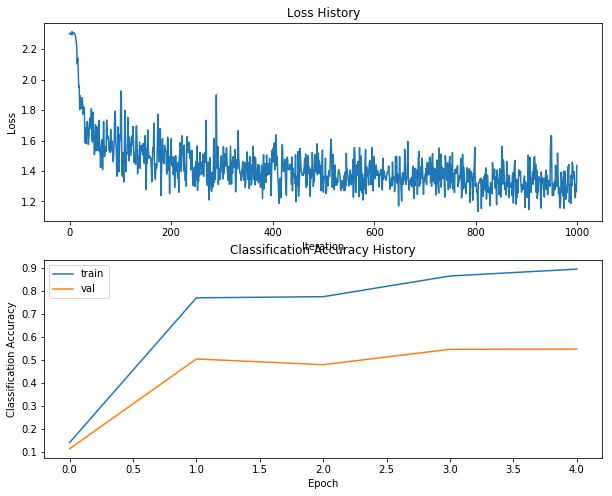



Training process took 5.567660s.
hs 700 lr 1.500000e+00 reg 5.000000e-03


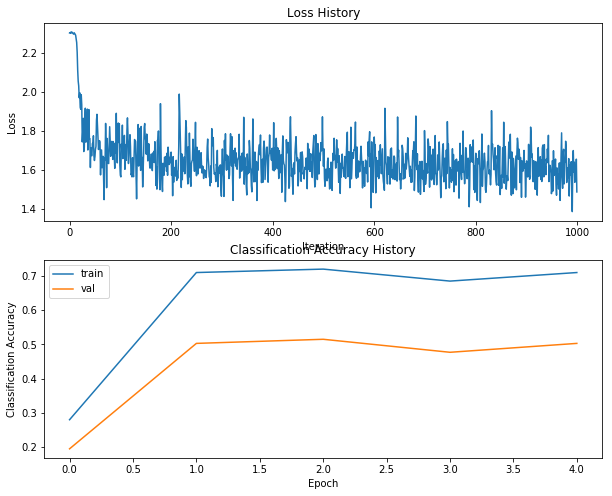



Training process took 6.048726s.
hs 700 lr 1.500000e+00 reg 1.000000e-02


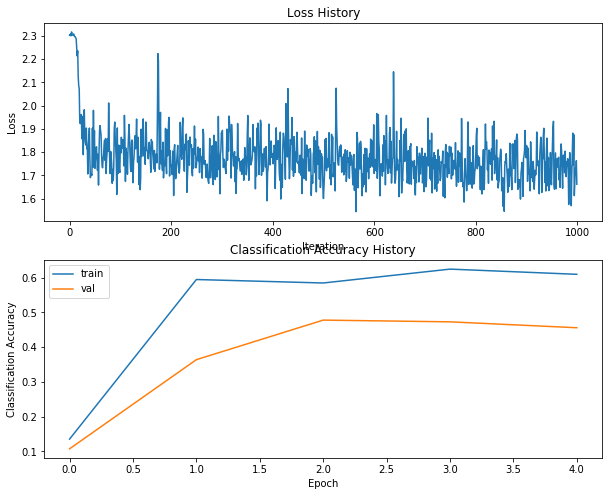



Training process took 7.768338s.
hs 700 lr 1.500000e+00 reg 1.000000e-01


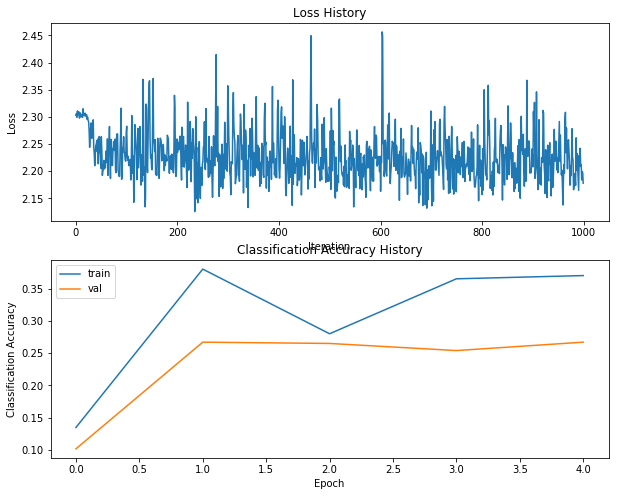



Training process took 7.581064s.
hs 700 lr 1.500000e+00 reg 1.000000e+00


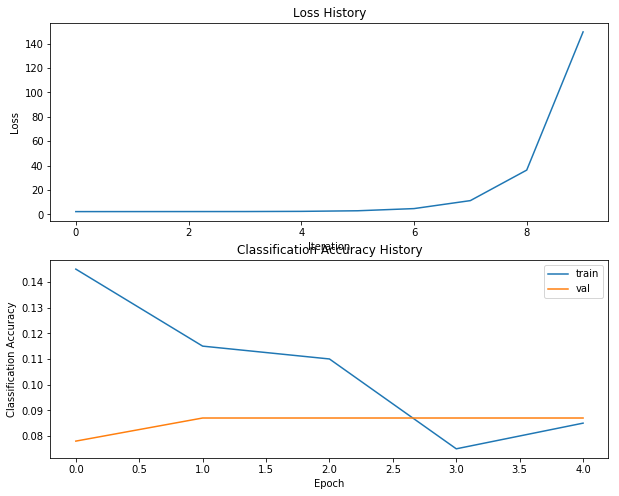



Training process took 6.805153s.
hs 700 lr 1.750000e+00 reg 1.000000e-05


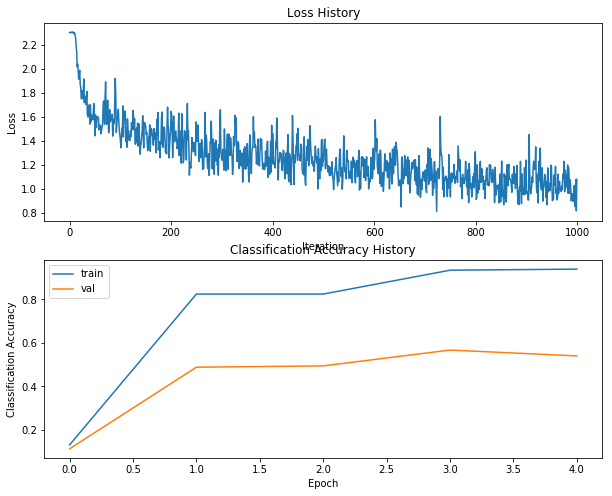



Training process took 7.038829s.
hs 700 lr 1.750000e+00 reg 1.000000e-04


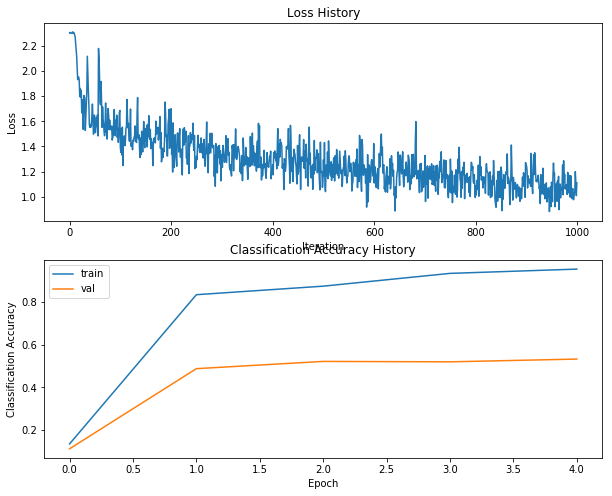



Training process took 7.433522s.
hs 700 lr 1.750000e+00 reg 5.000000e-04


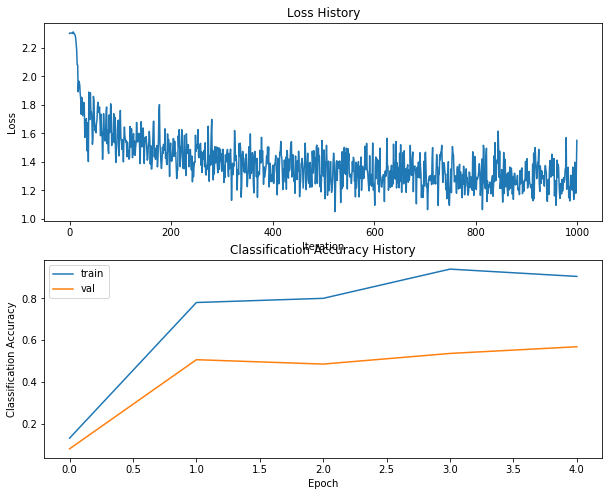



Training process took 7.186311s.
hs 700 lr 1.750000e+00 reg 1.000000e-03


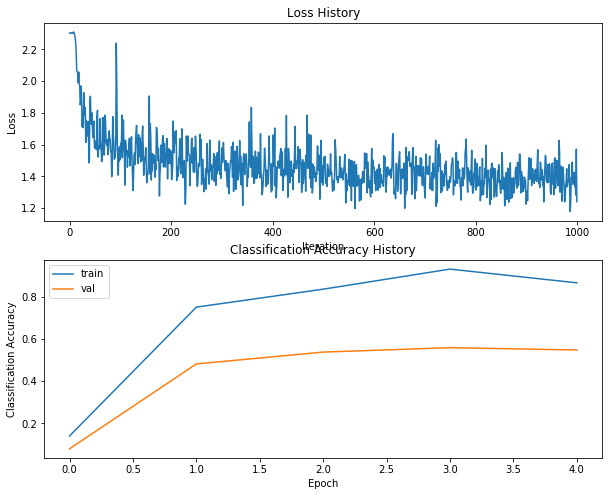



Training process took 7.684073s.
hs 700 lr 1.750000e+00 reg 5.000000e-03


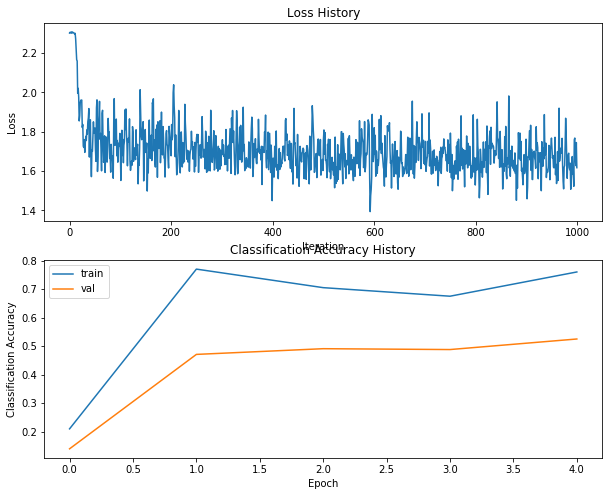



Training process took 7.415694s.
hs 700 lr 1.750000e+00 reg 1.000000e-02


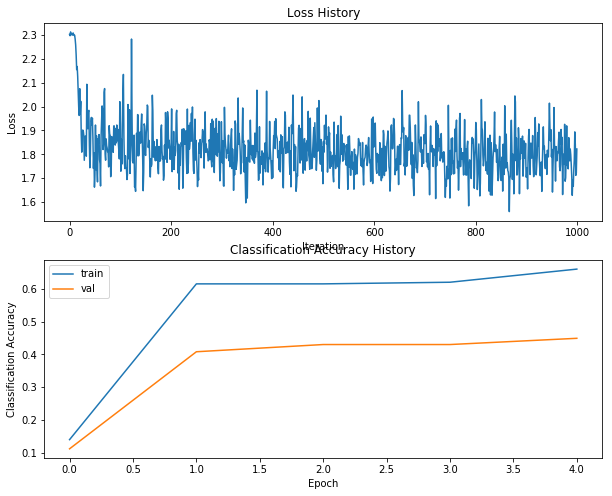



Training process took 6.930757s.
hs 700 lr 1.750000e+00 reg 1.000000e-01


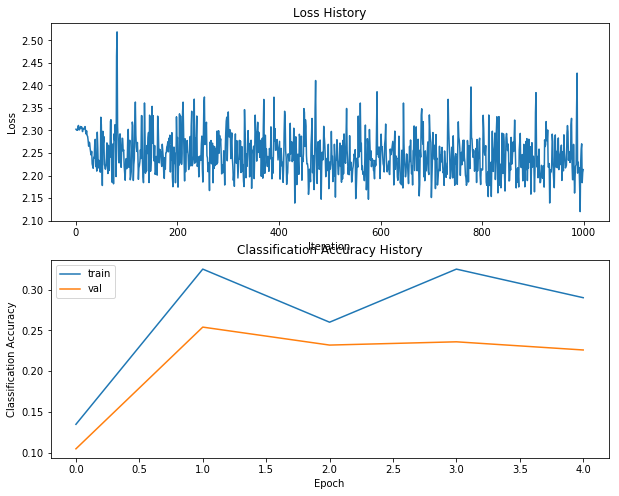



Training process took 7.599580s.
hs 700 lr 1.750000e+00 reg 1.000000e+00


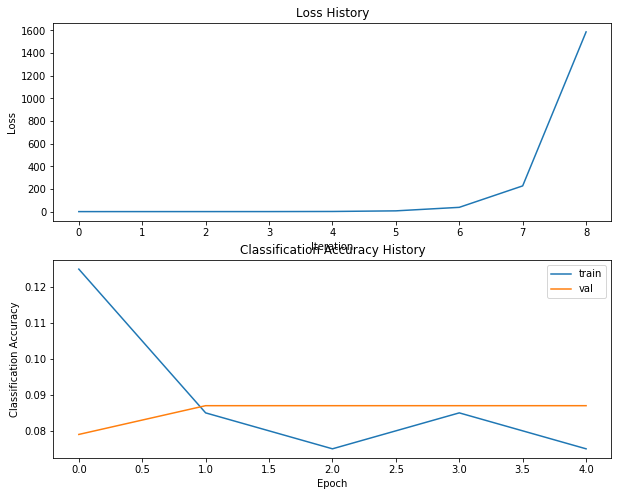



Training process took 6.883537s.
hs 700 lr 2.000000e+00 reg 1.000000e-05


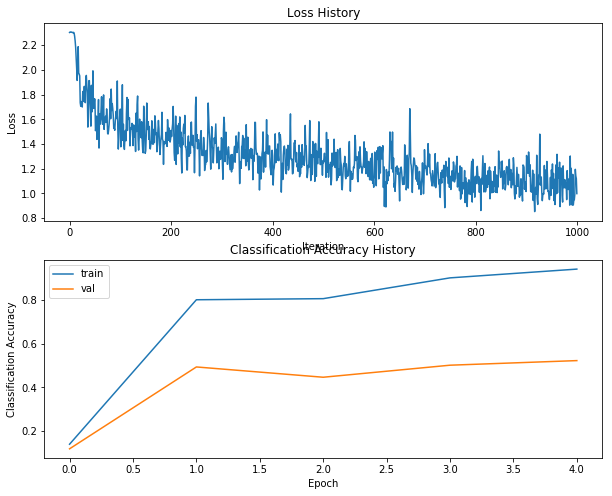



Training process took 7.042635s.
hs 700 lr 2.000000e+00 reg 1.000000e-04


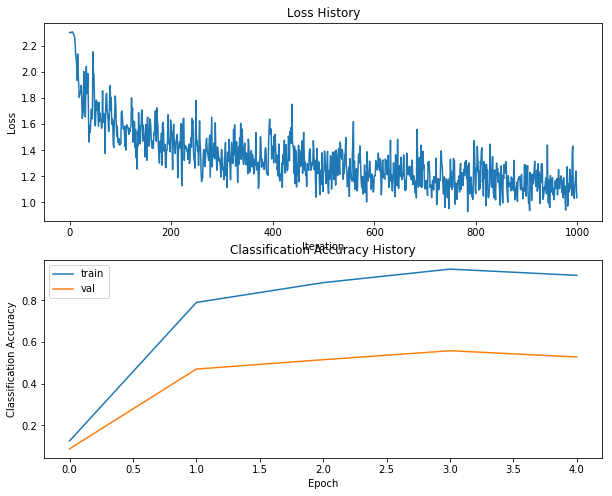



Training process took 7.197304s.
hs 700 lr 2.000000e+00 reg 5.000000e-04


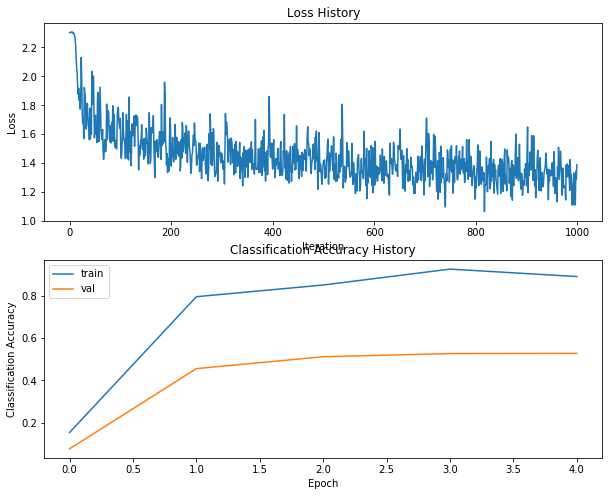



Training process took 8.171337s.
hs 700 lr 2.000000e+00 reg 1.000000e-03


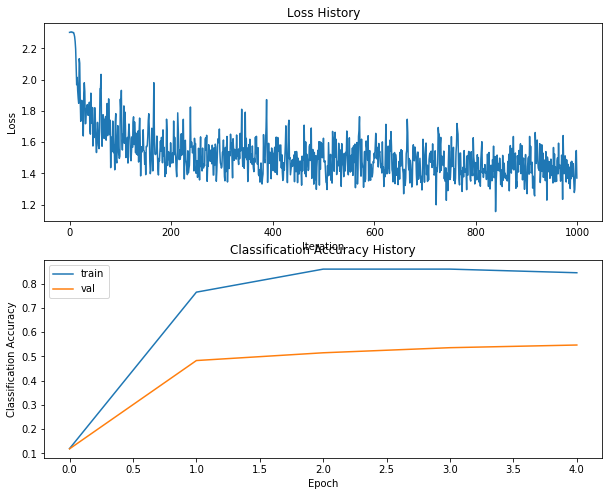



Training process took 7.815873s.
hs 700 lr 2.000000e+00 reg 5.000000e-03


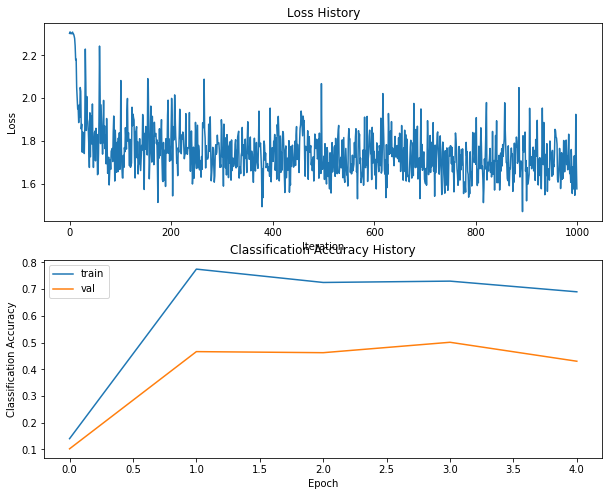



Training process took 7.733041s.
hs 700 lr 2.000000e+00 reg 1.000000e-02


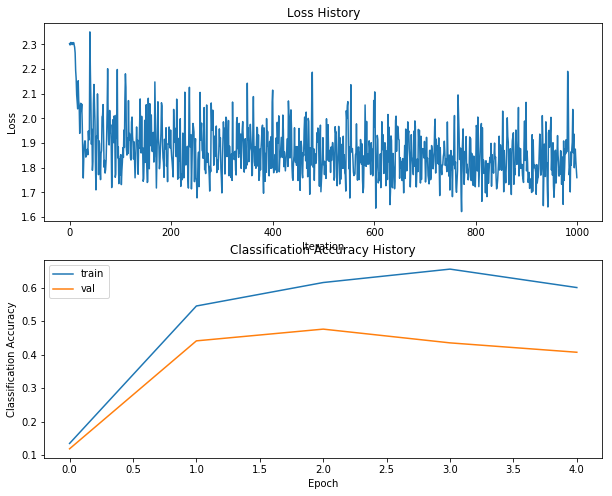



Training process took 7.256168s.
hs 700 lr 2.000000e+00 reg 1.000000e-01


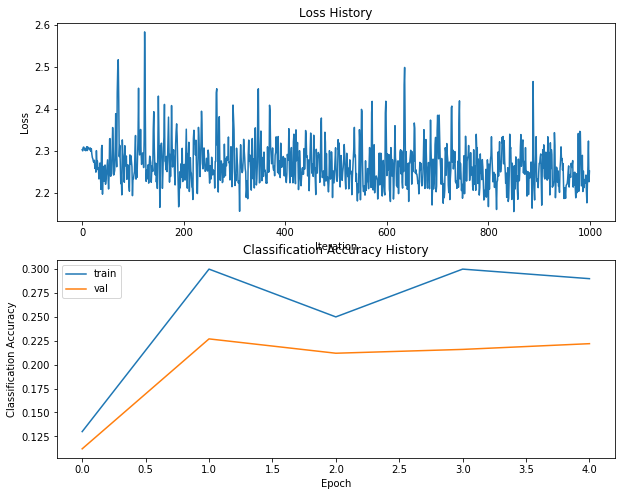



Training process took 8.143565s.
hs 700 lr 2.000000e+00 reg 1.000000e+00


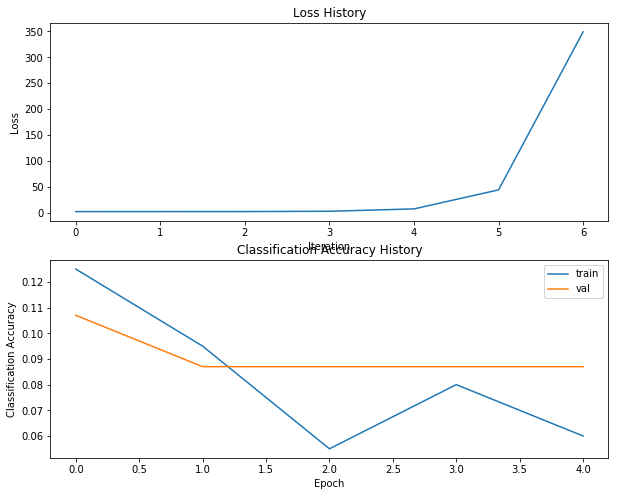



Training process took 6.876863s.
hs 700 lr 2.500000e+00 reg 1.000000e-05


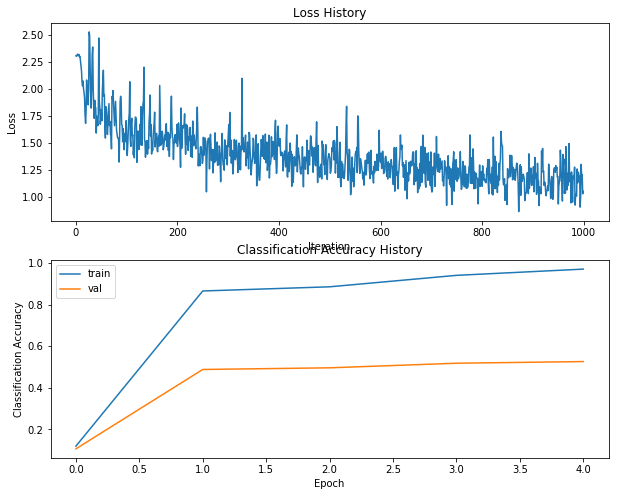



Training process took 7.066788s.
hs 700 lr 2.500000e+00 reg 1.000000e-04


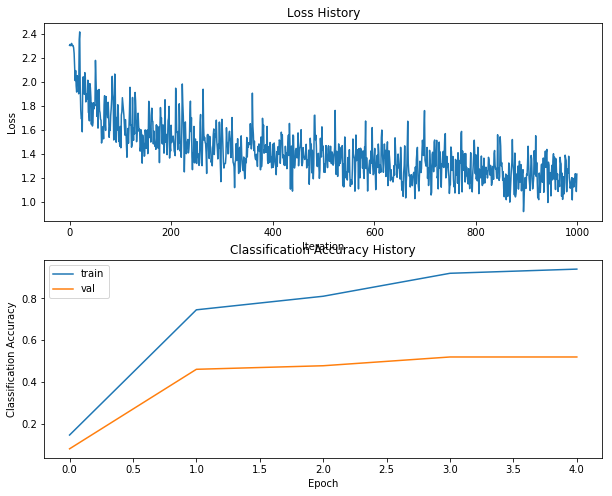



Training process took 7.024369s.
hs 700 lr 2.500000e+00 reg 5.000000e-04


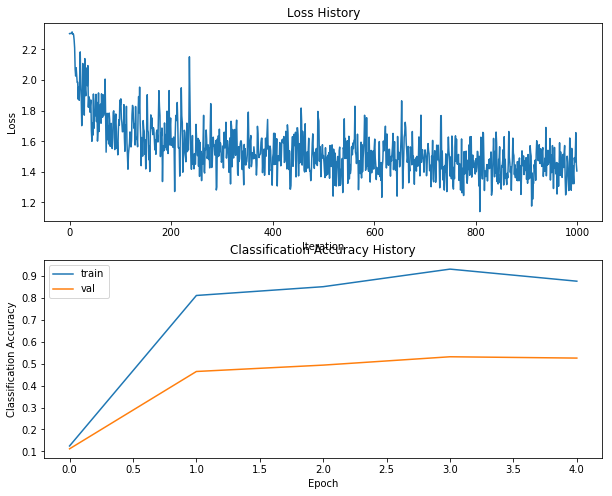



Training process took 7.038147s.
hs 700 lr 2.500000e+00 reg 1.000000e-03


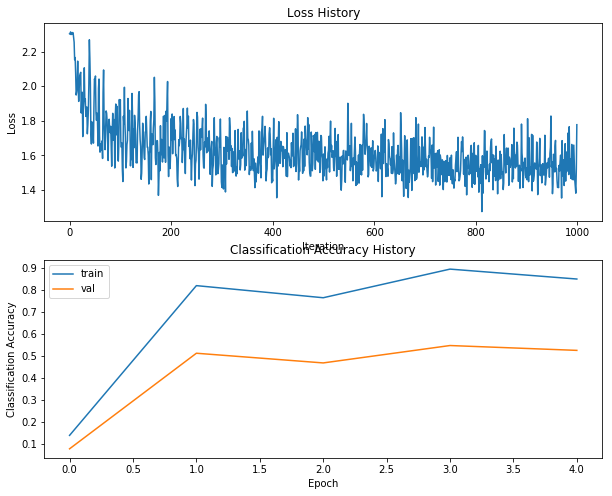



Training process took 7.569717s.
hs 700 lr 2.500000e+00 reg 5.000000e-03


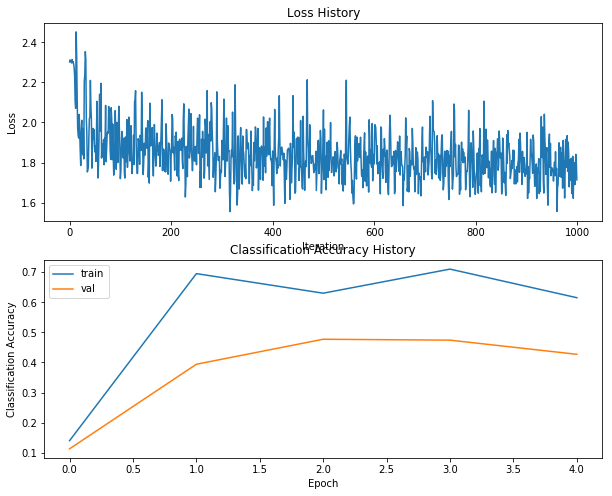



Training process took 7.226554s.
hs 700 lr 2.500000e+00 reg 1.000000e-02


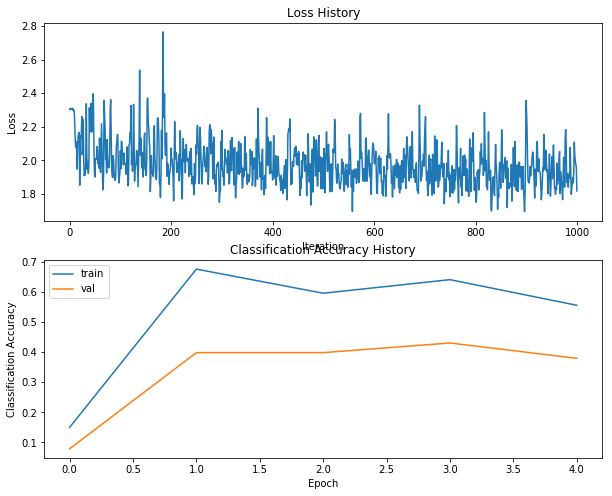



Training process took 6.968558s.
hs 700 lr 2.500000e+00 reg 1.000000e-01


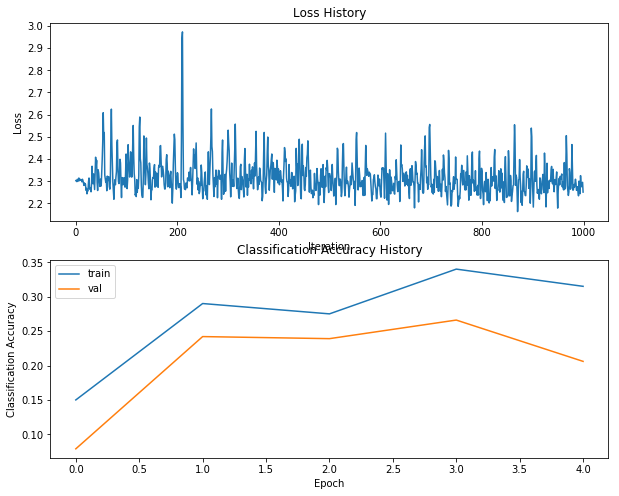



Training process took 7.721517s.
hs 700 lr 2.500000e+00 reg 1.000000e+00


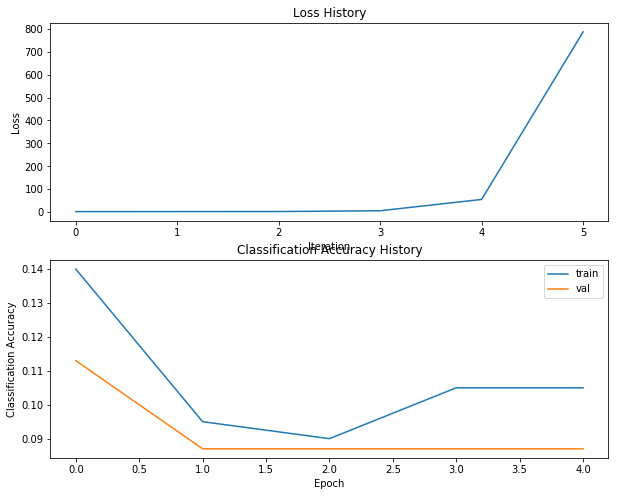



Training process took 9.697061s.
hs 800 lr 1.000000e-01 reg 1.000000e-05


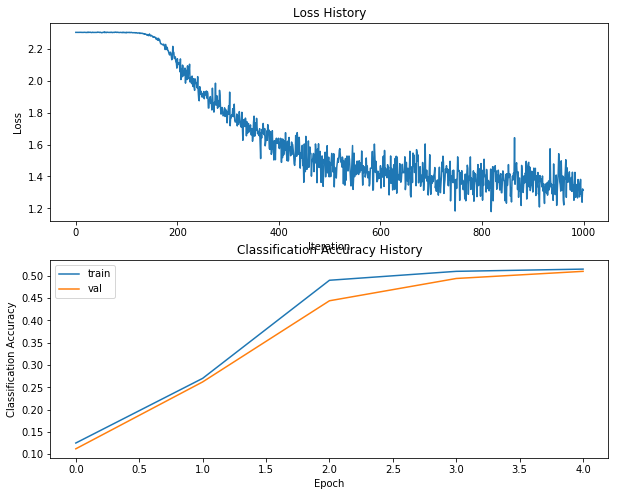



Training process took 9.285179s.
hs 800 lr 1.000000e-01 reg 1.000000e-04


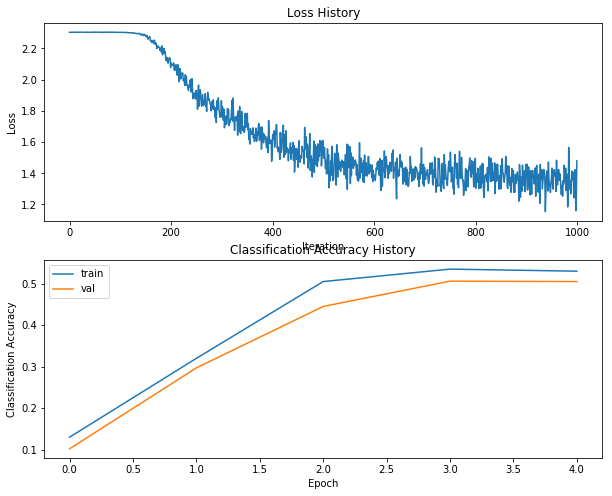



Training process took 8.695531s.
hs 800 lr 1.000000e-01 reg 5.000000e-04


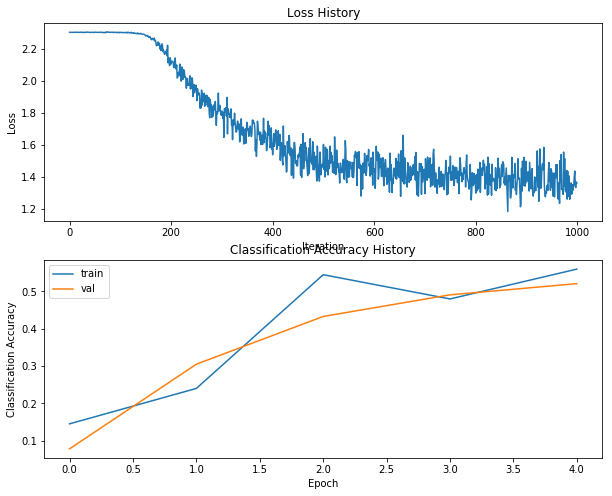



Training process took 8.505141s.
hs 800 lr 1.000000e-01 reg 1.000000e-03


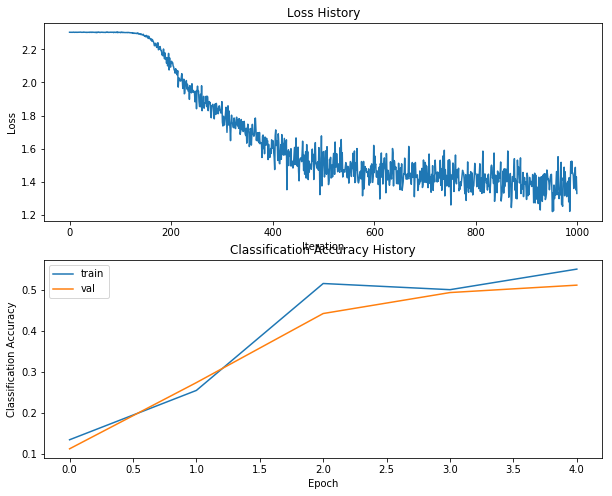



Training process took 8.459054s.
hs 800 lr 1.000000e-01 reg 5.000000e-03


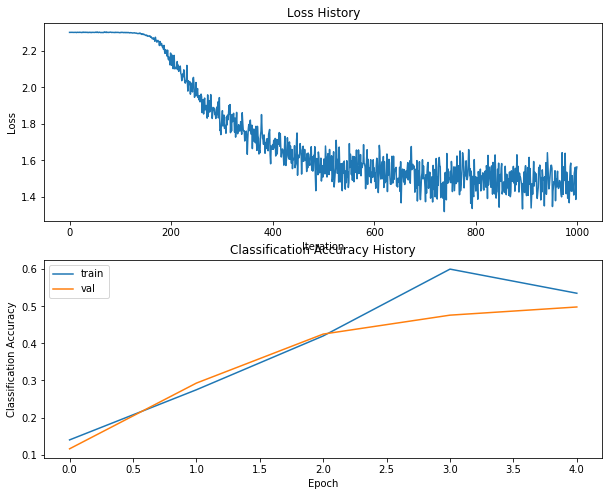



Training process took 8.236453s.
hs 800 lr 1.000000e-01 reg 1.000000e-02


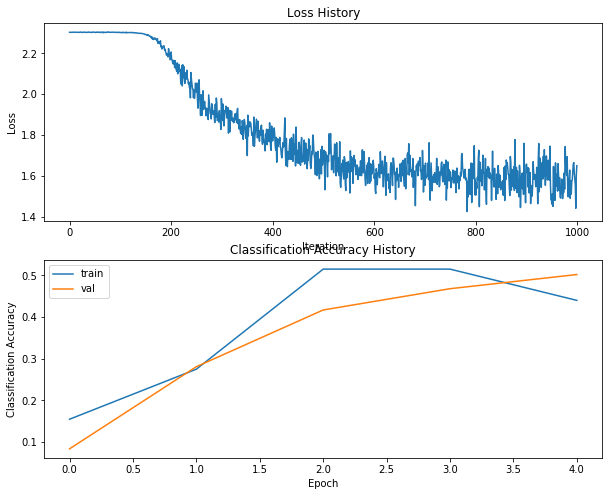



Training process took 7.899271s.
hs 800 lr 1.000000e-01 reg 1.000000e-01


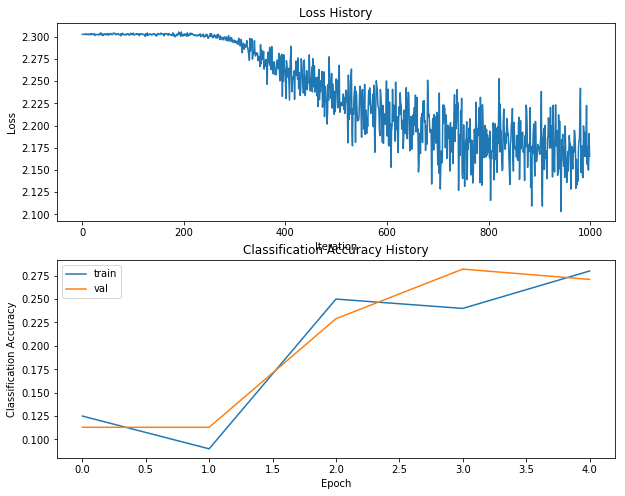



Training process took 7.725068s.
hs 800 lr 1.000000e-01 reg 1.000000e+00


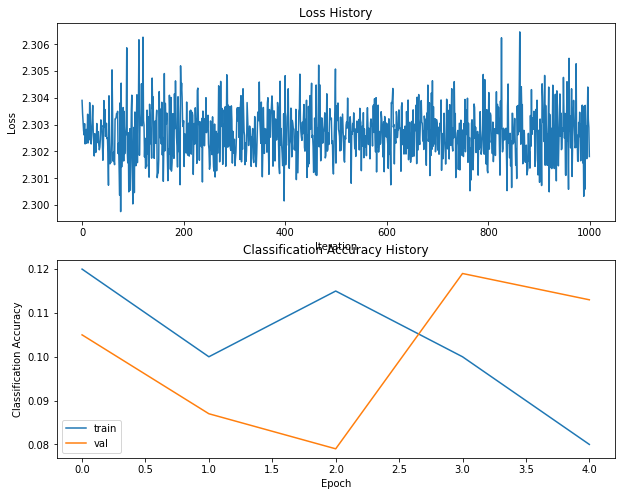



Training process took 8.647363s.
hs 800 lr 1.000000e+00 reg 1.000000e-05


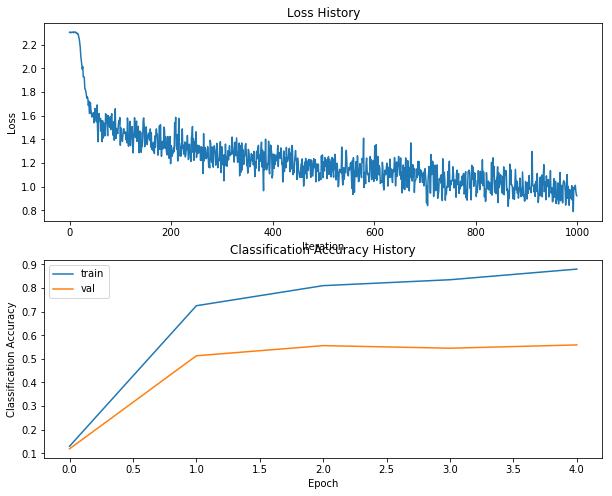



Training process took 8.790823s.
hs 800 lr 1.000000e+00 reg 1.000000e-04


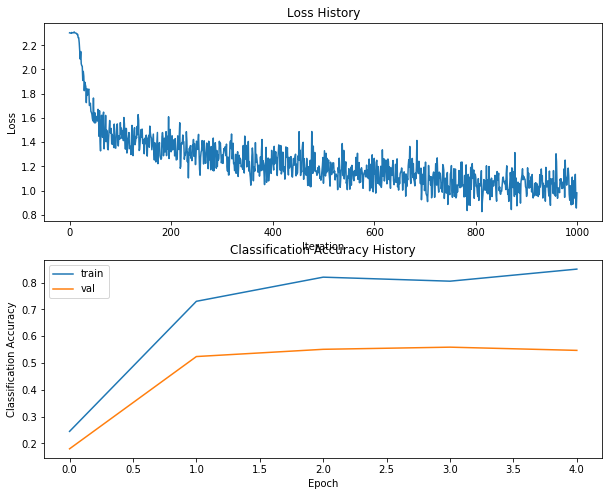



Training process took 8.657548s.
hs 800 lr 1.000000e+00 reg 5.000000e-04


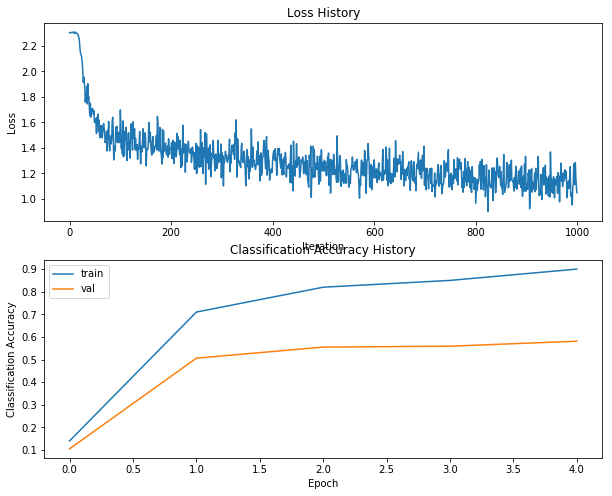



Training process took 15.329283s.
hs 800 lr 1.000000e+00 reg 1.000000e-03


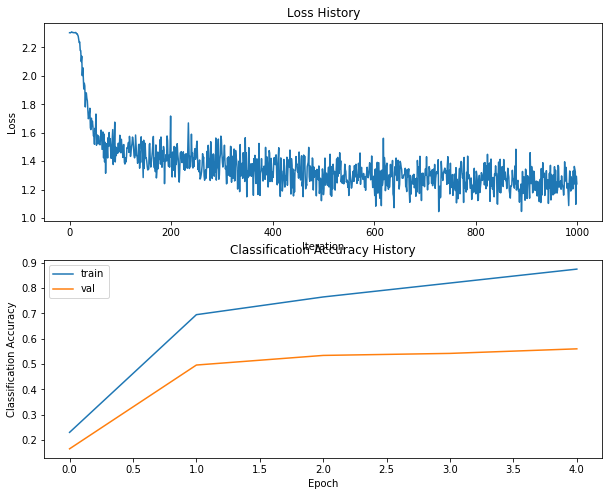



Training process took 42.833145s.
hs 800 lr 1.000000e+00 reg 5.000000e-03


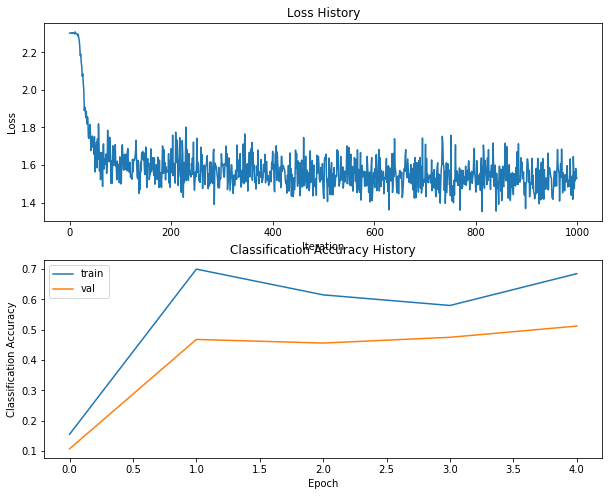



Training process took 36.240725s.
hs 800 lr 1.000000e+00 reg 1.000000e-02


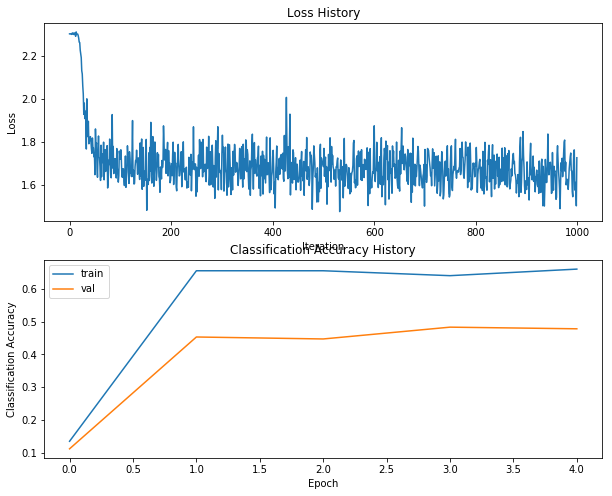



Training process took 38.336603s.
hs 800 lr 1.000000e+00 reg 1.000000e-01


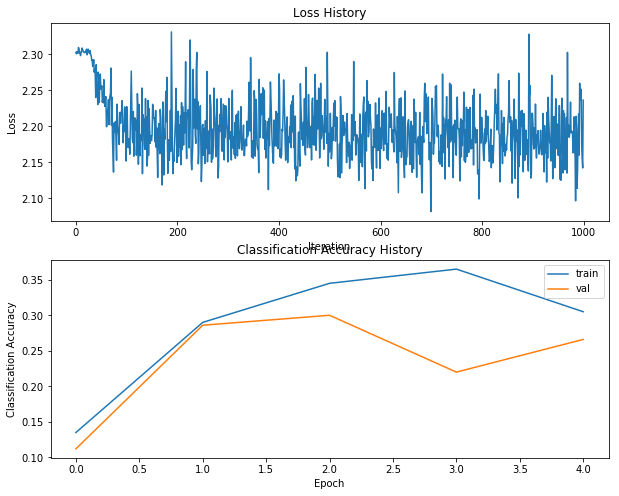



Training process took 37.565479s.
hs 800 lr 1.000000e+00 reg 1.000000e+00


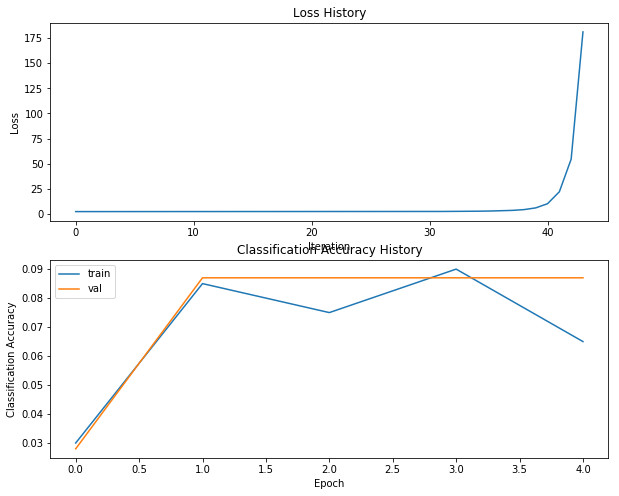



Training process took 38.579764s.
hs 800 lr 1.250000e+00 reg 1.000000e-05


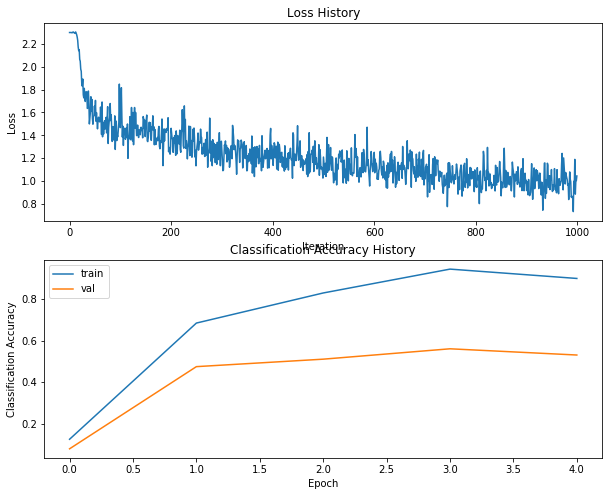



Training process took 39.589967s.
hs 800 lr 1.250000e+00 reg 1.000000e-04


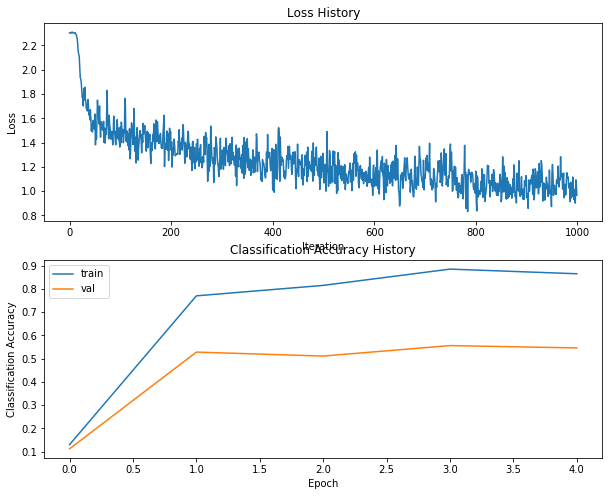



Training process took 35.710260s.
hs 800 lr 1.250000e+00 reg 5.000000e-04


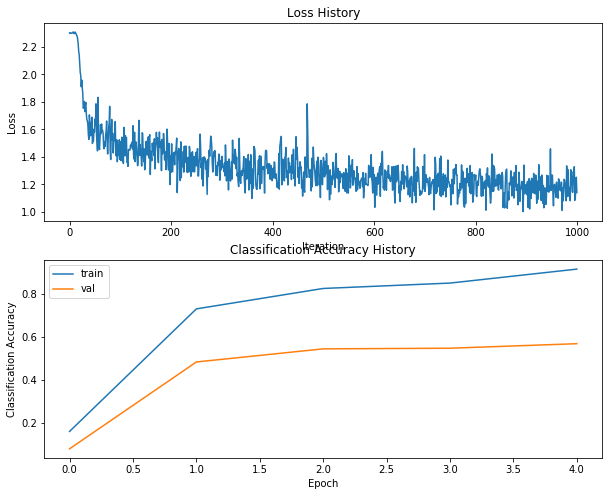



Training process took 40.094106s.
hs 800 lr 1.250000e+00 reg 1.000000e-03


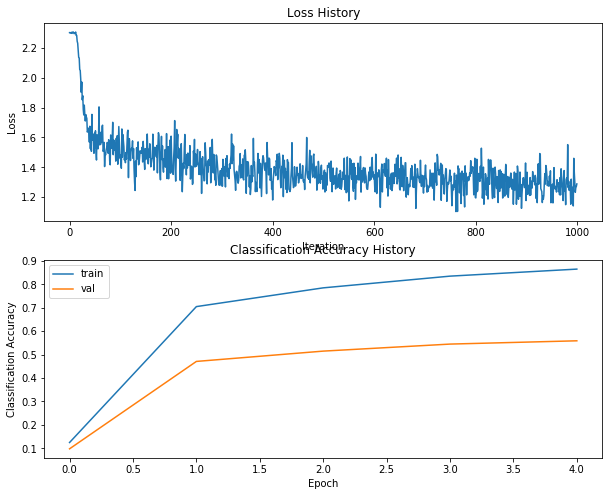



Training process took 37.586161s.
hs 800 lr 1.250000e+00 reg 5.000000e-03


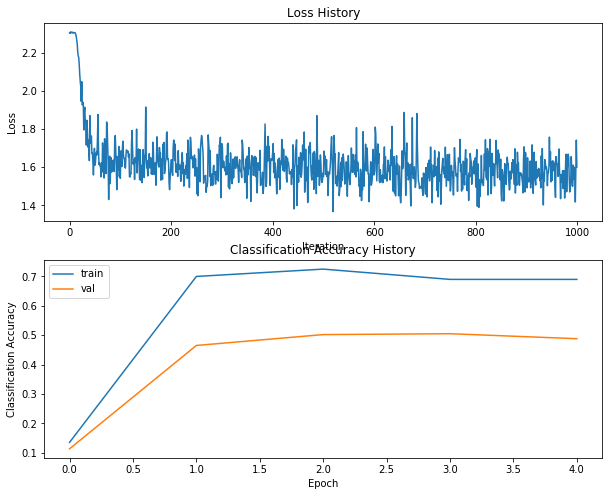



Training process took 36.574220s.
hs 800 lr 1.250000e+00 reg 1.000000e-02


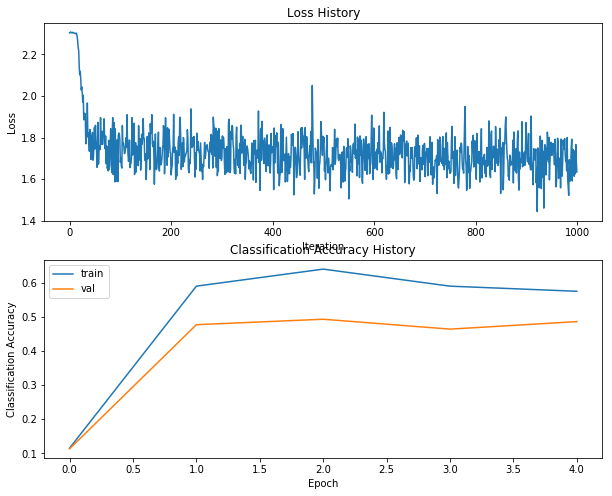



Training process took 39.193901s.
hs 800 lr 1.250000e+00 reg 1.000000e-01


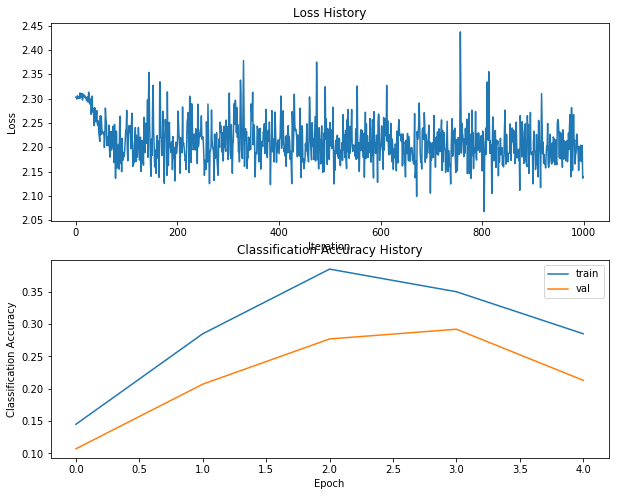



Training process took 39.048763s.
hs 800 lr 1.250000e+00 reg 1.000000e+00


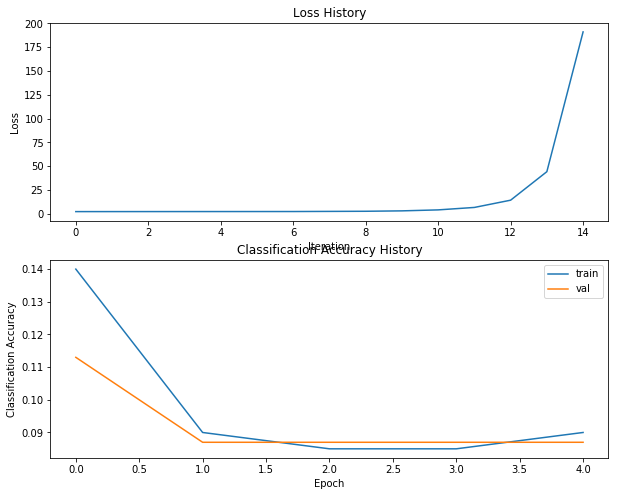



Training process took 39.087252s.
hs 800 lr 1.500000e+00 reg 1.000000e-05


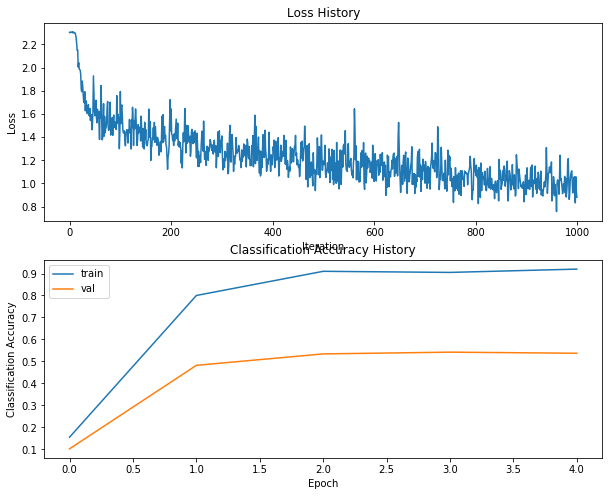



Training process took 40.072949s.
hs 800 lr 1.500000e+00 reg 1.000000e-04


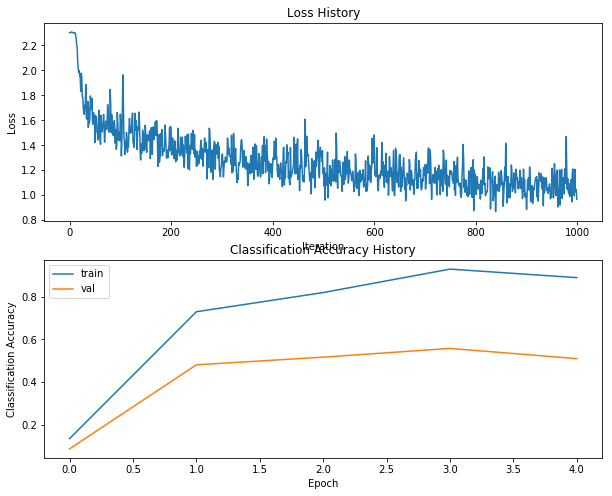



Training process took 36.308290s.
hs 800 lr 1.500000e+00 reg 5.000000e-04


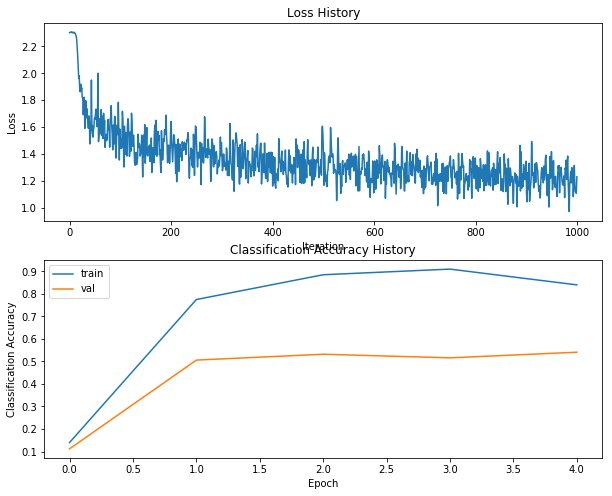



Training process took 40.177984s.
hs 800 lr 1.500000e+00 reg 1.000000e-03


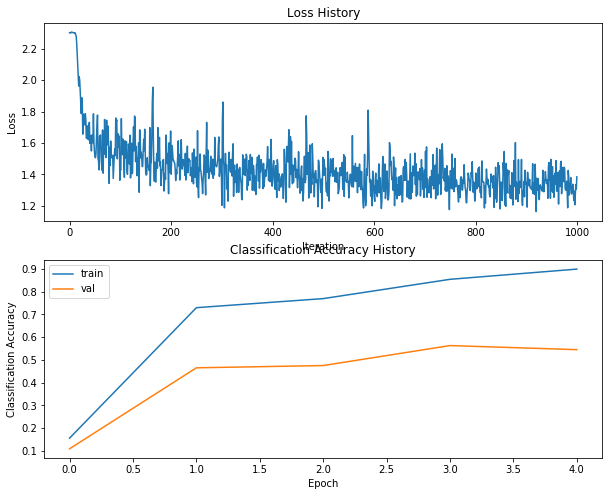



Training process took 35.806444s.
hs 800 lr 1.500000e+00 reg 5.000000e-03


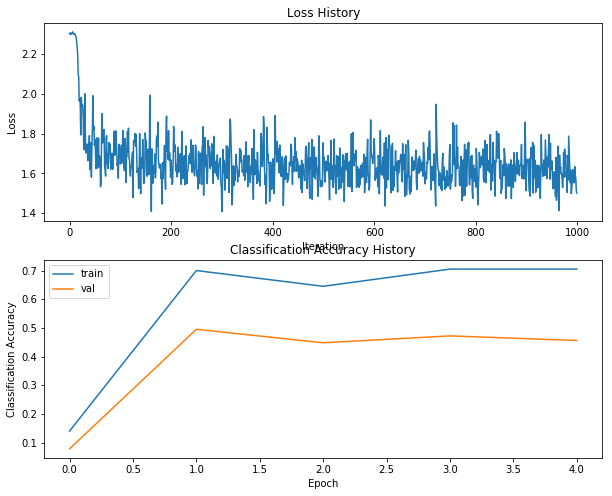



Training process took 46.681836s.
hs 800 lr 1.500000e+00 reg 1.000000e-02


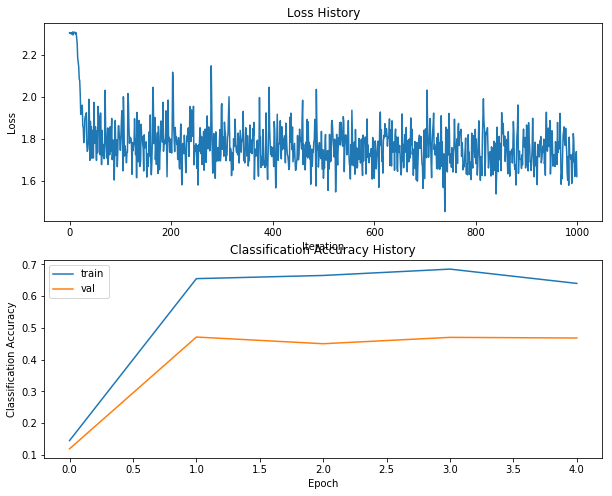



Training process took 45.704910s.
hs 800 lr 1.500000e+00 reg 1.000000e-01


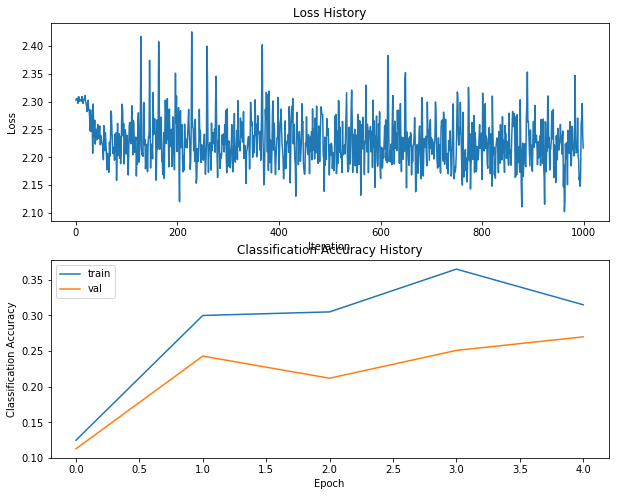



Training process took 50.006533s.
hs 800 lr 1.500000e+00 reg 1.000000e+00


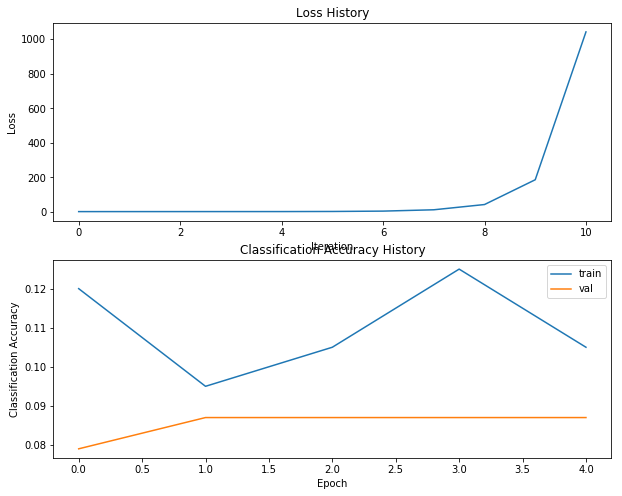



Training process took 38.839764s.
hs 800 lr 1.750000e+00 reg 1.000000e-05


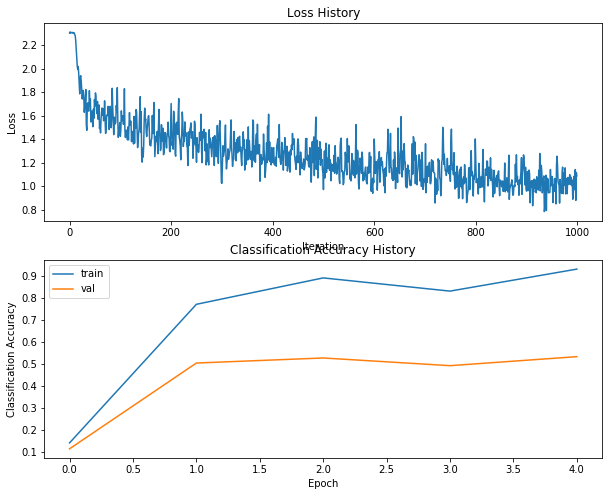



Training process took 37.215189s.
hs 800 lr 1.750000e+00 reg 1.000000e-04


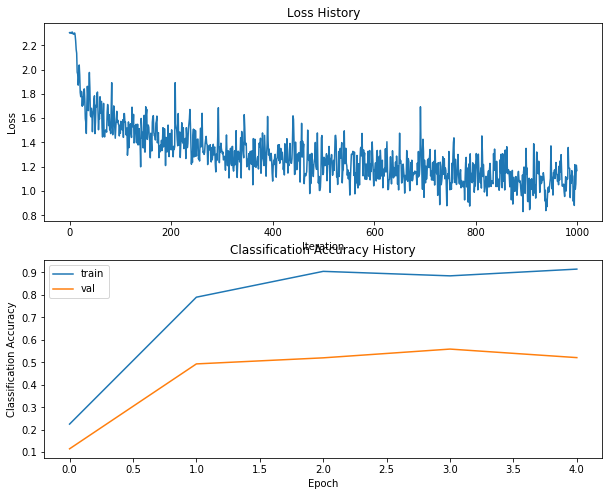



Training process took 39.736552s.
hs 800 lr 1.750000e+00 reg 5.000000e-04


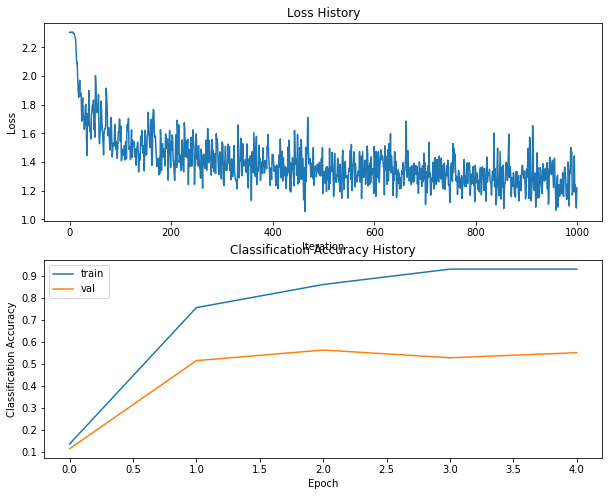



Training process took 35.489776s.
hs 800 lr 1.750000e+00 reg 1.000000e-03


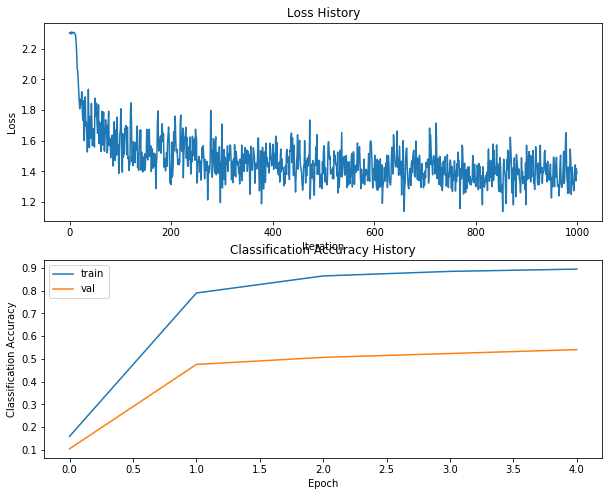



Training process took 36.434303s.
hs 800 lr 1.750000e+00 reg 5.000000e-03


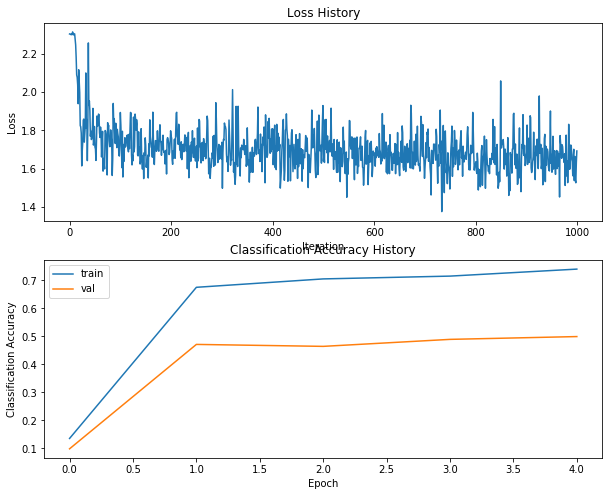



Training process took 48.569657s.
hs 800 lr 1.750000e+00 reg 1.000000e-02


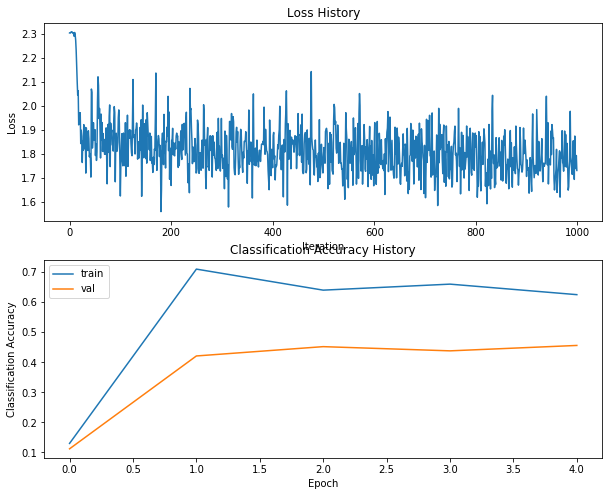



Training process took 34.019810s.
hs 800 lr 1.750000e+00 reg 1.000000e-01


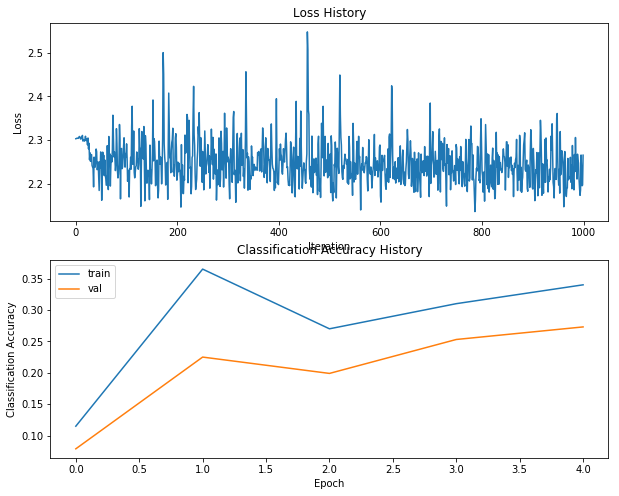



Training process took 38.942441s.
hs 800 lr 1.750000e+00 reg 1.000000e+00


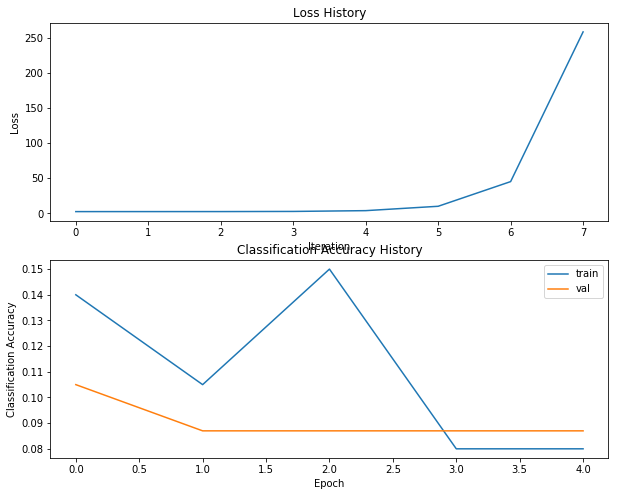



Training process took 40.684001s.
hs 800 lr 2.000000e+00 reg 1.000000e-05


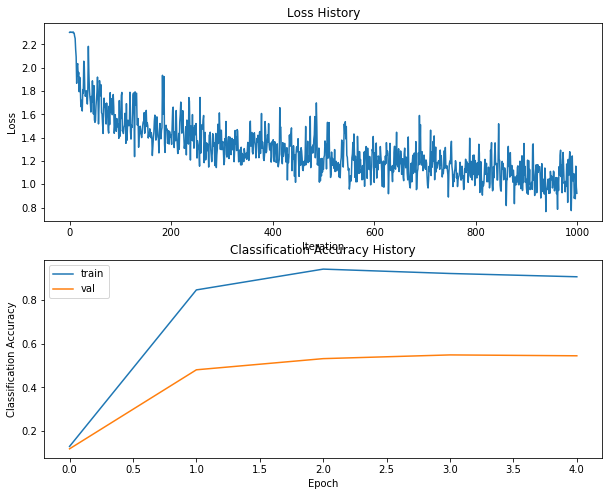



Training process took 35.475876s.
hs 800 lr 2.000000e+00 reg 1.000000e-04


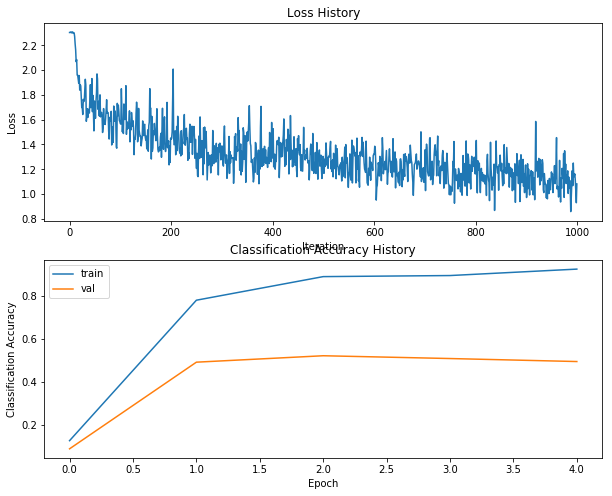



Training process took 19.888164s.
hs 800 lr 2.000000e+00 reg 5.000000e-04


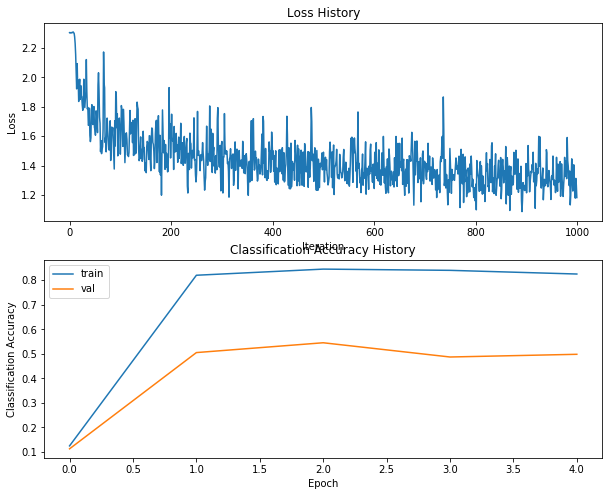



Training process took 13.887044s.
hs 800 lr 2.000000e+00 reg 1.000000e-03


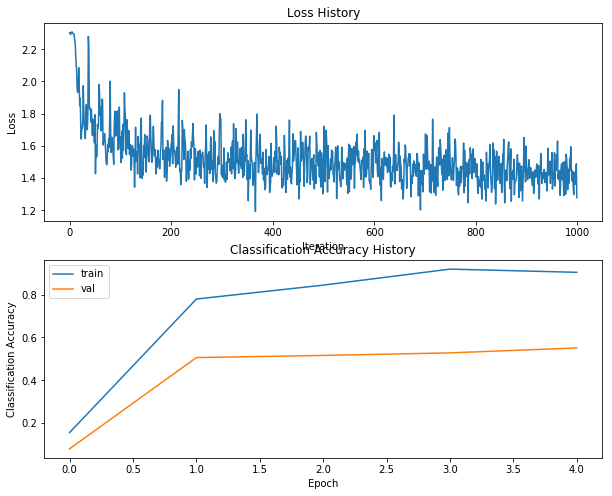



Training process took 9.077153s.
hs 800 lr 2.000000e+00 reg 5.000000e-03


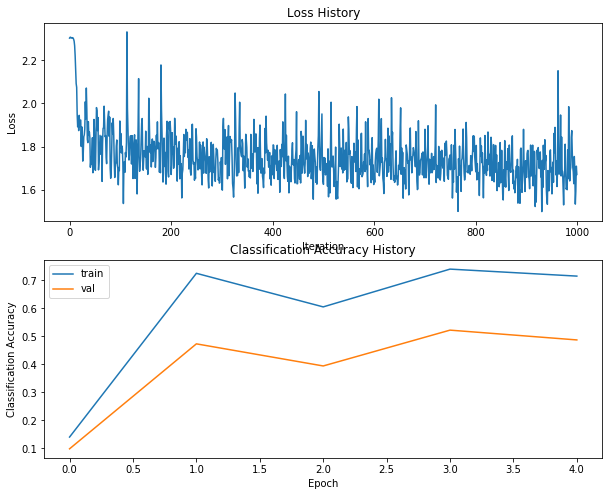



Training process took 6.644881s.
hs 800 lr 2.000000e+00 reg 1.000000e-02


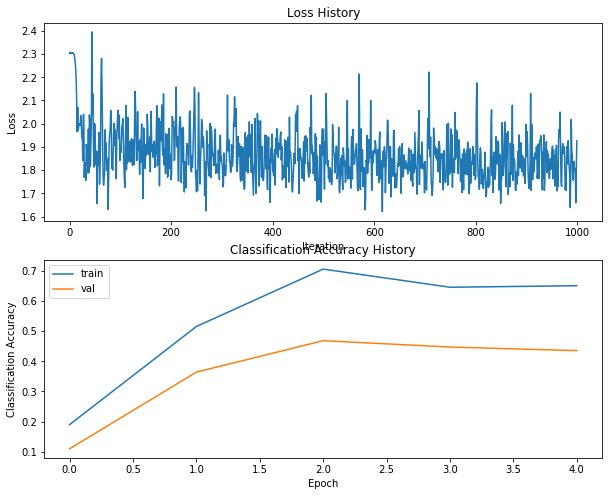



Training process took 6.762531s.
hs 800 lr 2.000000e+00 reg 1.000000e-01


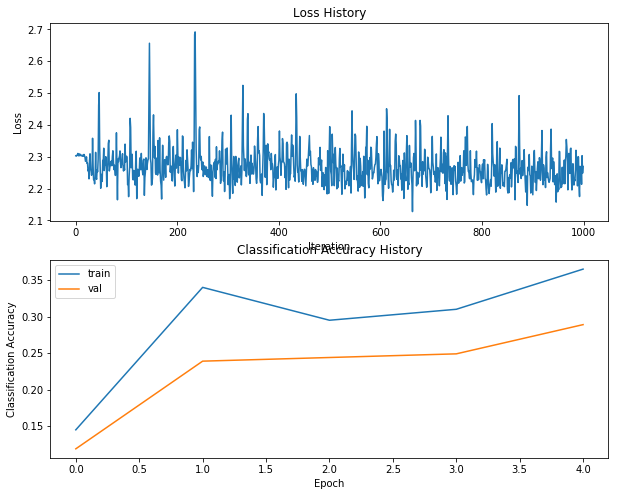



Training process took 6.837191s.
hs 800 lr 2.000000e+00 reg 1.000000e+00


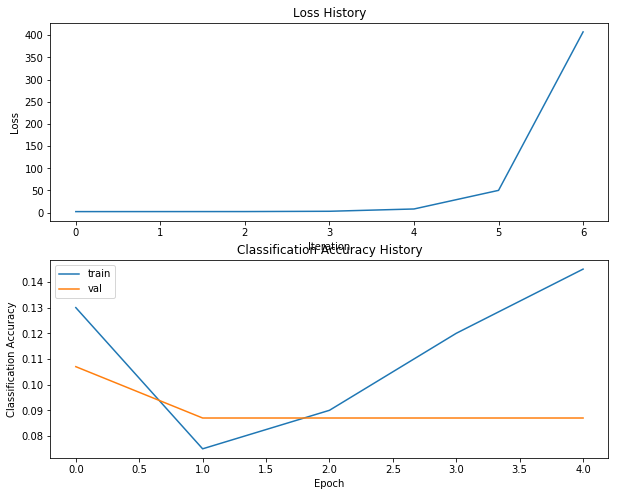



Training process took 6.138353s.
hs 800 lr 2.500000e+00 reg 1.000000e-05


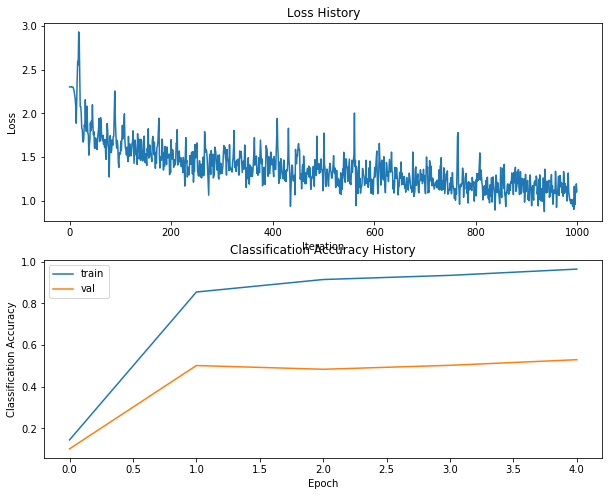



Training process took 6.425896s.
hs 800 lr 2.500000e+00 reg 1.000000e-04


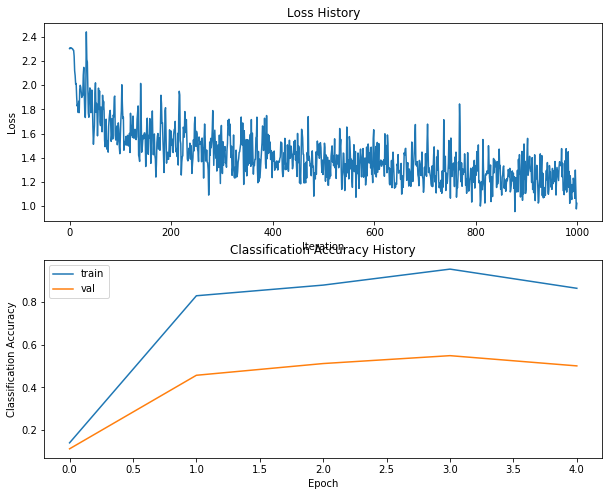



Training process took 6.625535s.
hs 800 lr 2.500000e+00 reg 5.000000e-04


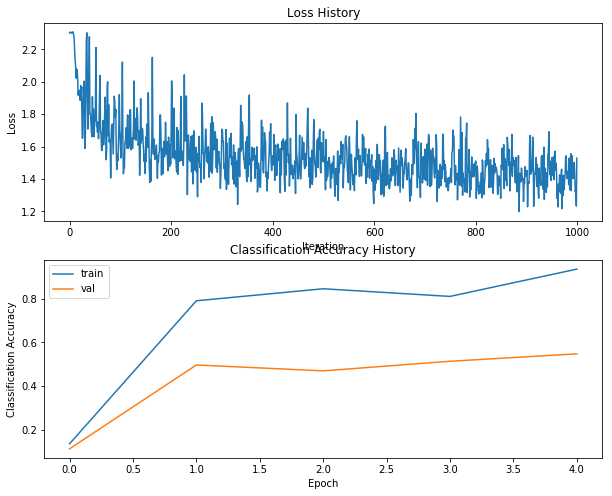



Training process took 6.549613s.
hs 800 lr 2.500000e+00 reg 1.000000e-03


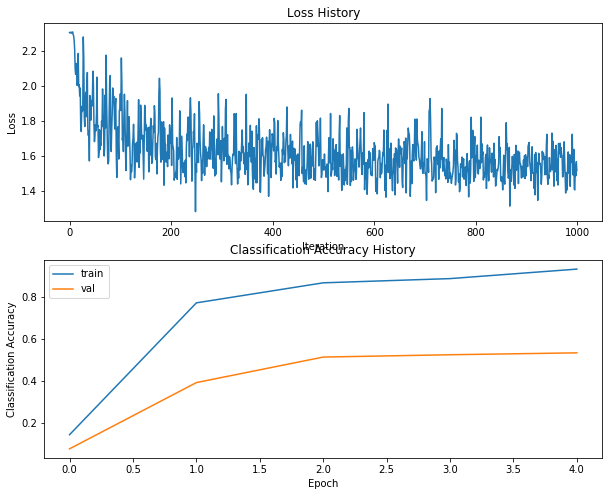



Training process took 6.431318s.
hs 800 lr 2.500000e+00 reg 5.000000e-03


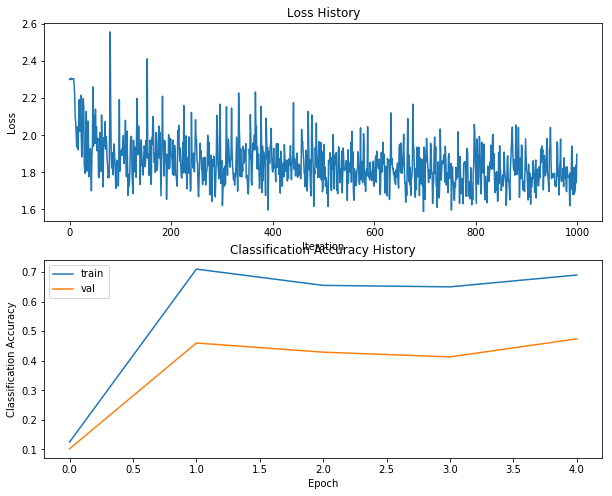



Training process took 6.624582s.
hs 800 lr 2.500000e+00 reg 1.000000e-02


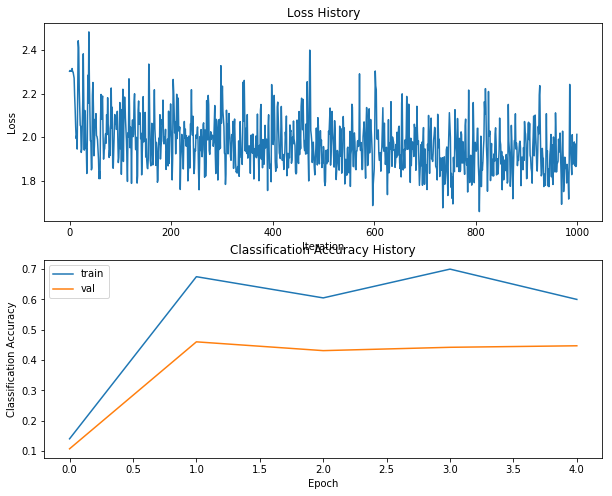



Training process took 6.154731s.
hs 800 lr 2.500000e+00 reg 1.000000e-01


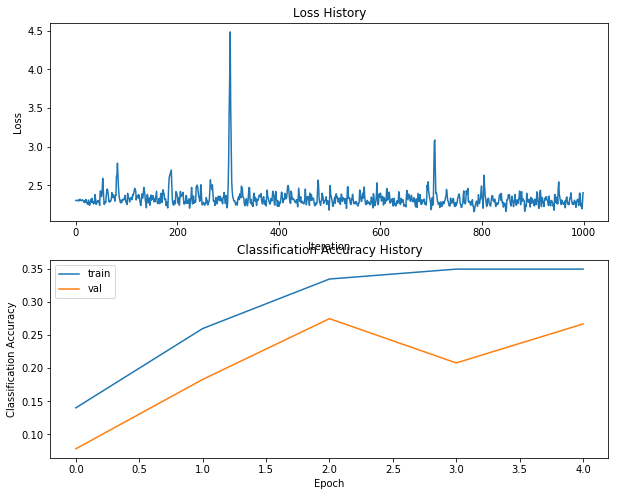



Training process took 6.361923s.
hs 800 lr 2.500000e+00 reg 1.000000e+00


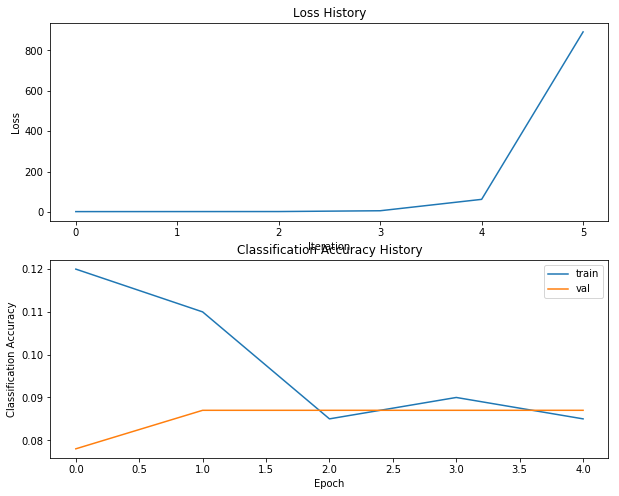



Training process took 7.769903s.
hs 900 lr 1.000000e-01 reg 1.000000e-05


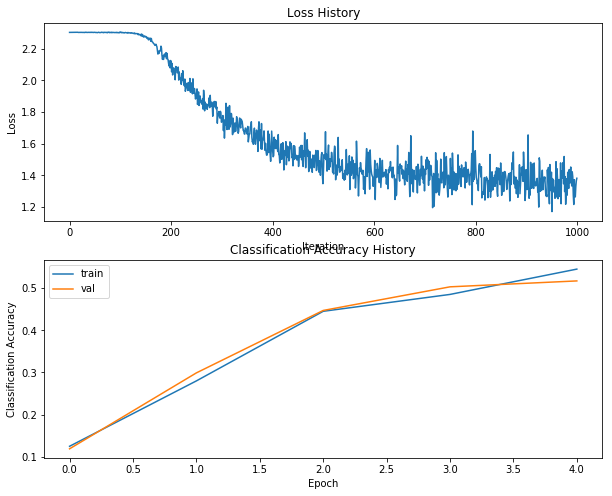



Training process took 7.258537s.
hs 900 lr 1.000000e-01 reg 1.000000e-04


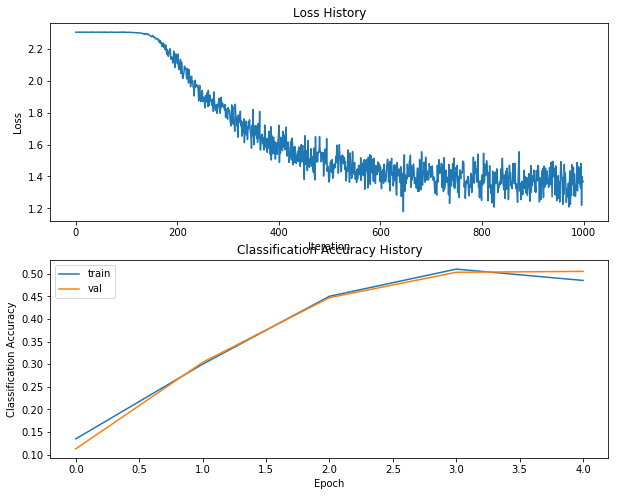



Training process took 7.428987s.
hs 900 lr 1.000000e-01 reg 5.000000e-04


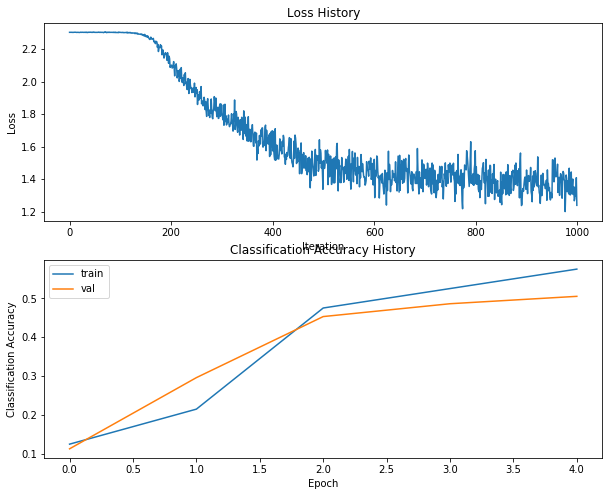



Training process took 7.523161s.
hs 900 lr 1.000000e-01 reg 1.000000e-03


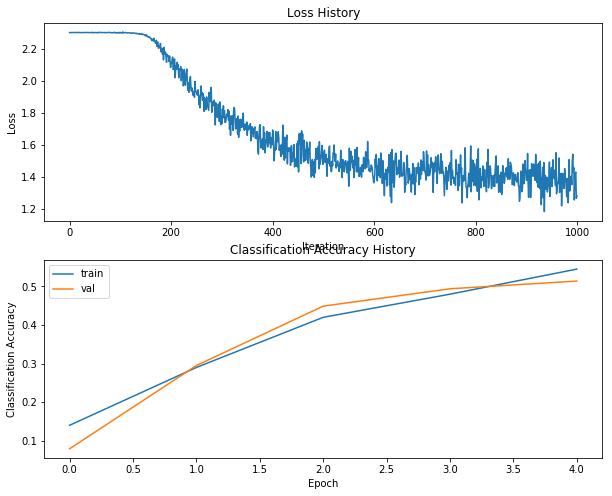



Training process took 7.658842s.
hs 900 lr 1.000000e-01 reg 5.000000e-03


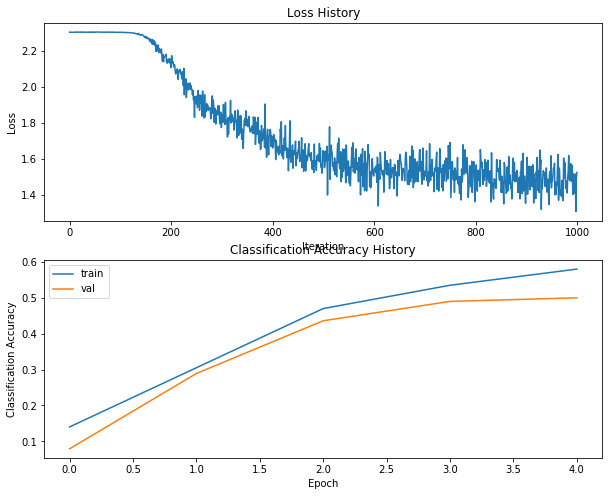



Training process took 7.351038s.
hs 900 lr 1.000000e-01 reg 1.000000e-02


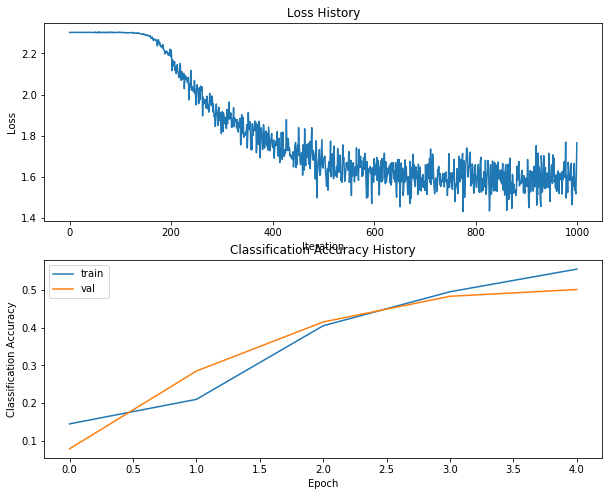



Training process took 7.449555s.
hs 900 lr 1.000000e-01 reg 1.000000e-01


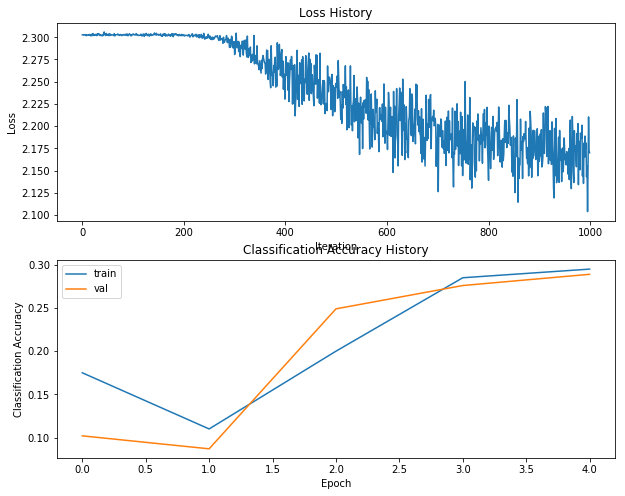



Training process took 7.603257s.
hs 900 lr 1.000000e-01 reg 1.000000e+00


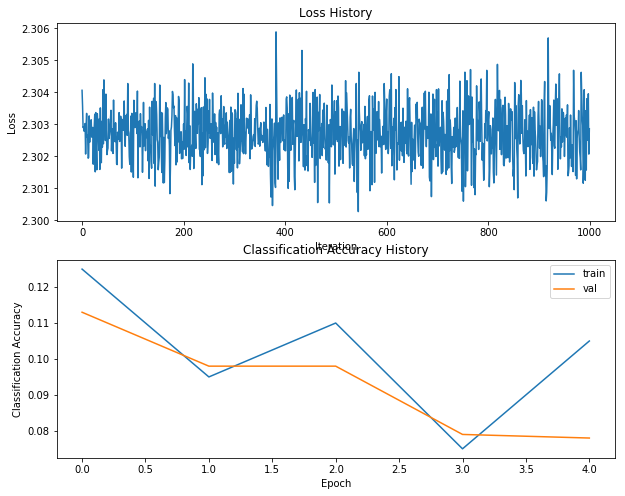



Training process took 7.483862s.
hs 900 lr 1.000000e+00 reg 1.000000e-05


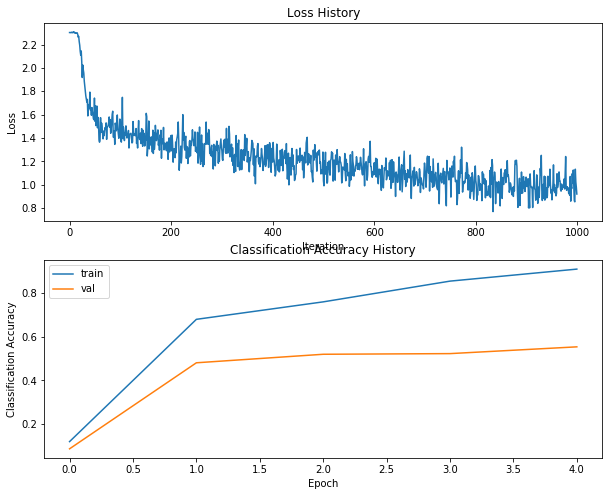



Training process took 6.991945s.
hs 900 lr 1.000000e+00 reg 1.000000e-04


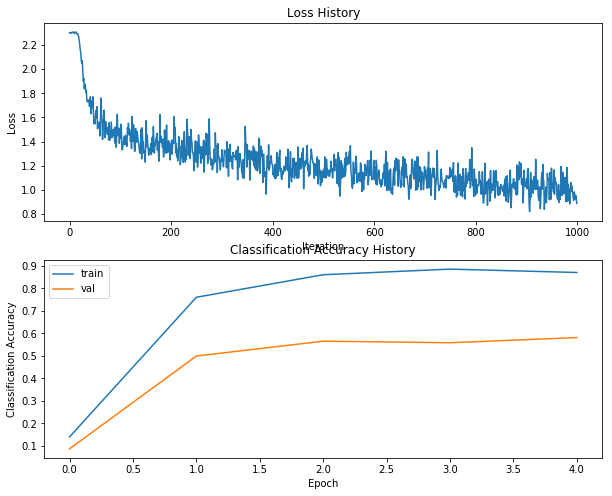



Training process took 7.861761s.
hs 900 lr 1.000000e+00 reg 5.000000e-04


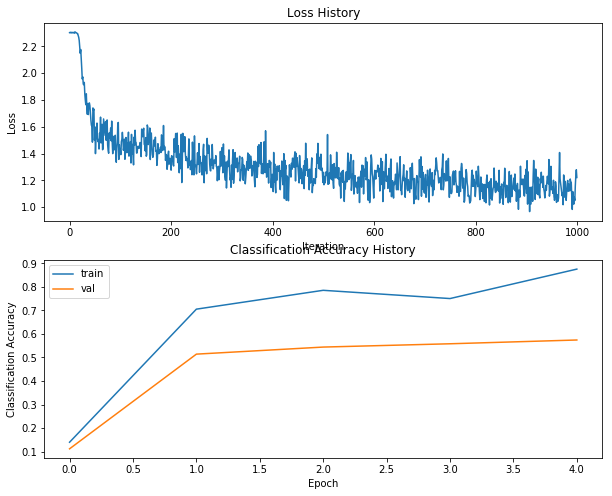



Training process took 8.054991s.
hs 900 lr 1.000000e+00 reg 1.000000e-03


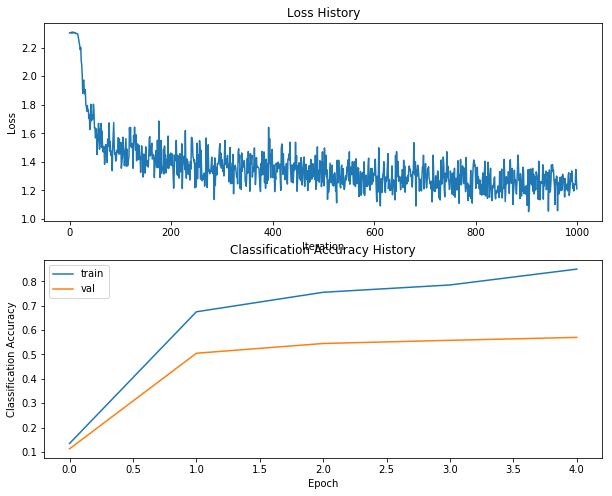



Training process took 7.783913s.
hs 900 lr 1.000000e+00 reg 5.000000e-03


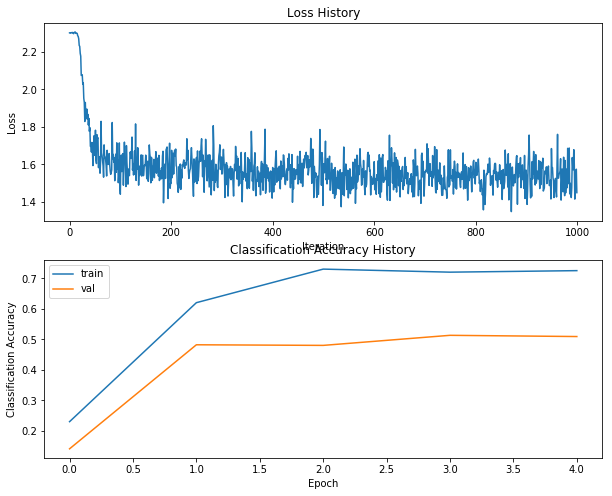



Training process took 7.386485s.
hs 900 lr 1.000000e+00 reg 1.000000e-02


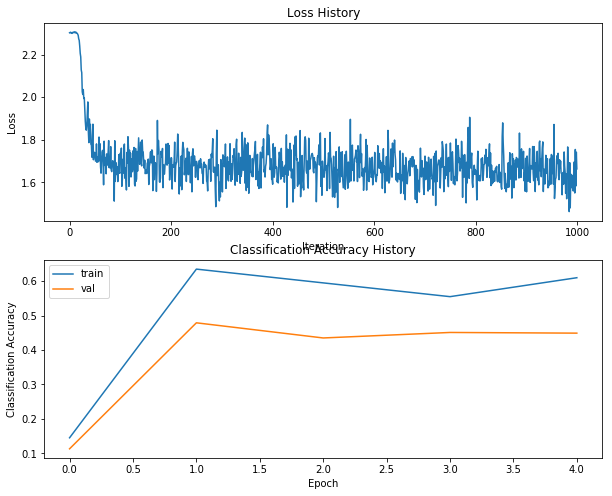



Training process took 6.769793s.
hs 900 lr 1.000000e+00 reg 1.000000e-01


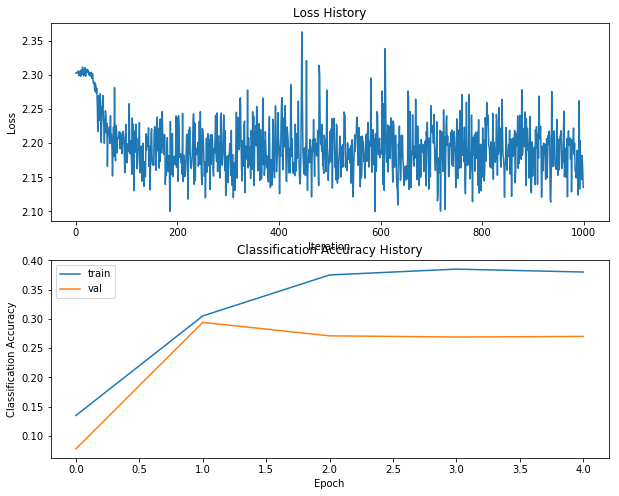



Training process took 7.448831s.
hs 900 lr 1.000000e+00 reg 1.000000e+00


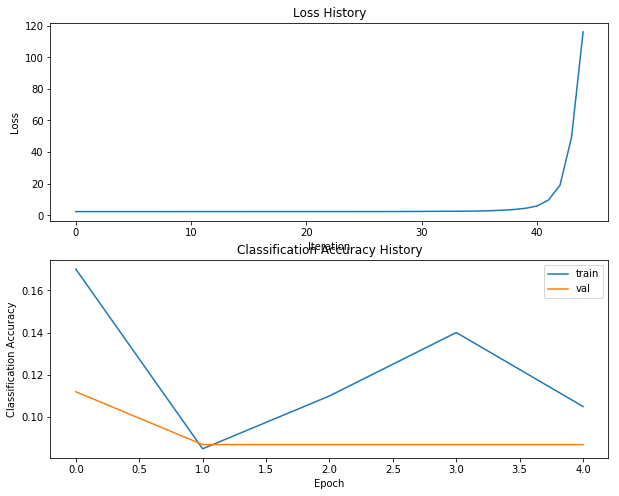



Training process took 7.232620s.
hs 900 lr 1.250000e+00 reg 1.000000e-05


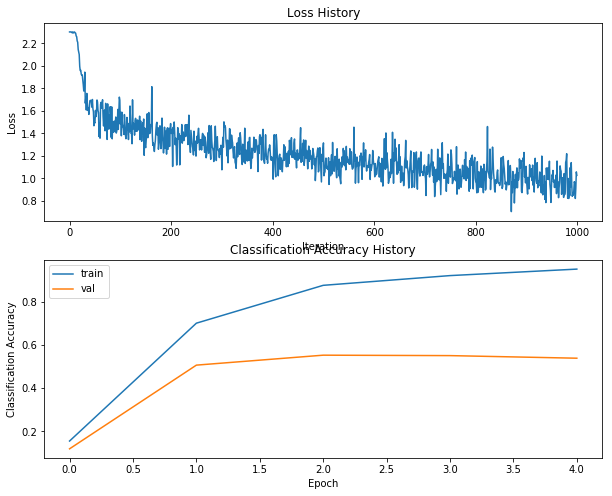



Training process took 7.429318s.
hs 900 lr 1.250000e+00 reg 1.000000e-04


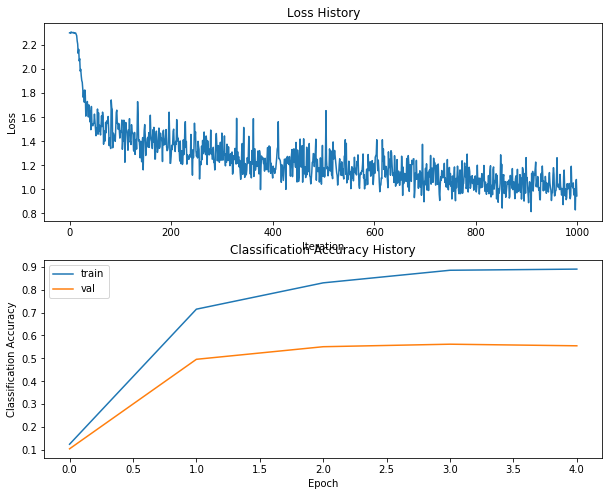



Training process took 7.462954s.
hs 900 lr 1.250000e+00 reg 5.000000e-04


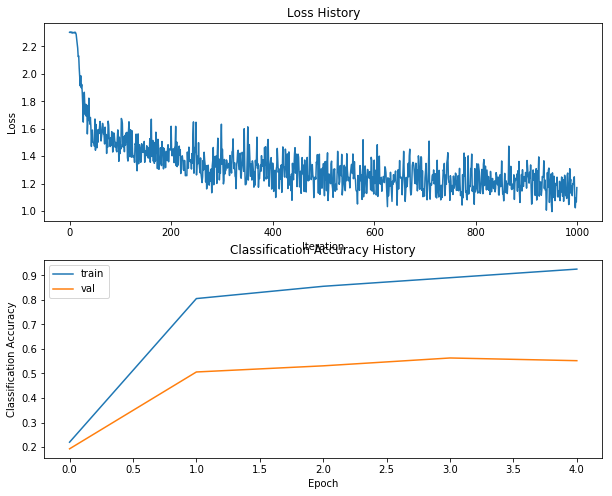



Training process took 7.125530s.
hs 900 lr 1.250000e+00 reg 1.000000e-03


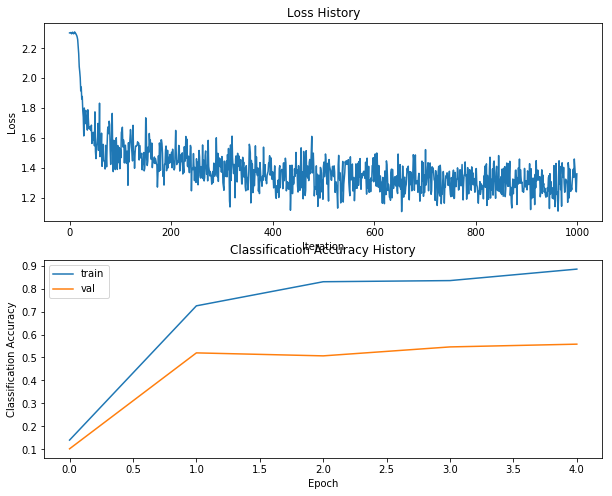



Training process took 7.064639s.
hs 900 lr 1.250000e+00 reg 5.000000e-03


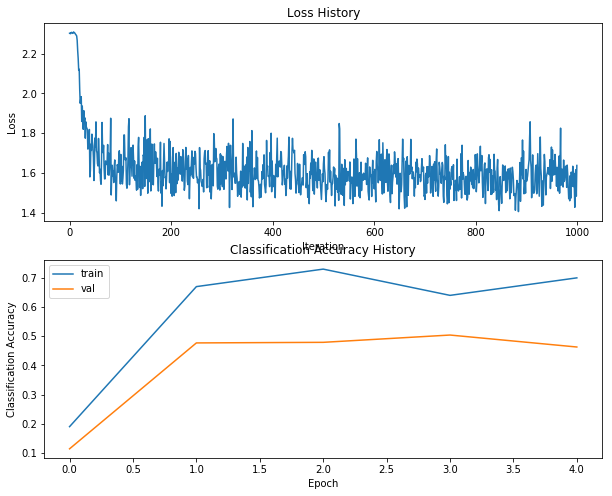



Training process took 7.439313s.
hs 900 lr 1.250000e+00 reg 1.000000e-02


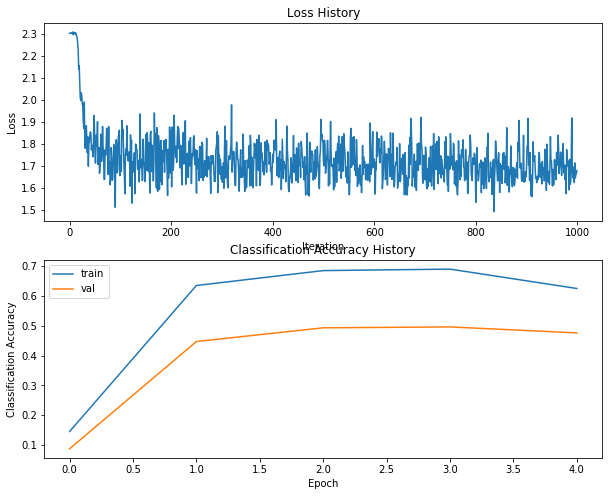



Training process took 7.147580s.
hs 900 lr 1.250000e+00 reg 1.000000e-01


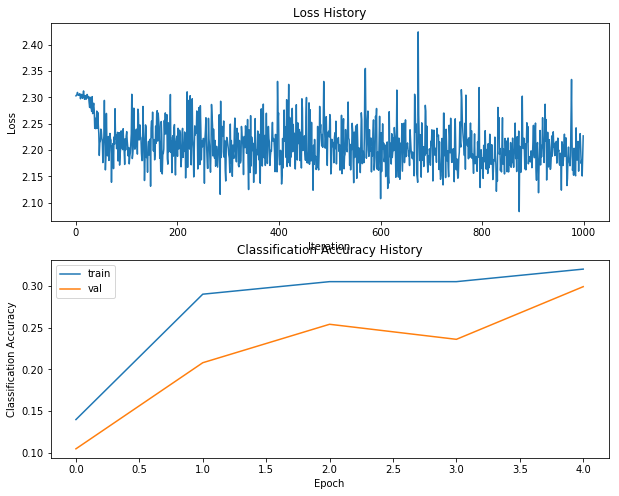



Training process took 8.569876s.
hs 900 lr 1.250000e+00 reg 1.000000e+00


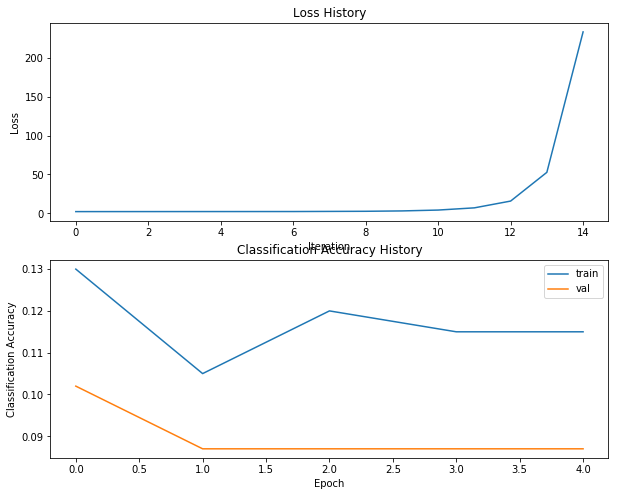



Training process took 7.429685s.
hs 900 lr 1.500000e+00 reg 1.000000e-05


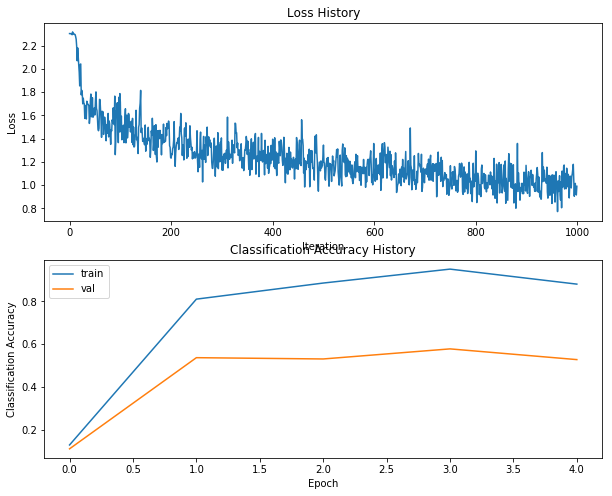



Training process took 7.330101s.
hs 900 lr 1.500000e+00 reg 1.000000e-04


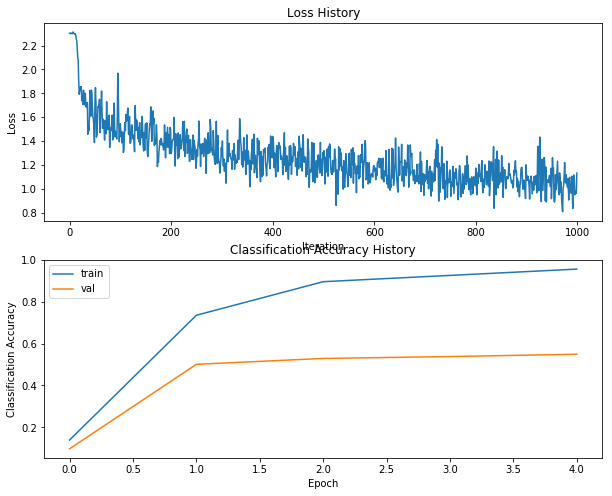



Training process took 8.727404s.
hs 900 lr 1.500000e+00 reg 5.000000e-04


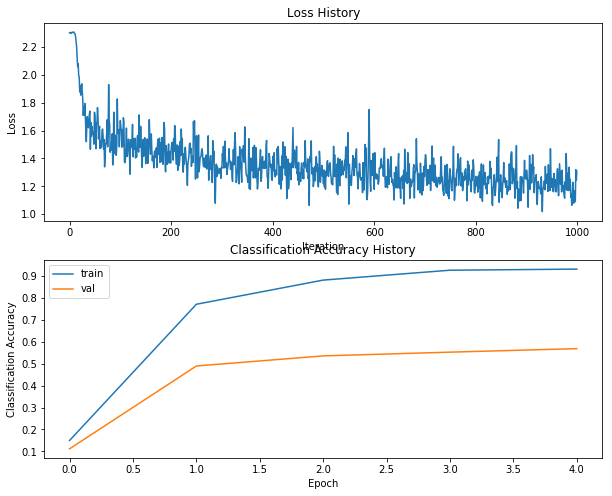



Training process took 6.928763s.
hs 900 lr 1.500000e+00 reg 1.000000e-03


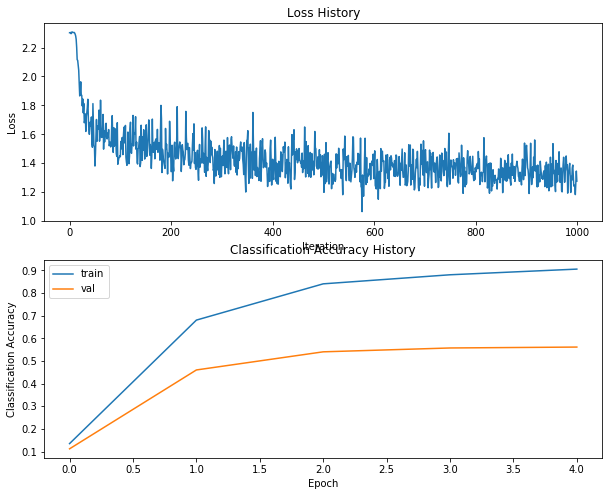



Training process took 7.017663s.
hs 900 lr 1.500000e+00 reg 5.000000e-03


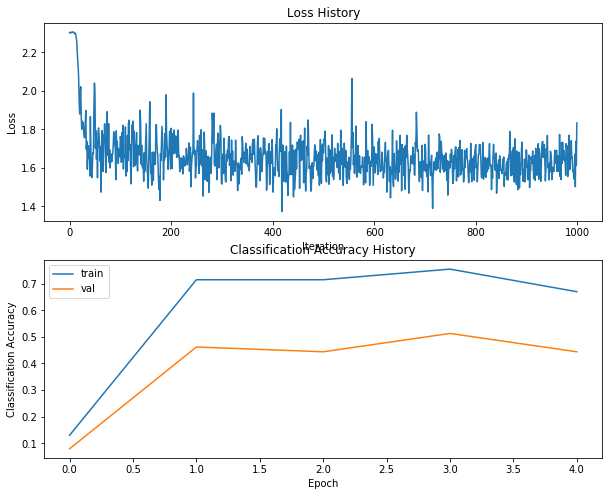



Training process took 6.998847s.
hs 900 lr 1.500000e+00 reg 1.000000e-02


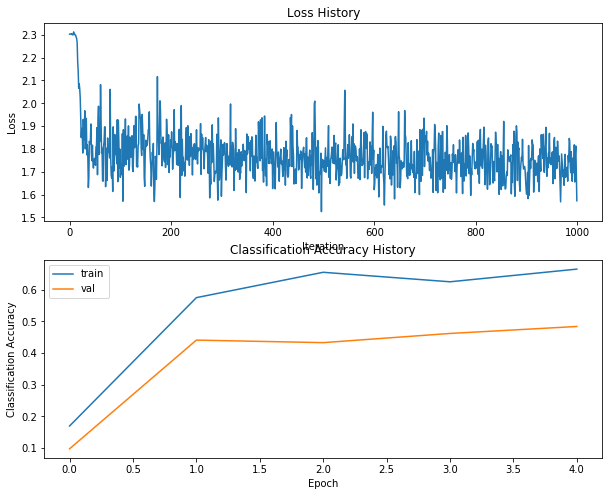



Training process took 6.773987s.
hs 900 lr 1.500000e+00 reg 1.000000e-01


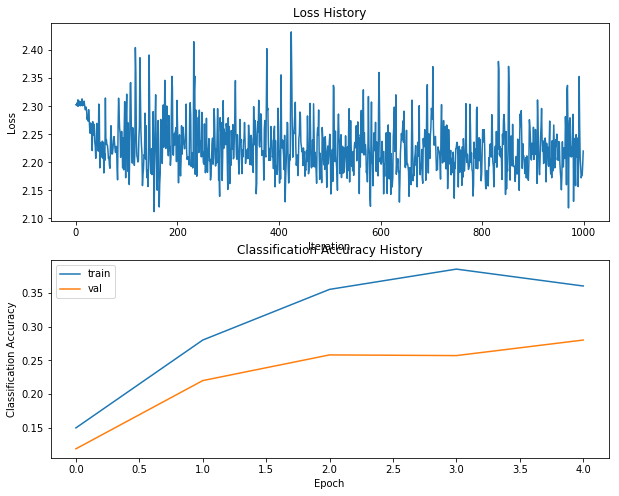



Training process took 7.573582s.
hs 900 lr 1.500000e+00 reg 1.000000e+00


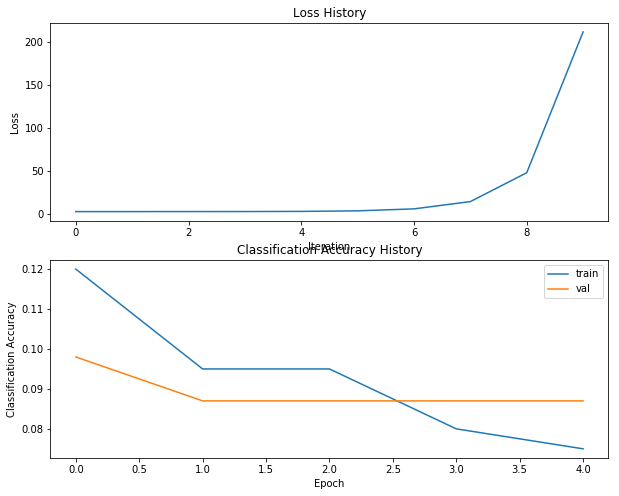



Training process took 7.204338s.
hs 900 lr 1.750000e+00 reg 1.000000e-05


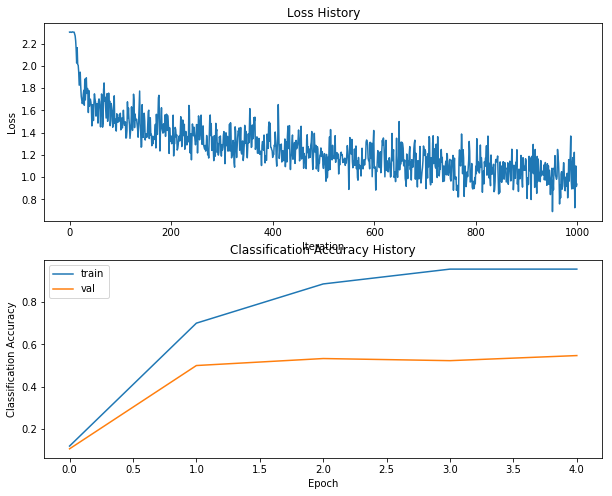



Training process took 6.960457s.
hs 900 lr 1.750000e+00 reg 1.000000e-04


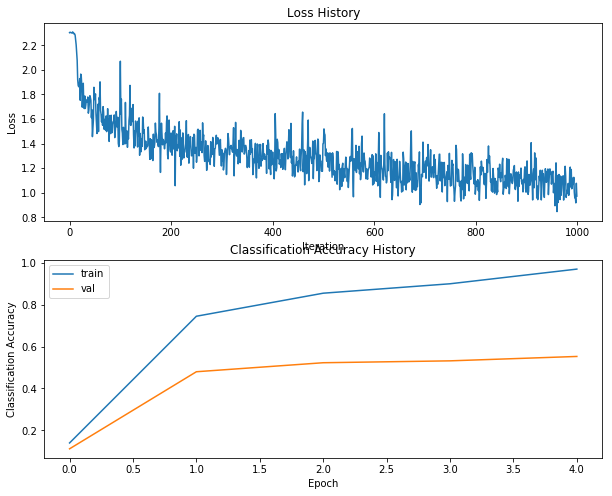



Training process took 7.217883s.
hs 900 lr 1.750000e+00 reg 5.000000e-04


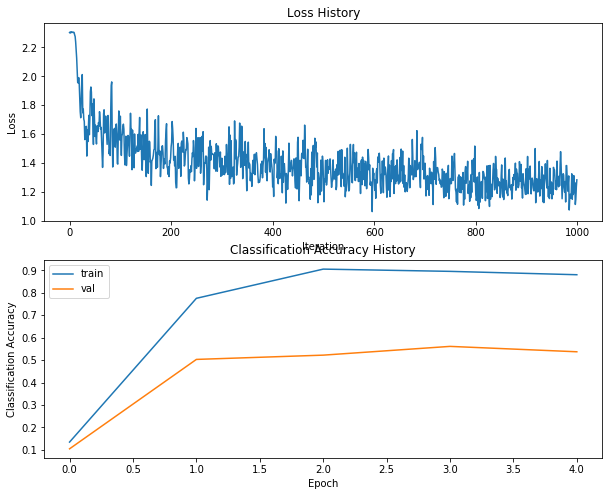



Training process took 7.269146s.
hs 900 lr 1.750000e+00 reg 1.000000e-03


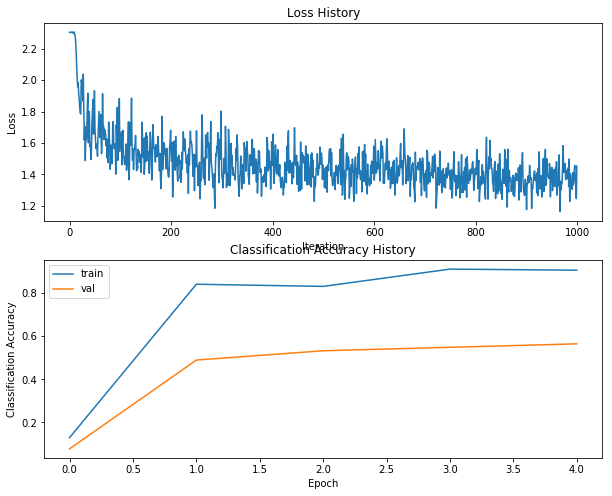



Training process took 7.029275s.
hs 900 lr 1.750000e+00 reg 5.000000e-03


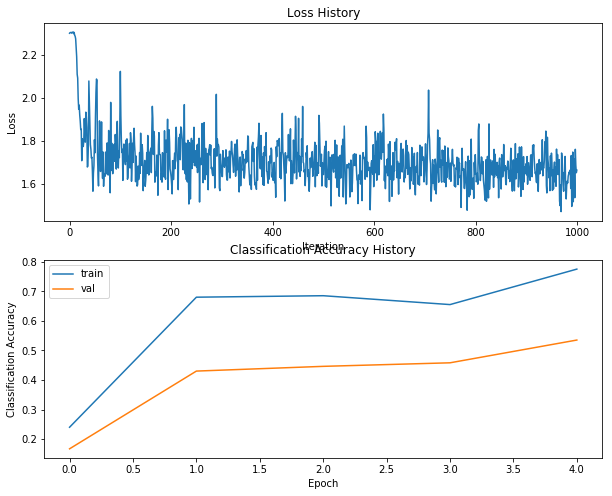



Training process took 7.023203s.
hs 900 lr 1.750000e+00 reg 1.000000e-02


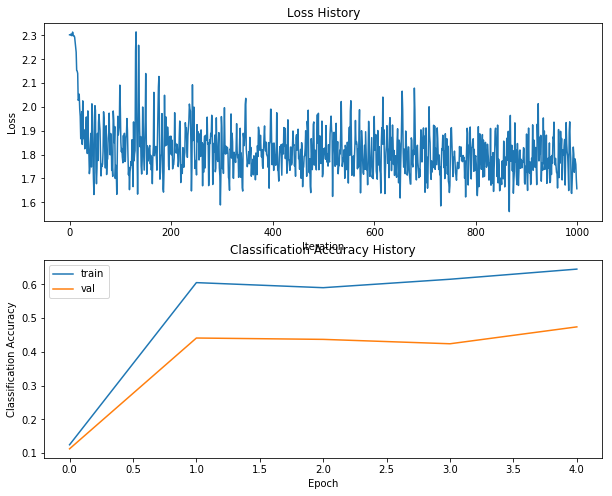



Training process took 6.588911s.
hs 900 lr 1.750000e+00 reg 1.000000e-01


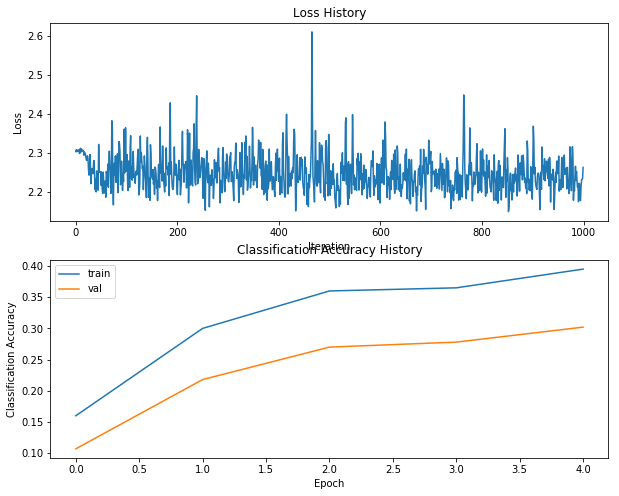



Training process took 8.026161s.
hs 900 lr 1.750000e+00 reg 1.000000e+00


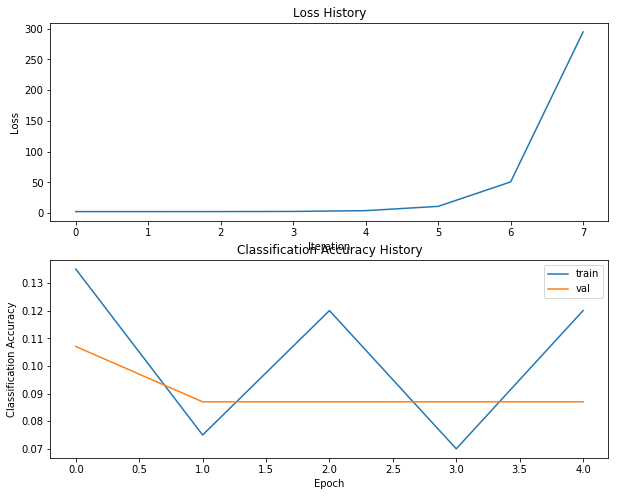



Training process took 6.945216s.
hs 900 lr 2.000000e+00 reg 1.000000e-05


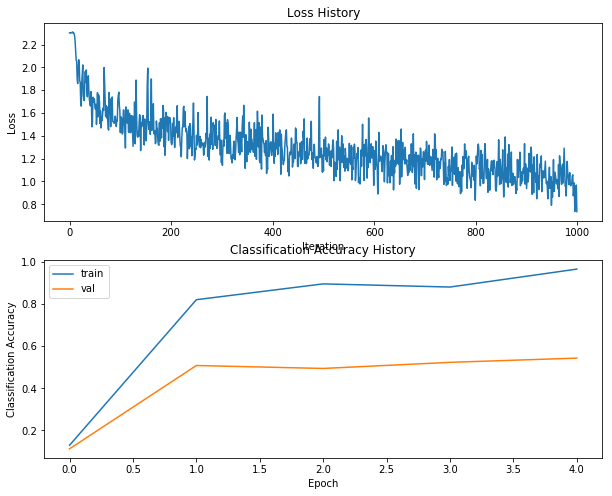



Training process took 7.255767s.
hs 900 lr 2.000000e+00 reg 1.000000e-04


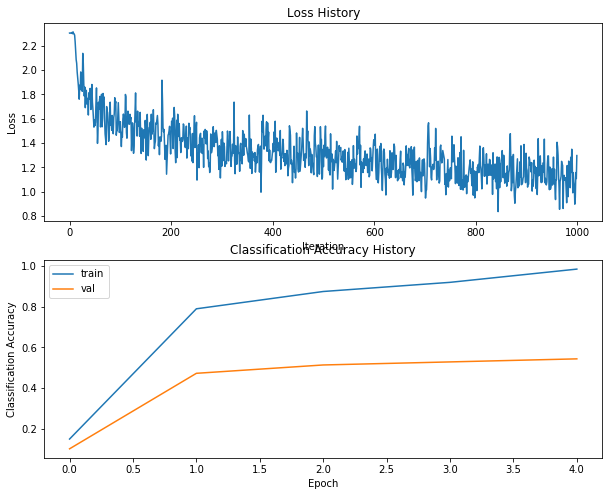



Training process took 7.247210s.
hs 900 lr 2.000000e+00 reg 5.000000e-04


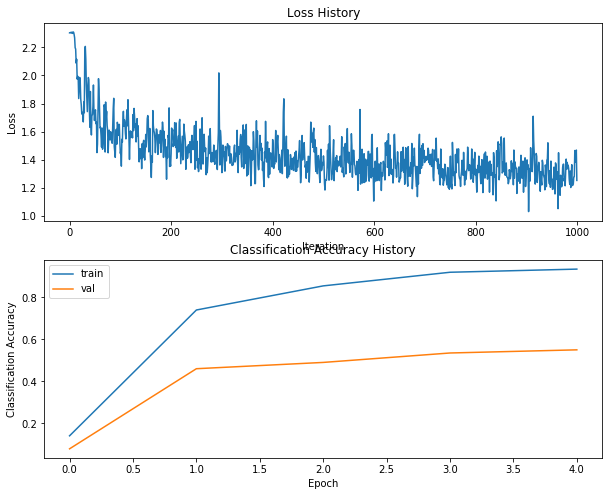



Training process took 6.873822s.
hs 900 lr 2.000000e+00 reg 1.000000e-03


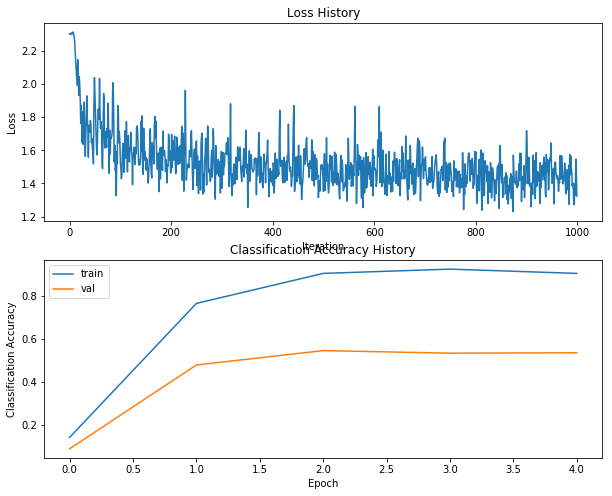



Training process took 7.732400s.
hs 900 lr 2.000000e+00 reg 5.000000e-03


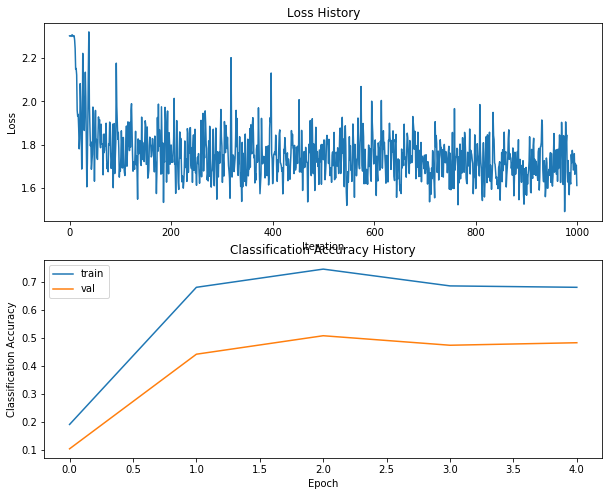



Training process took 7.084624s.
hs 900 lr 2.000000e+00 reg 1.000000e-02


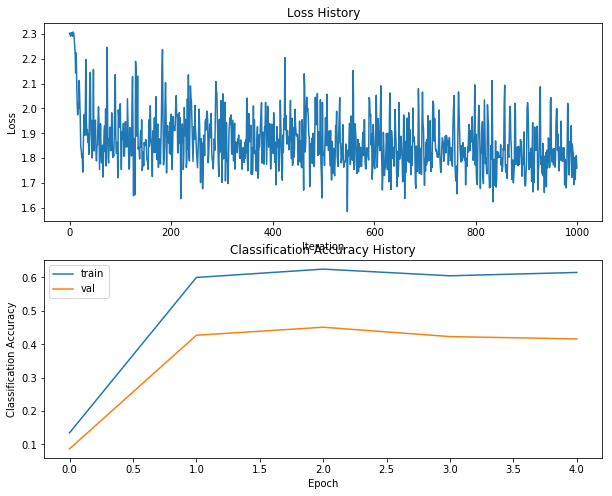



Training process took 6.583557s.
hs 900 lr 2.000000e+00 reg 1.000000e-01


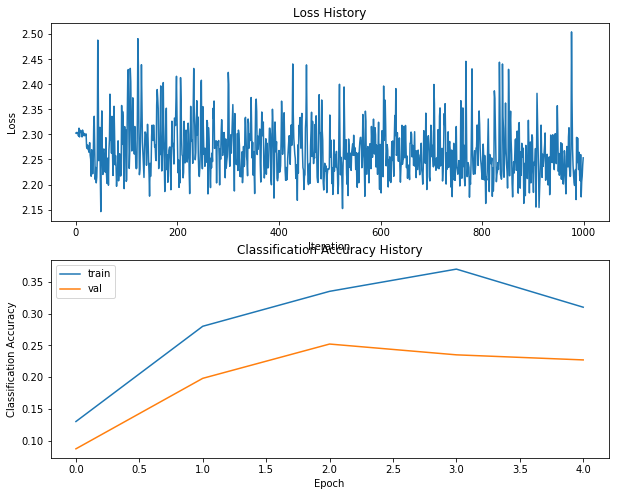



Training process took 9.284077s.
hs 900 lr 2.000000e+00 reg 1.000000e+00


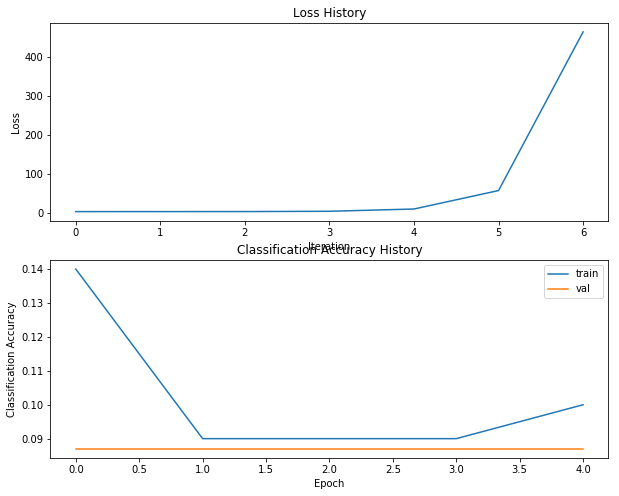



Training process took 9.421533s.
hs 900 lr 2.500000e+00 reg 1.000000e-05


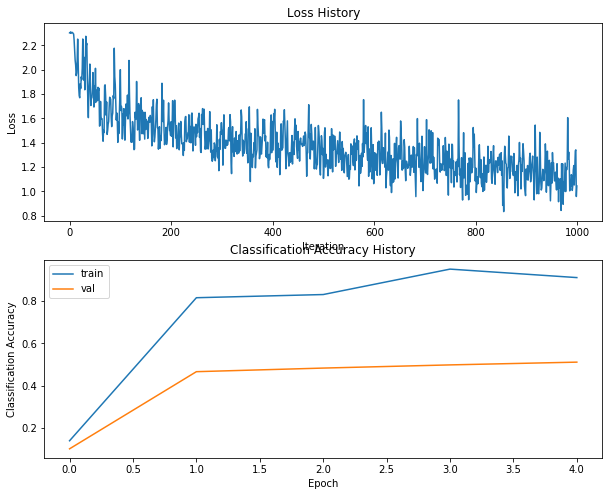



Training process took 10.089601s.
hs 900 lr 2.500000e+00 reg 1.000000e-04


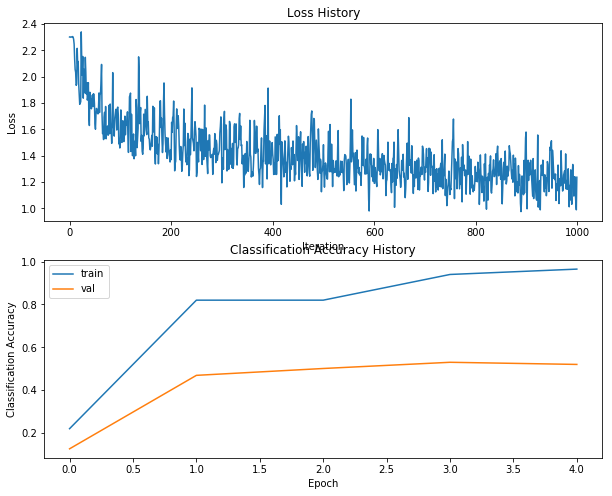



Training process took 10.385146s.
hs 900 lr 2.500000e+00 reg 5.000000e-04


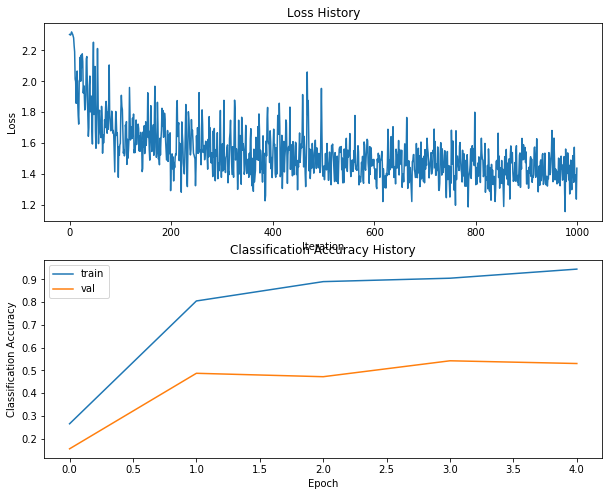



Training process took 7.367068s.
hs 900 lr 2.500000e+00 reg 1.000000e-03


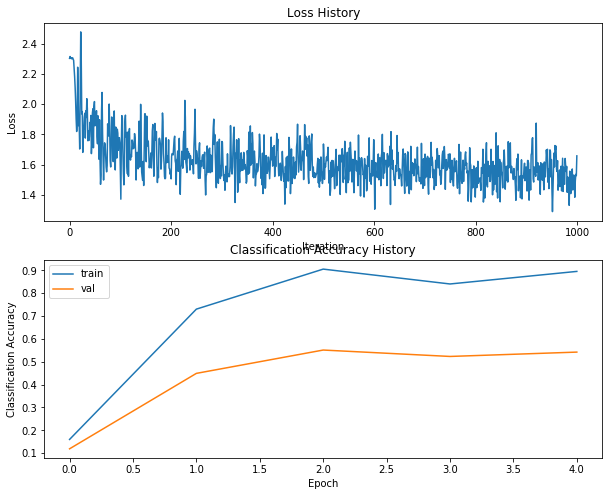



Training process took 7.379527s.
hs 900 lr 2.500000e+00 reg 5.000000e-03


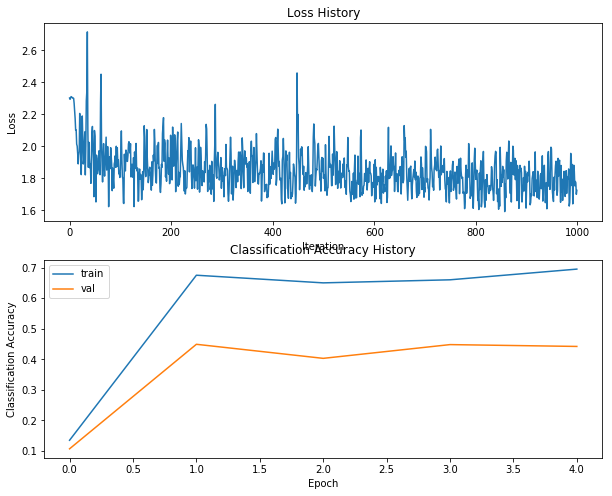



Training process took 7.050332s.
hs 900 lr 2.500000e+00 reg 1.000000e-02


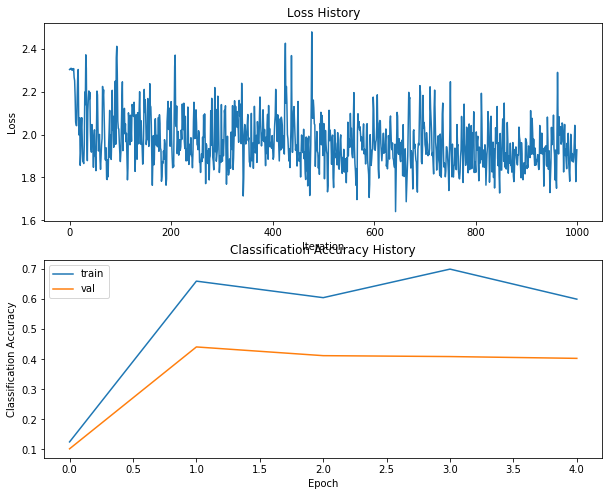



Training process took 7.915094s.
hs 900 lr 2.500000e+00 reg 1.000000e-01


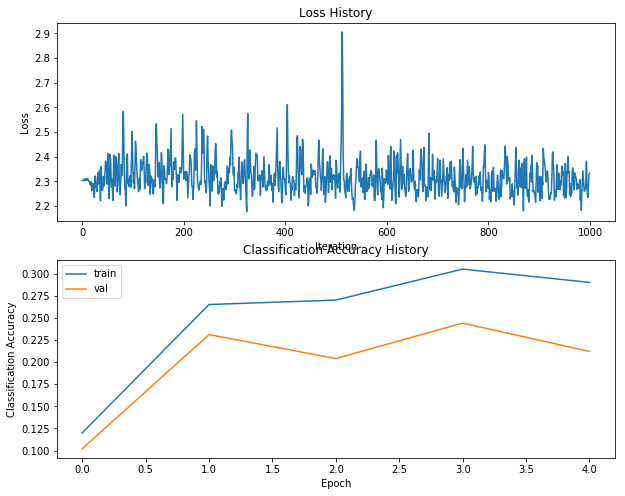



Training process took 8.073795s.
hs 900 lr 2.500000e+00 reg 1.000000e+00


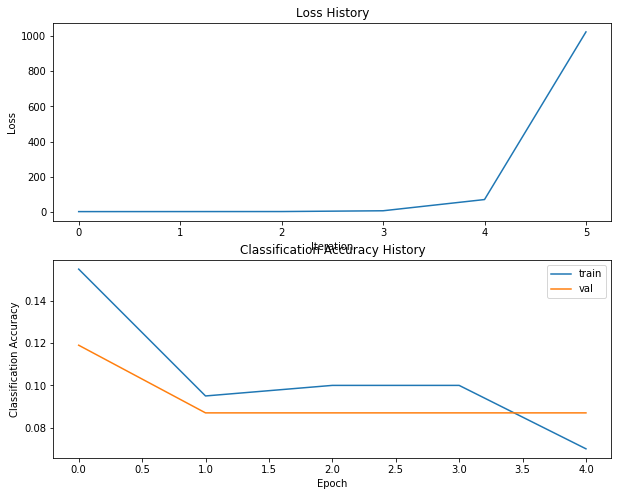



Training process took 8.341780s.
hs 1000 lr 1.000000e-01 reg 1.000000e-05


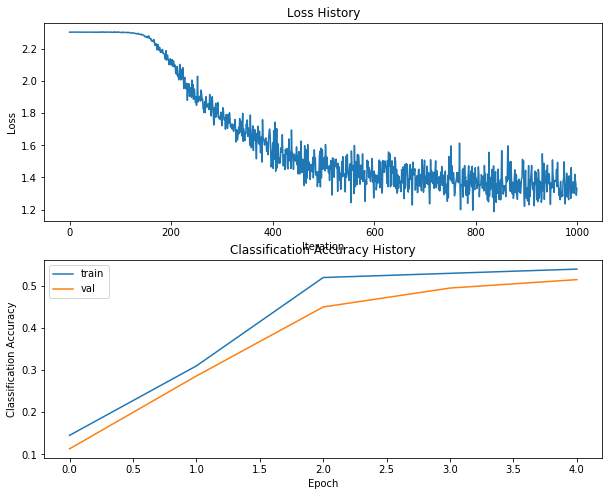



Training process took 8.086612s.
hs 1000 lr 1.000000e-01 reg 1.000000e-04


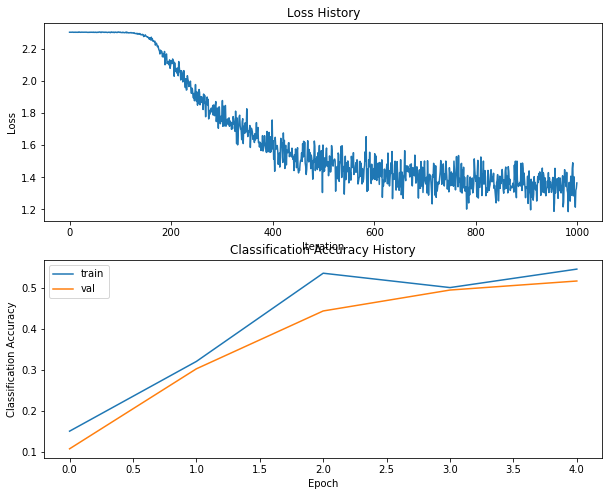



Training process took 8.373977s.
hs 1000 lr 1.000000e-01 reg 5.000000e-04


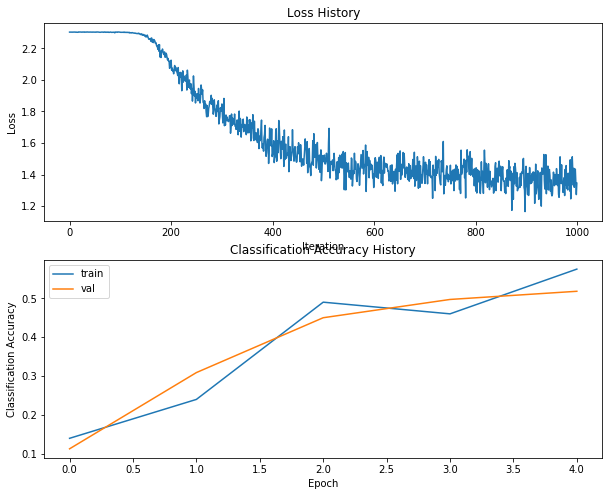



Training process took 8.054744s.
hs 1000 lr 1.000000e-01 reg 1.000000e-03


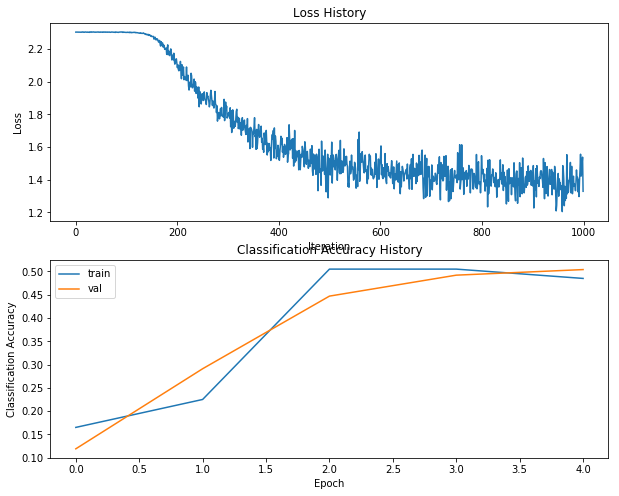



Training process took 8.083441s.
hs 1000 lr 1.000000e-01 reg 5.000000e-03


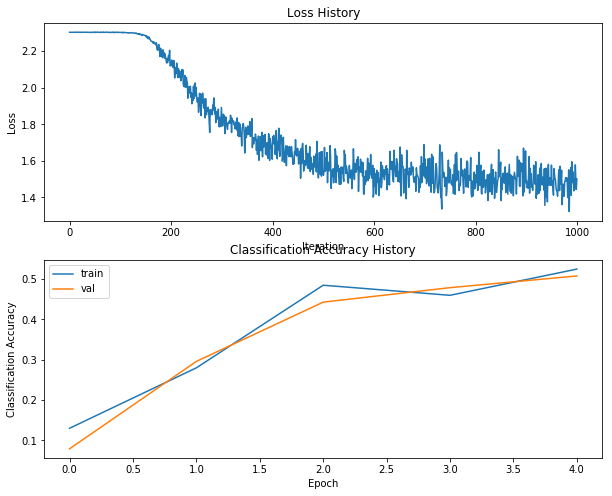



Training process took 8.063220s.
hs 1000 lr 1.000000e-01 reg 1.000000e-02


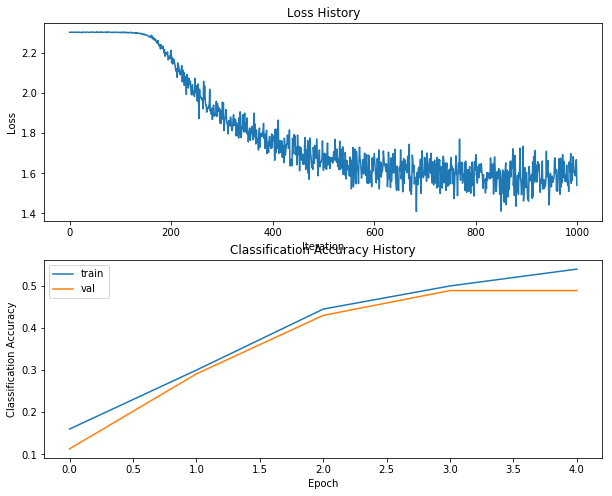



Training process took 7.679327s.
hs 1000 lr 1.000000e-01 reg 1.000000e-01


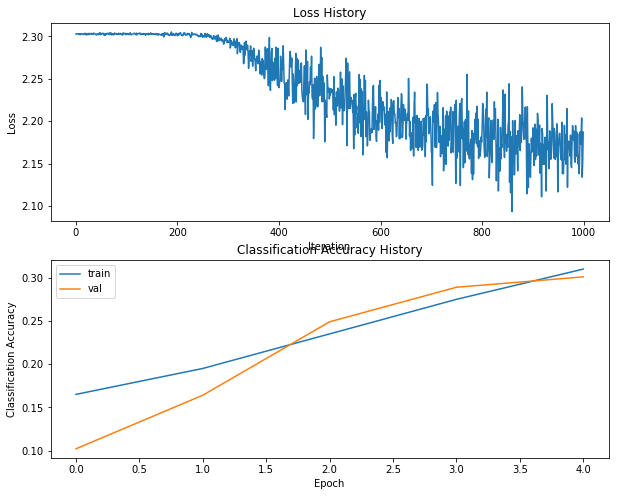



Training process took 7.368055s.
hs 1000 lr 1.000000e-01 reg 1.000000e+00


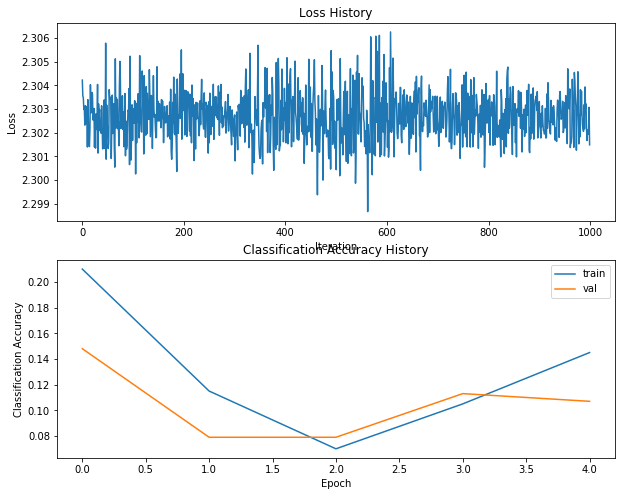



Training process took 8.503645s.
hs 1000 lr 1.000000e+00 reg 1.000000e-05


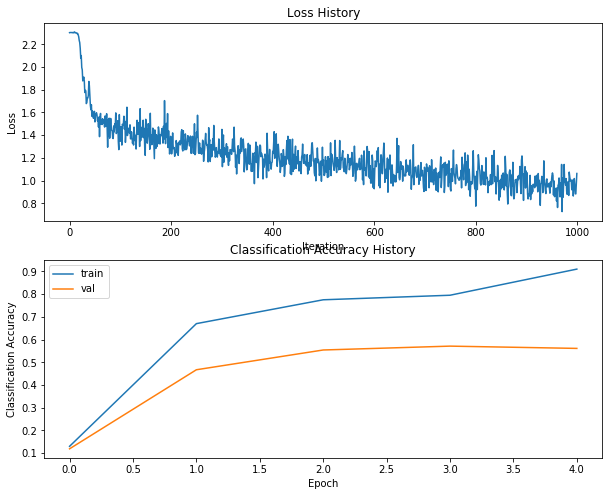



Training process took 8.415687s.
hs 1000 lr 1.000000e+00 reg 1.000000e-04


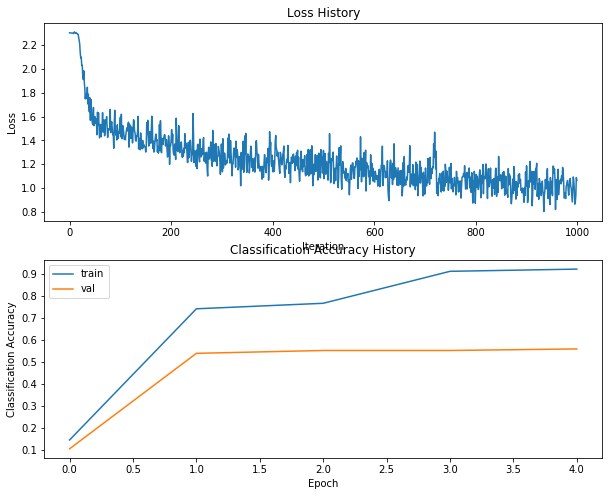



Training process took 8.639387s.
hs 1000 lr 1.000000e+00 reg 5.000000e-04


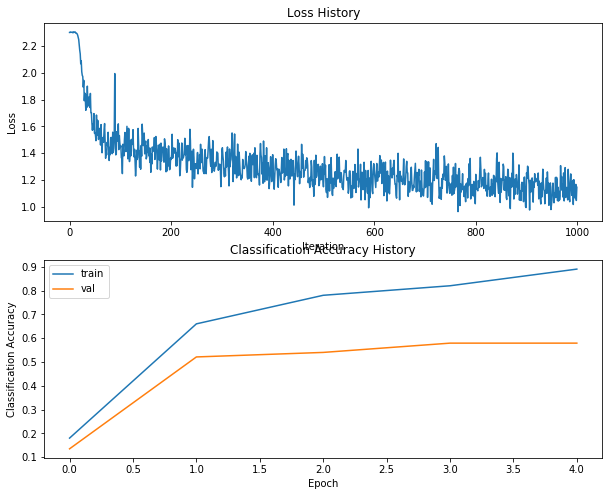



Training process took 7.940997s.
hs 1000 lr 1.000000e+00 reg 1.000000e-03


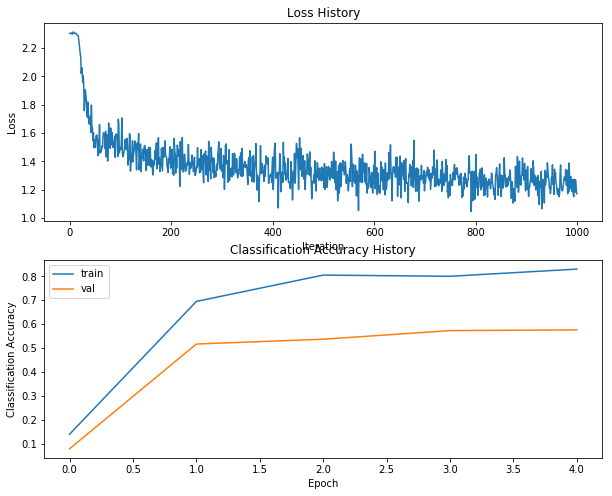



Training process took 7.891833s.
hs 1000 lr 1.000000e+00 reg 5.000000e-03


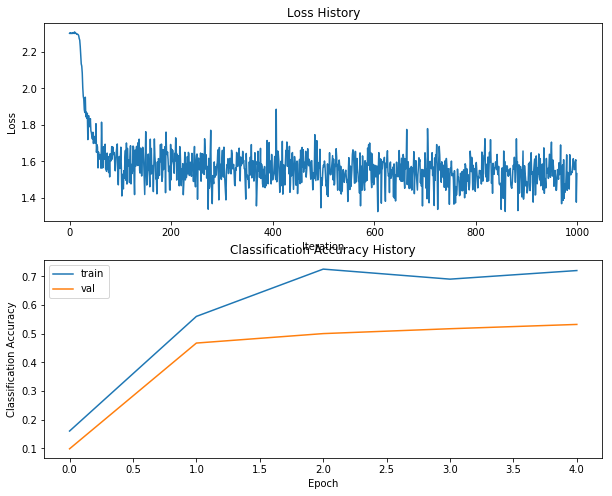



Training process took 8.843614s.
hs 1000 lr 1.000000e+00 reg 1.000000e-02


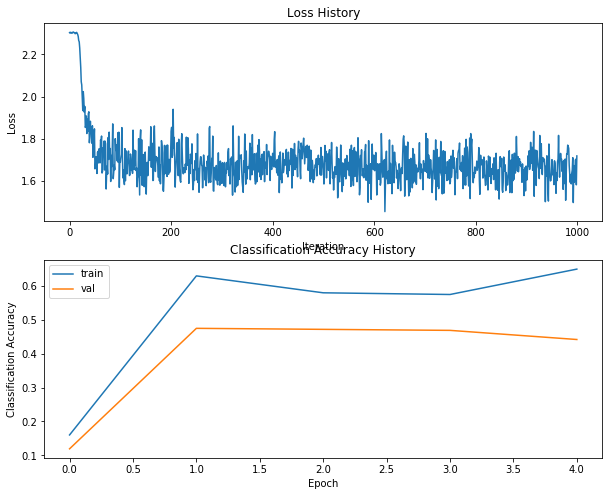



Training process took 7.775756s.
hs 1000 lr 1.000000e+00 reg 1.000000e-01


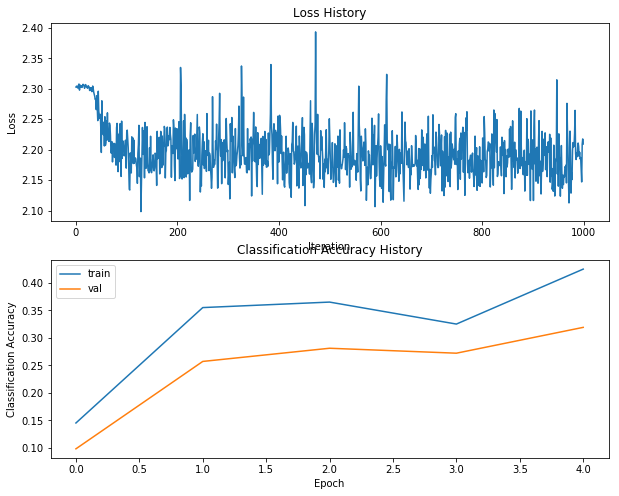



Training process took 8.526337s.
hs 1000 lr 1.000000e+00 reg 1.000000e+00


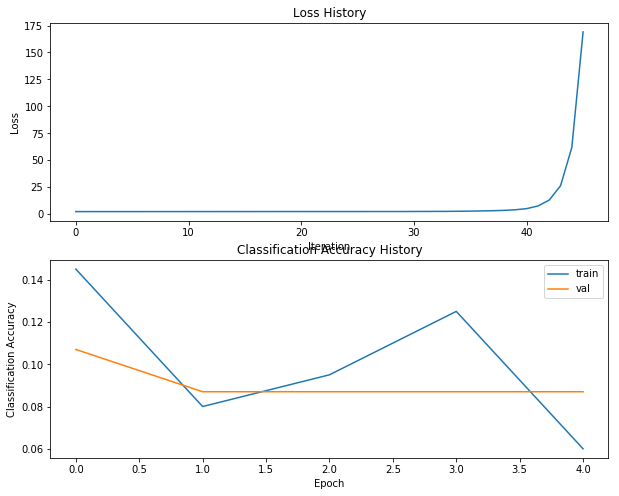



Training process took 7.969188s.
hs 1000 lr 1.250000e+00 reg 1.000000e-05


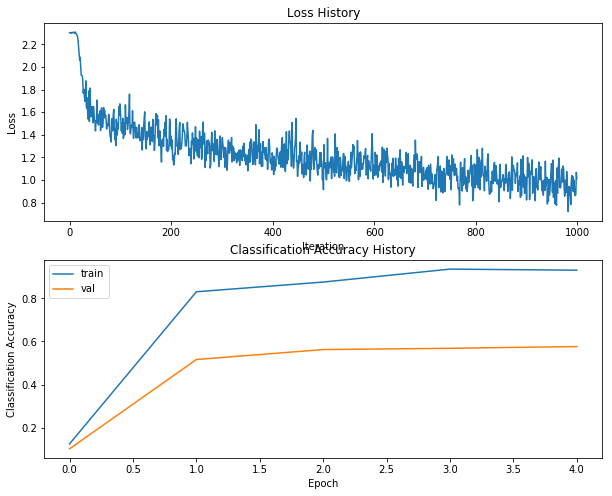



Training process took 8.415198s.
hs 1000 lr 1.250000e+00 reg 1.000000e-04


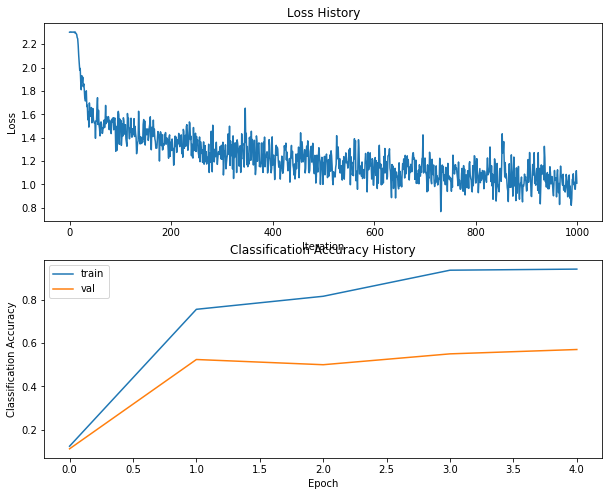



Training process took 8.008348s.
hs 1000 lr 1.250000e+00 reg 5.000000e-04


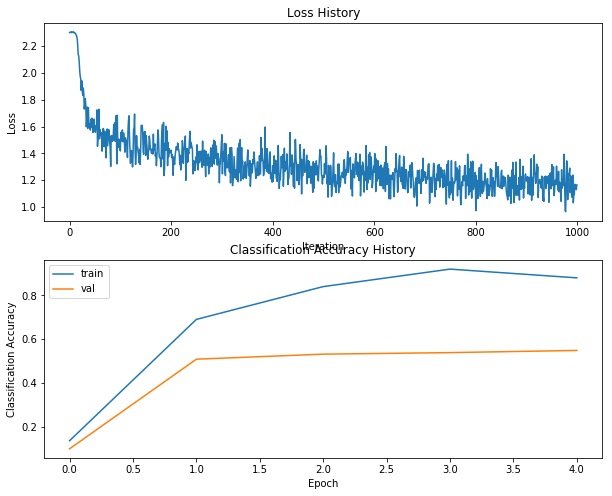



Training process took 9.149285s.
hs 1000 lr 1.250000e+00 reg 1.000000e-03


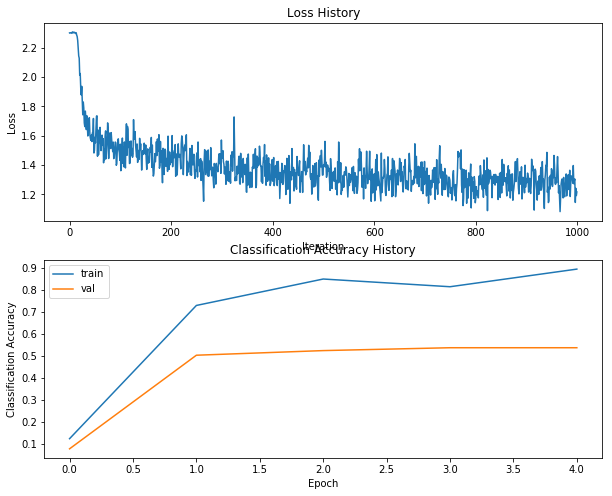



Training process took 12.592971s.
hs 1000 lr 1.250000e+00 reg 5.000000e-03


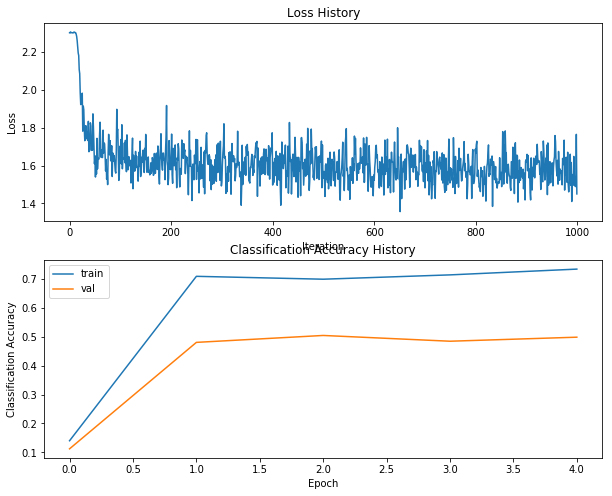



Training process took 12.312938s.
hs 1000 lr 1.250000e+00 reg 1.000000e-02


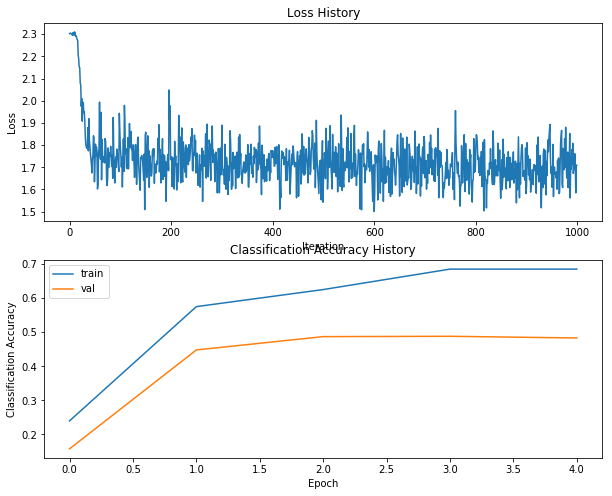



Training process took 11.850512s.
hs 1000 lr 1.250000e+00 reg 1.000000e-01


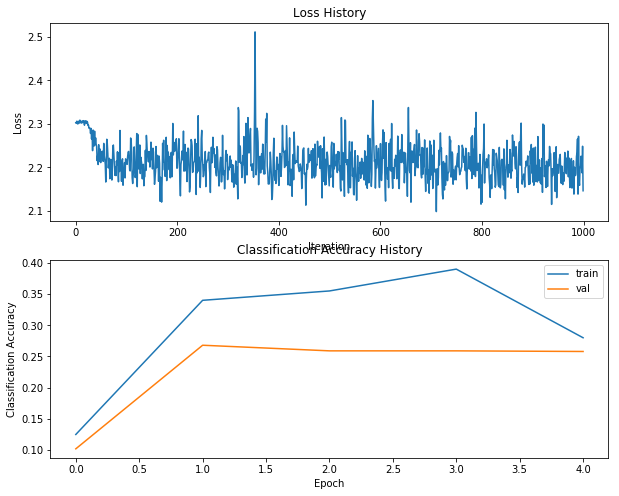



Training process took 12.161439s.
hs 1000 lr 1.250000e+00 reg 1.000000e+00


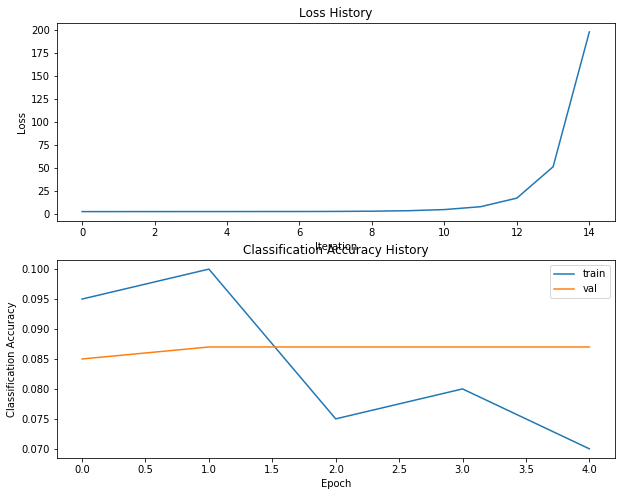



Training process took 14.805212s.
hs 1000 lr 1.500000e+00 reg 1.000000e-05


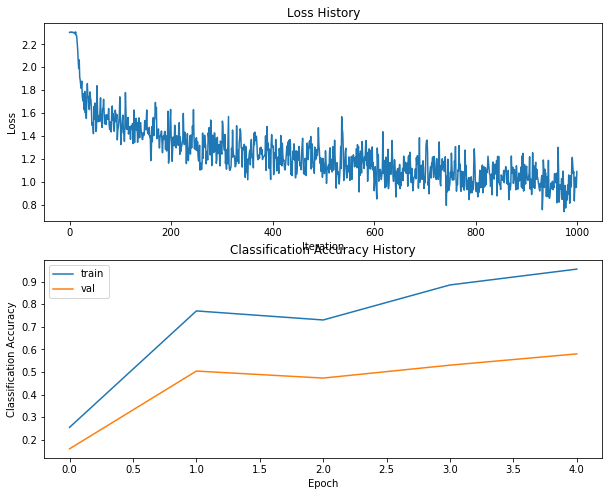



Training process took 10.523024s.
hs 1000 lr 1.500000e+00 reg 1.000000e-04


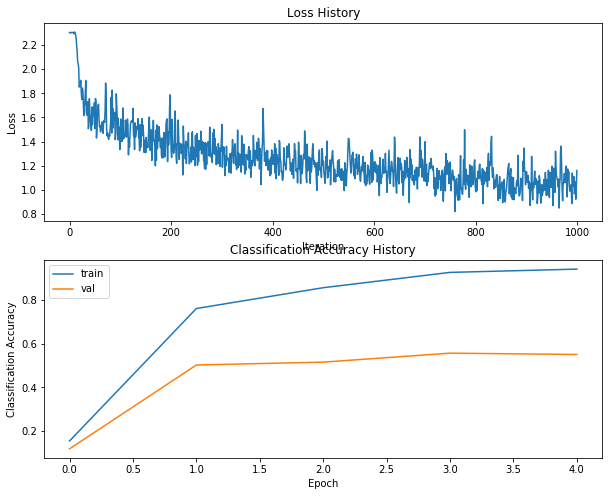



Training process took 9.432162s.
hs 1000 lr 1.500000e+00 reg 5.000000e-04


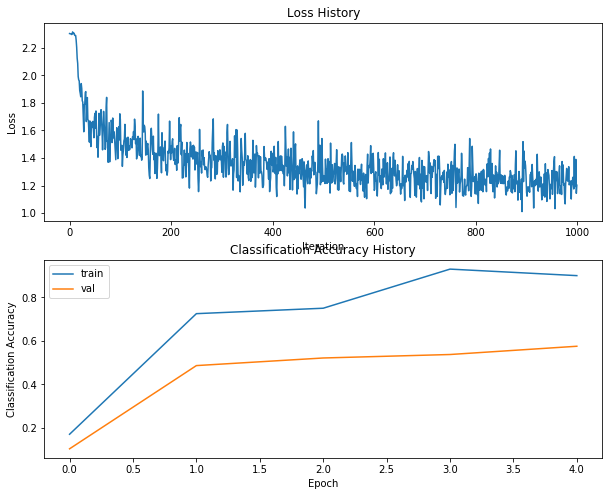



Training process took 9.143505s.
hs 1000 lr 1.500000e+00 reg 1.000000e-03


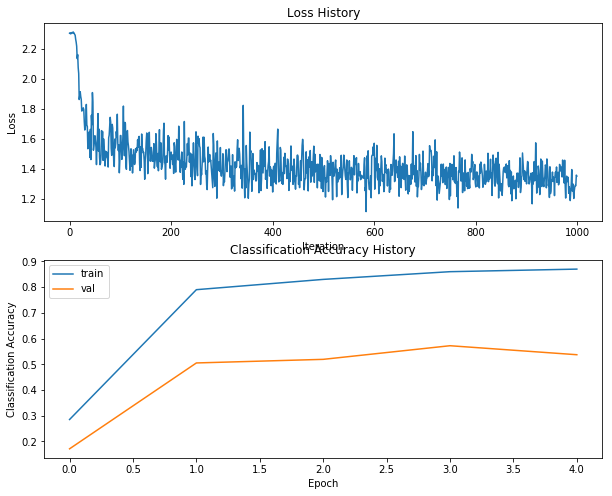



Training process took 10.032973s.
hs 1000 lr 1.500000e+00 reg 5.000000e-03


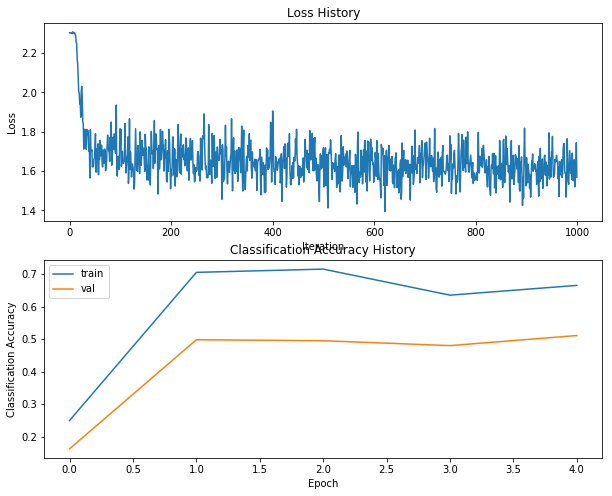



Training process took 9.830962s.
hs 1000 lr 1.500000e+00 reg 1.000000e-02


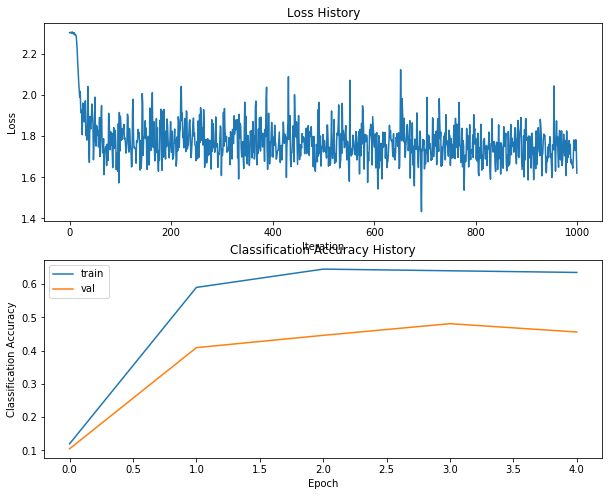



Training process took 11.165892s.
hs 1000 lr 1.500000e+00 reg 1.000000e-01


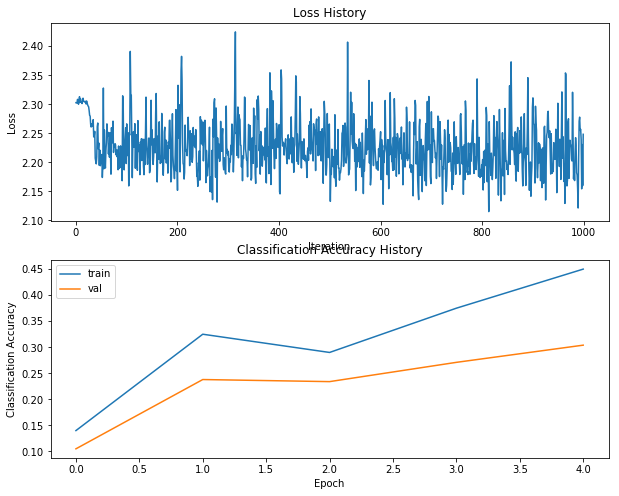



Training process took 9.828805s.
hs 1000 lr 1.500000e+00 reg 1.000000e+00


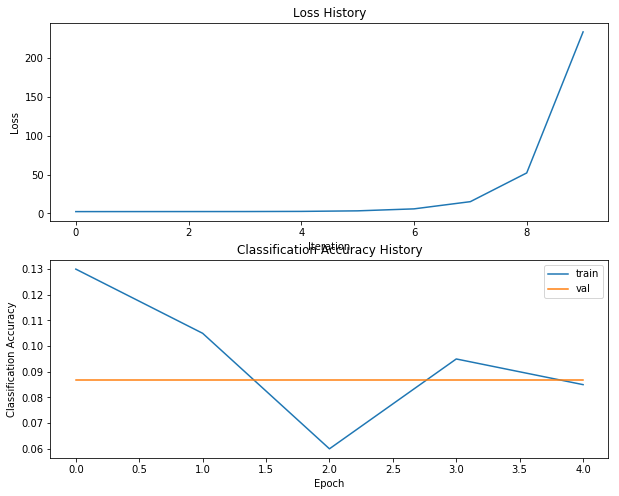



Training process took 9.451531s.
hs 1000 lr 1.750000e+00 reg 1.000000e-05


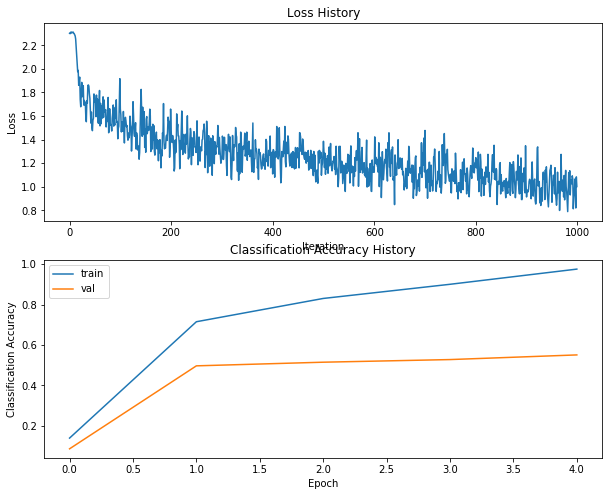



Training process took 9.397238s.
hs 1000 lr 1.750000e+00 reg 1.000000e-04


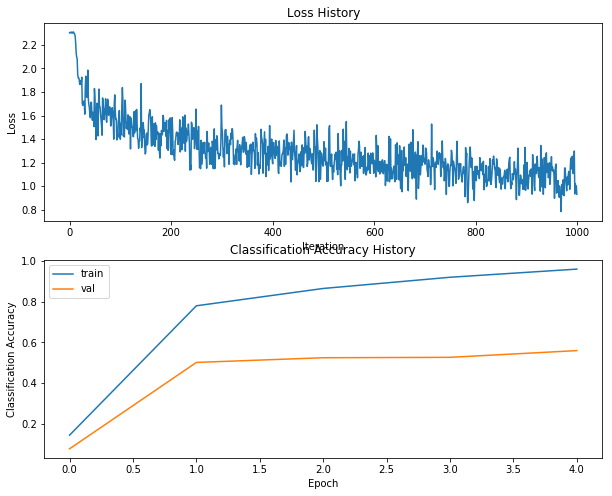



Training process took 9.275895s.
hs 1000 lr 1.750000e+00 reg 5.000000e-04


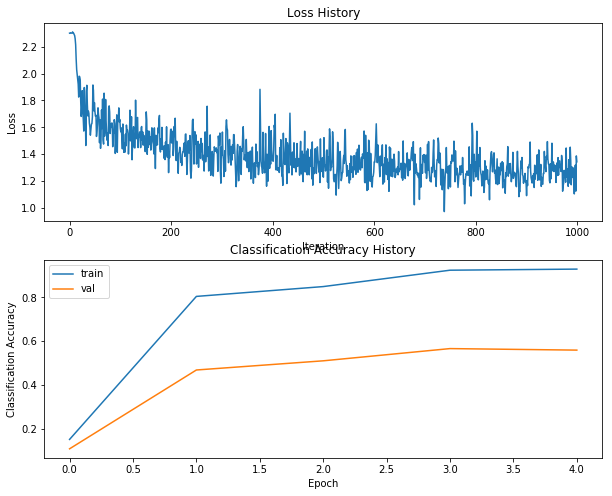



Training process took 9.094697s.
hs 1000 lr 1.750000e+00 reg 1.000000e-03


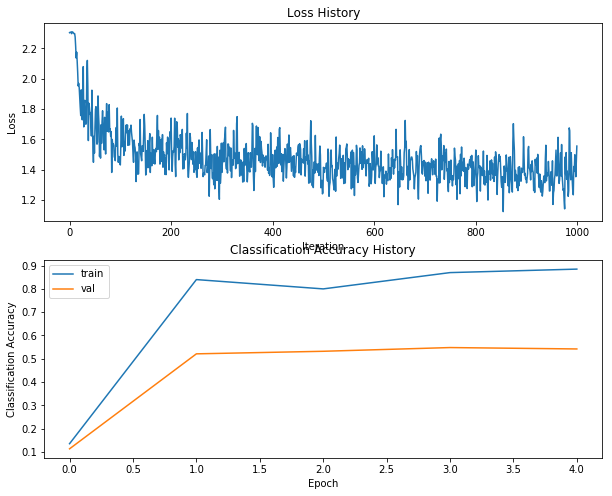



Training process took 10.463253s.
hs 1000 lr 1.750000e+00 reg 5.000000e-03


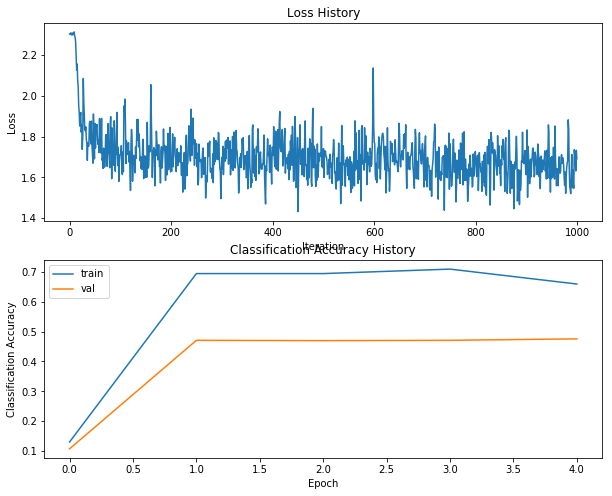



Training process took 10.572277s.
hs 1000 lr 1.750000e+00 reg 1.000000e-02


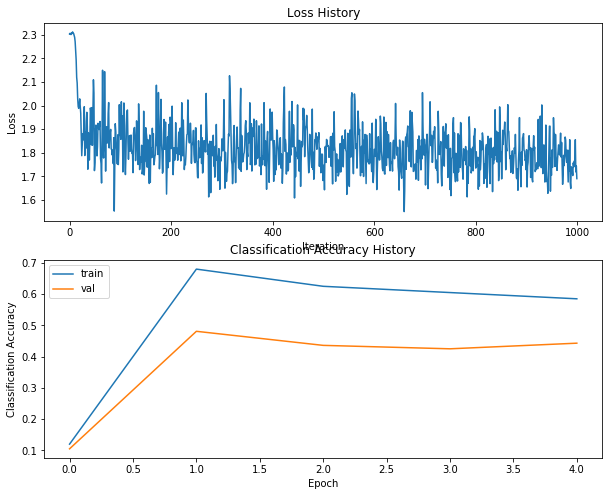



Training process took 9.239152s.
hs 1000 lr 1.750000e+00 reg 1.000000e-01


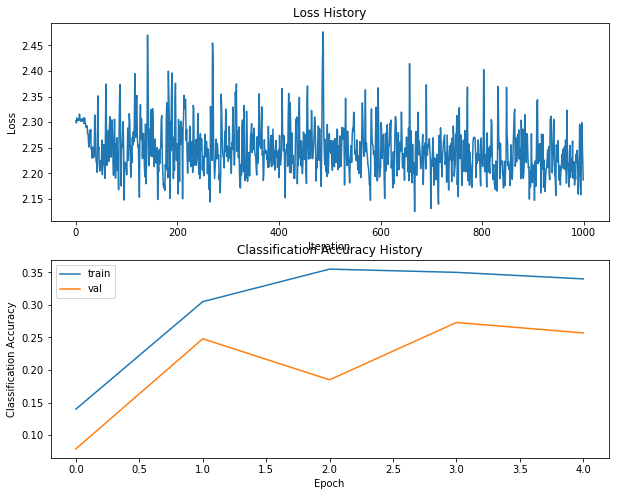



Training process took 9.970225s.
hs 1000 lr 1.750000e+00 reg 1.000000e+00


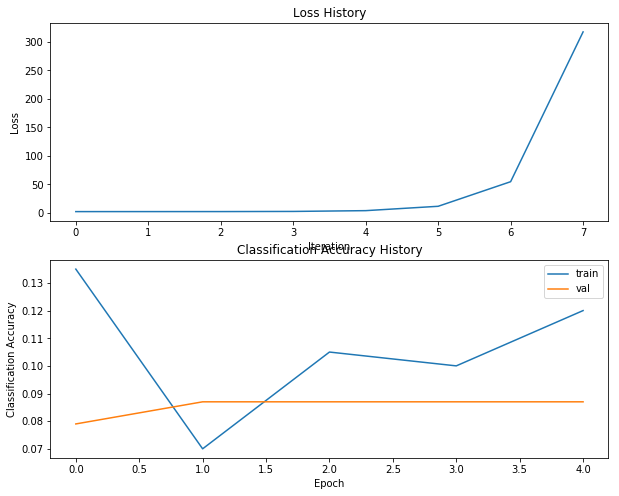



Training process took 8.986240s.
hs 1000 lr 2.000000e+00 reg 1.000000e-05


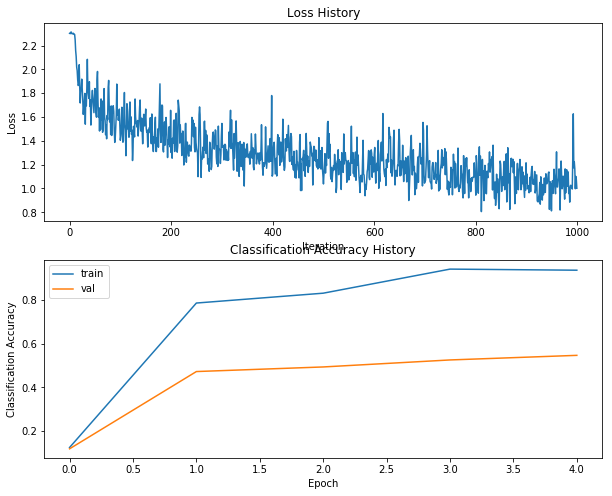



Training process took 9.210745s.
hs 1000 lr 2.000000e+00 reg 1.000000e-04


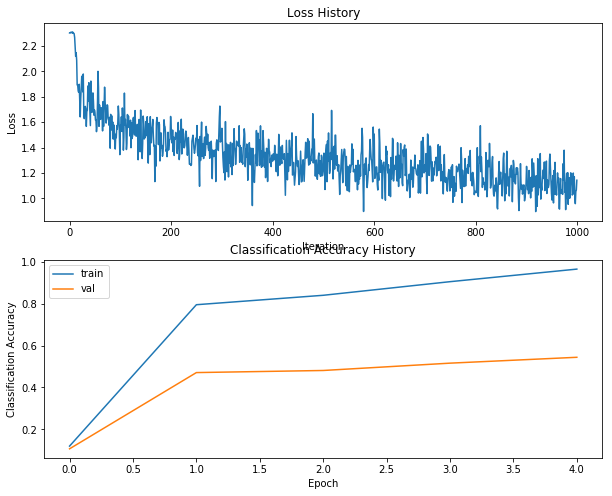



Training process took 8.766136s.
hs 1000 lr 2.000000e+00 reg 5.000000e-04


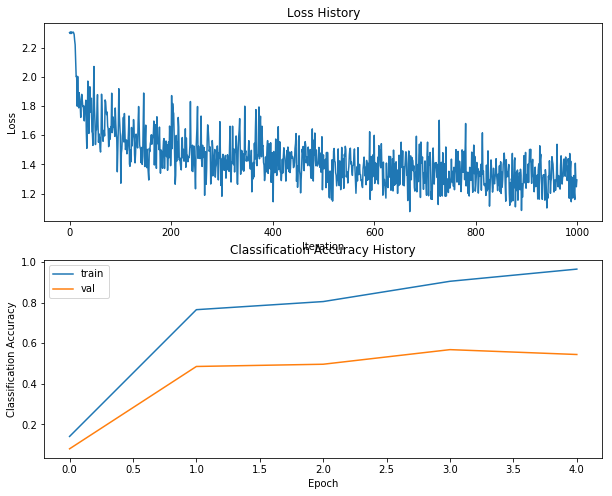



Training process took 8.777557s.
hs 1000 lr 2.000000e+00 reg 1.000000e-03


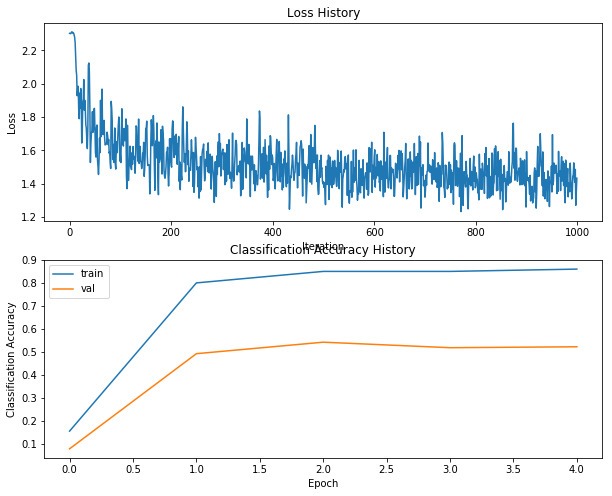



Training process took 9.670957s.
hs 1000 lr 2.000000e+00 reg 5.000000e-03


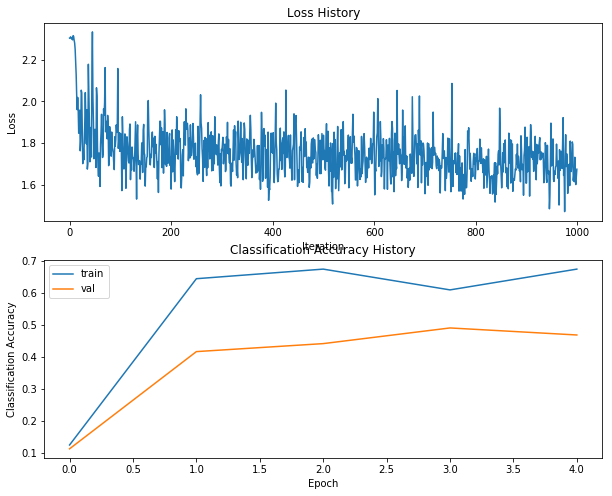



Training process took 9.212926s.
hs 1000 lr 2.000000e+00 reg 1.000000e-02


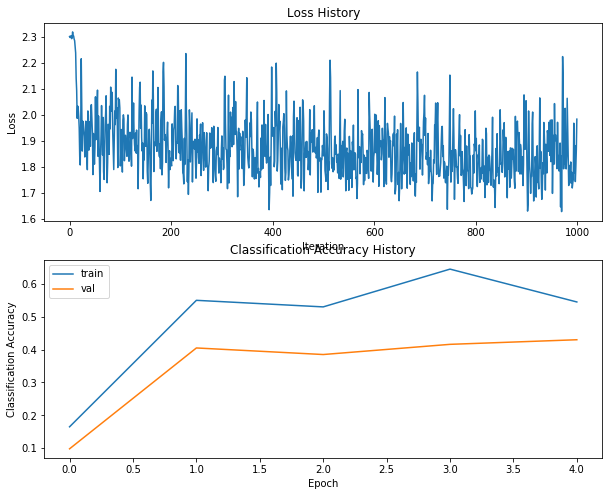



Training process took 8.599441s.
hs 1000 lr 2.000000e+00 reg 1.000000e-01


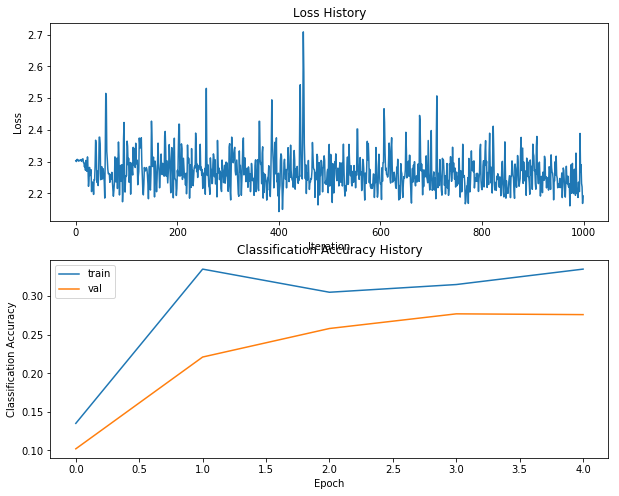



Training process took 9.097386s.
hs 1000 lr 2.000000e+00 reg 1.000000e+00


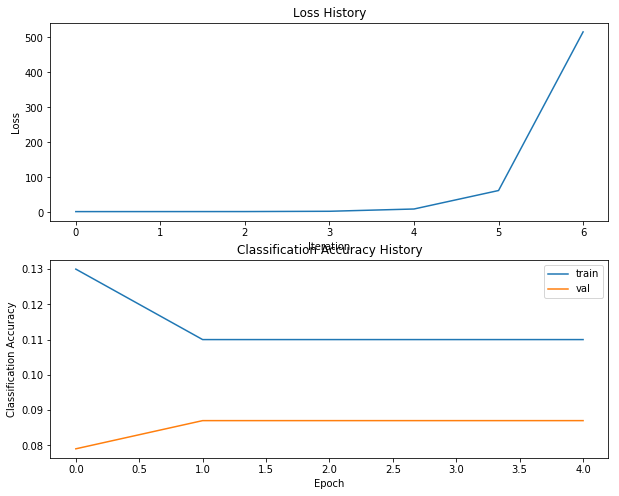



Training process took 8.354886s.
hs 1000 lr 2.500000e+00 reg 1.000000e-05


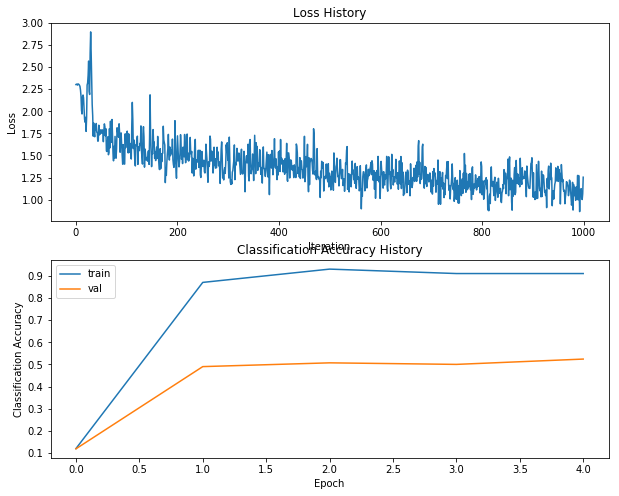



Training process took 9.753119s.
hs 1000 lr 2.500000e+00 reg 1.000000e-04


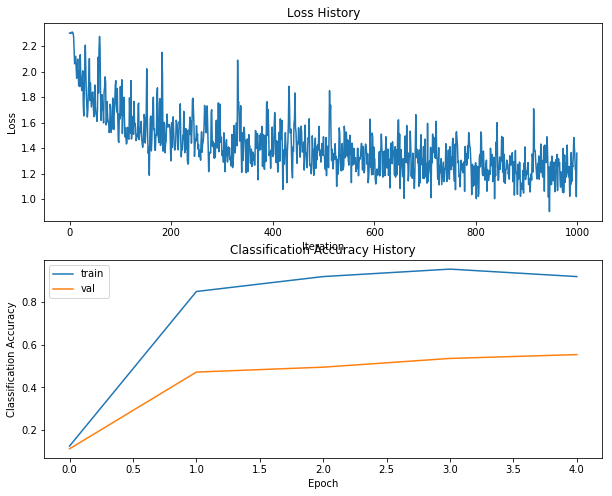



Training process took 9.023545s.
hs 1000 lr 2.500000e+00 reg 5.000000e-04


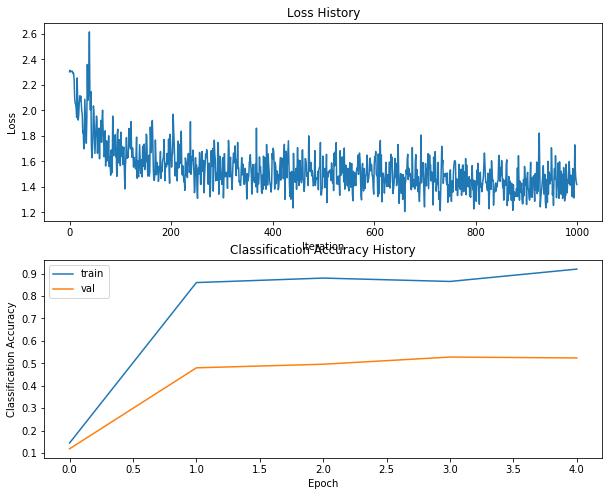



Training process took 8.833711s.
hs 1000 lr 2.500000e+00 reg 1.000000e-03


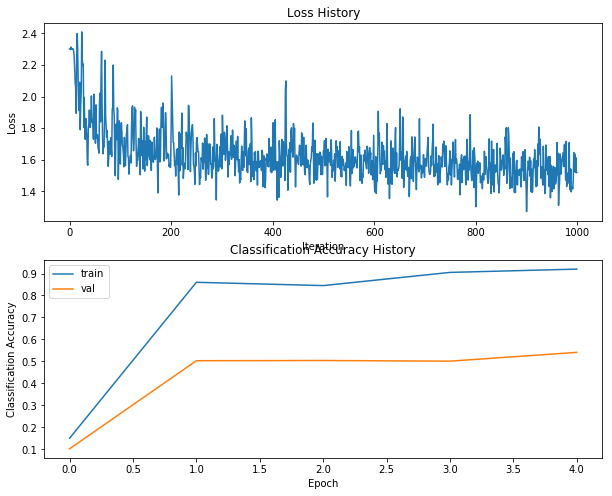



Training process took 8.895123s.
hs 1000 lr 2.500000e+00 reg 5.000000e-03


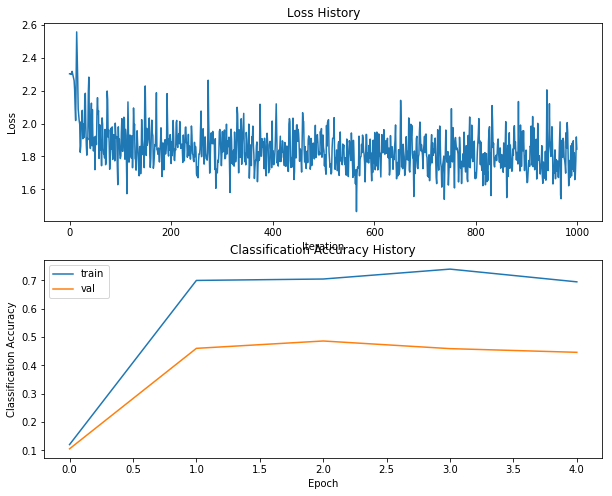



Training process took 9.206884s.
hs 1000 lr 2.500000e+00 reg 1.000000e-02


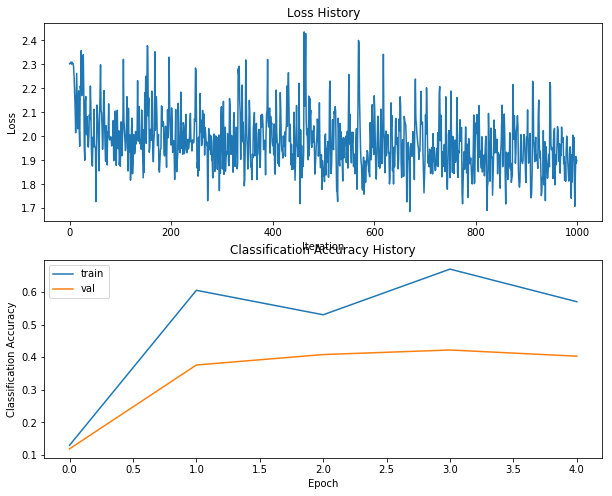



Training process took 8.927984s.
hs 1000 lr 2.500000e+00 reg 1.000000e-01


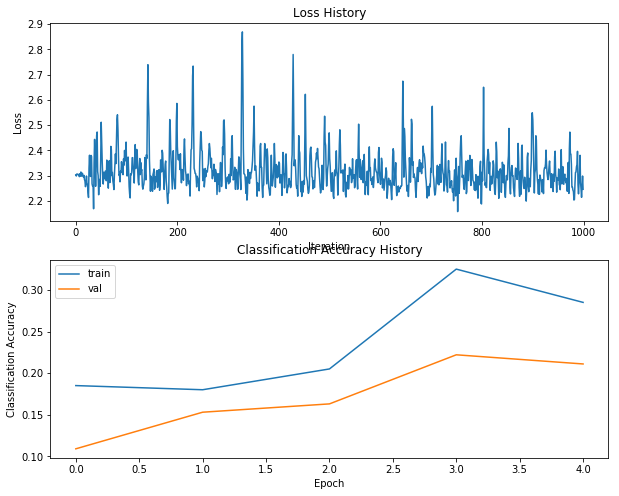



Training process took 9.323242s.
hs 1000 lr 2.500000e+00 reg 1.000000e+00


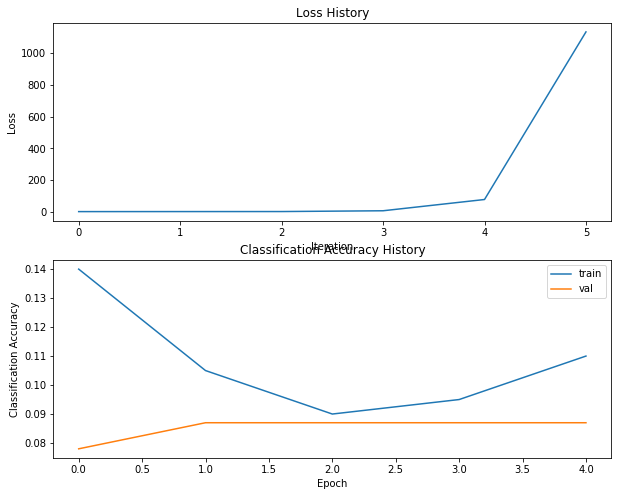



hs 500 lr 1.000000e-01 reg 1.000000e-05 train accuracy 0.523306 val accuracy 0.509000
hs 500 lr 1.000000e-01 reg 1.000000e-04 train accuracy 0.521735 val accuracy 0.512000
hs 500 lr 1.000000e-01 reg 5.000000e-04 train accuracy 0.523204 val accuracy 0.520000
hs 500 lr 1.000000e-01 reg 1.000000e-03 train accuracy 0.522000 val accuracy 0.509000
hs 500 lr 1.000000e-01 reg 5.000000e-03 train accuracy 0.515367 val accuracy 0.499000
hs 500 lr 1.000000e-01 reg 1.000000e-02 train accuracy 0.503510 val accuracy 0.496000
hs 500 lr 1.000000e-01 reg 1.000000e-01 train accuracy 0.289265 val accuracy 0.297000
hs 500 lr 1.000000e-01 reg 1.000000e+00 train accuracy 0.100449 val accuracy 0.078000
hs 500 lr 1.000000e+00 reg 1.000000e-05 train accuracy 0.675429 val accuracy 0.558000
hs 500 lr 1.000000e+00 reg 1.000000e-04 train accuracy 0.668143 val accuracy 0.571000
hs 500 lr 1.000000e+00 reg 5.000000e-04 train accuracy 0.655918 val accuracy 0.573000
hs 500 lr 1.000000e+00 reg 1.000000e-03 train accura

In [37]:
from cs231n.classifiers.neural_net import TwoLayerNet

input_dim = X_train_feats.shape[1]
#hidden_dim = 500
num_classes = 10

hidden_sizes = [500, 600, 700, 800, 900, 1000]
learning_rates = [1e-1, 1, 1.25, 1.5, 1.75, 2, 2.5]
regularization_strengths = [1e-5, 1e-4, 5e-4, 1e-3, 5e-3, 1e-2, 1e-1, 1]

#net = TwoLayerNet(input_dim, hidden_dim, num_classes)
results = {}
best_net = None
best_val = -1

################################################################################
# TODO: Train a two-layer neural network on image features. You may want to    #
# cross-validate various parameters as in previous sections. Store your best   #
# model in the best_net variable.                                              #
################################################################################
for i in range(len(hidden_sizes)):
    for j in range(len(learning_rates)):
        for k in range(len(regularization_strengths)):
            net = TwoLayerNet(input_dim, hidden_sizes[i], num_classes)
            tic = time.time()
            stats = net.train(X_train_feats, y_train, X_val_feats, y_val, 
                              learning_rate=learning_rates[j], 
                              reg=regularization_strengths[k], 
                              num_iters=1000)
            toc = time.time()
            training_accu = np.mean(net.predict(X_train_feats) == y_train)
            validation_accu = np.mean(net.predict(X_val_feats) == y_val)
            
            results[(hidden_sizes[i], 
                     learning_rates[j], 
                     regularization_strengths[k])] = (training_accu, 
                                                      validation_accu)
            
            if best_val < validation_accu:
                best_val = validation_accu
                best_net = net
            
            print('Training process took %fs.' % (toc - tic))
            print("hs %d lr %e reg %e" % (hidden_sizes[i], learning_rates[j], 
                                          regularization_strengths[k]))
            
            plt.subplot(2, 1, 1)
            plt.plot(stats['loss_history'])
            plt.title('Loss History')
            plt.xlabel('Iteration')
            plt.ylabel('Loss')
            
            plt.subplot(2, 1, 2)
            plt.plot(stats['train_acc_history'], label='train')
            plt.plot(stats['val_acc_history'], label='val')
            plt.title('Classification Accuracy History')
            plt.xlabel('Epoch')
            plt.ylabel('Classification Accuracy')
            plt.legend()
            plt.show()
            
            print()
            print()
            
for hs, lr, reg in sorted(results):
    training_accuracy, validation_accuracy = results[(hs, lr, reg)]
    print('hs %d lr %e reg %e train accuracy %f val accuracy %f' % (
          hs, lr, reg, training_accuracy, validation_accuracy))

print('Best validation accuracy achieved during cross-validation: %f' % best_val)
################################################################################
#                              END OF YOUR CODE                                #
################################################################################

In [38]:
# Run your best neural net classifier on the test set. You should be able
# to get more than 55% accuracy.

test_acc = (best_net.predict(X_test_feats) == y_test).mean()
print(test_acc)

0.563
